<a href="https://colab.research.google.com/github/seongheechoi/education/blob/main/3_DQN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!apt-get update -y
!apt-get install -y swig libgl1-mesa-glx

# pip 최신화(선택)
!pip install --upgrade pip

# 핵심 파이썬 패키지 호환 버전 설치
!pip install numpy==1.23.5
!pip install gym==0.25.2
!pip install gym[classic_control]
!pip install matplotlib
!pip install opencv-python==4.9.0.80
!pip install box2d-py

Hit:1 https://cloud.r-project.org/bin/linux/ubuntu jammy-cran40/ InRelease
Hit:2 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:3 http://security.ubuntu.com/ubuntu jammy-security InRelease
Hit:4 http://archive.ubuntu.com/ubuntu jammy InRelease
Hit:5 http://archive.ubuntu.com/ubuntu jammy-updates InRelease
Hit:6 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Hit:7 https://ppa.launchpadcontent.net/deadsnakes/ppa/ubuntu jammy InRelease
Hit:8 https://r2u.stat.illinois.edu/ubuntu jammy InRelease
Hit:9 https://ppa.launchpadcontent.net/graphics-drivers/ppa/ubuntu jammy InRelease
Hit:10 https://ppa.launchpadcontent.net/ubuntugis/ppa/ubuntu jammy InRelease
Reading package lists... Done
W: Skipping acquire of configured file 'main/source/Sources' as repository 'https://r2u.stat.illinois.edu/ubuntu jammy InRelease' does not seem to provide it (sources.list entry misspelt?)
Reading package lists... Done
Building dependency tree... Done
Reading

# 0. Tabular 방식 Q-learning

### 0-1. Cartpole 환경

<img src='https://drive.google.com/uc?export=download&id=19iA756MhMp_swBXPZpSJDhRbar6OKueT' width="" height ="" /><br>

<img src='https://drive.google.com/uc?export=download&id=1flSq2C_ioZmPwTDG5inq1COyuKpCvwr1' width="" height ="" /><br>

상태(continuous):\
1 수레의 현재 위치(-4.8, 4.8)\
2 수레의 현재 속도(-inf, inf)\
3 막대기가 수직으로부터 멀어진 각도(-24°, 24°)\
3 막대기의 각속도(-inf, inf)

\
행동(discrete):\
0: 왼쪽으로 이동\
1: 오른쪽으로 이동

\
보상:
매 time step마다 "+1"을 부여

\
종료 조건:
수레가 중앙에서 일정 범위 이상 멀어지거나(-2.4, 2.4),
막대기가 일정 각도(-12°, 12°)이상 떨어질 경우

\
따라서 막대기가 떨어지지 않도록 수레를 적절하게 유지시켜 오래 버티는것이 목표


In [ ]:
import gym
# 강화학습 분야에서 환경으로 자주 사용하는 라이브러리, 다양한 환경 제공
import matplotlib.pyplot as plt
# 이미지 및 그래프 출력을 위한 라이브러리
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
# 지저분한 deprecation warning 문구 제거

In [ ]:
env = gym.make("CartPole-v1", render_mode="rgb_array")
# "CartPole-v1" 환경 생성

In [ ]:
state = env.reset()
# 환경 초기화
print(state)
# 초기 상태 출력

[-1.5821077e-05  4.2536844e-02 -4.3013897e-02  3.2267328e-02]


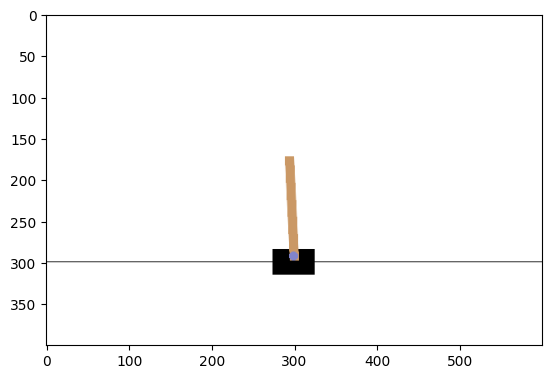

In [ ]:
image = env.render()
plt.imshow(image[0])
# 현재 상태를 이미지로 출력

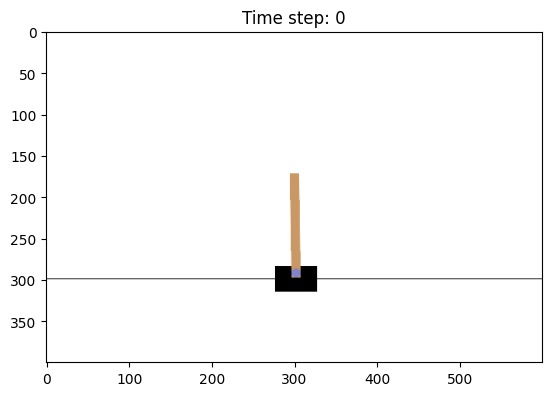

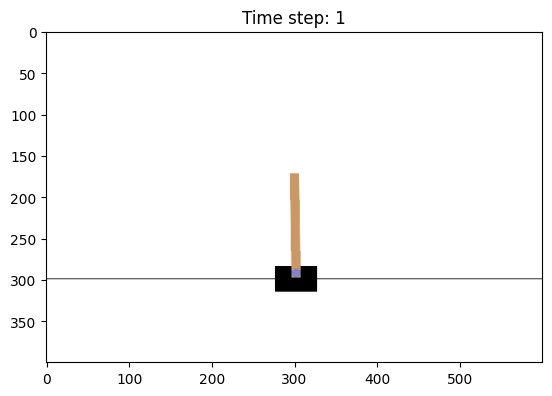

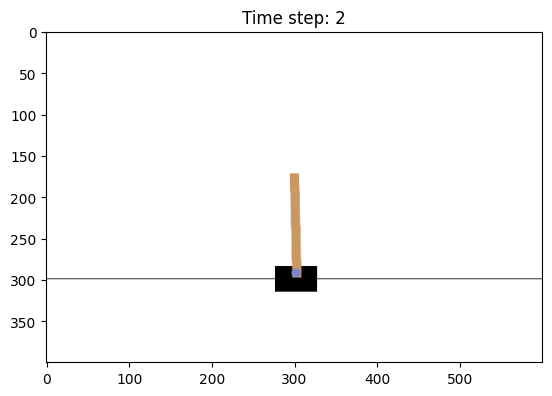

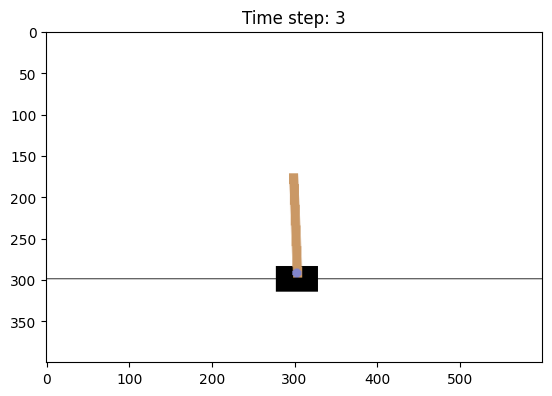

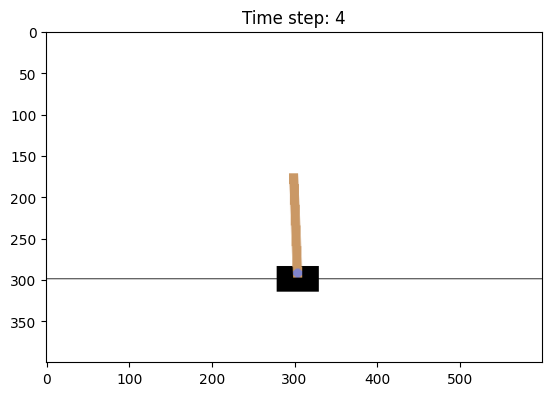

...

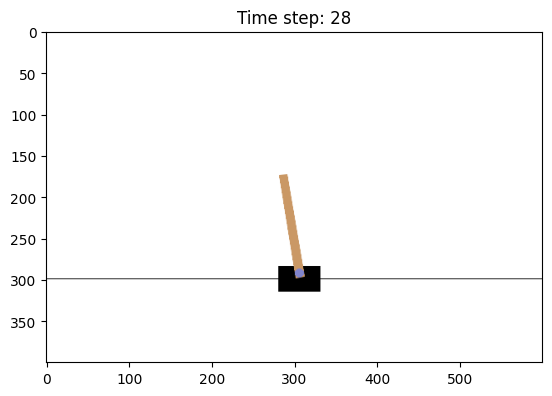

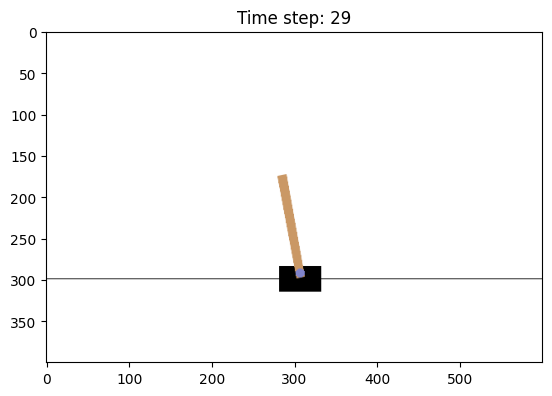

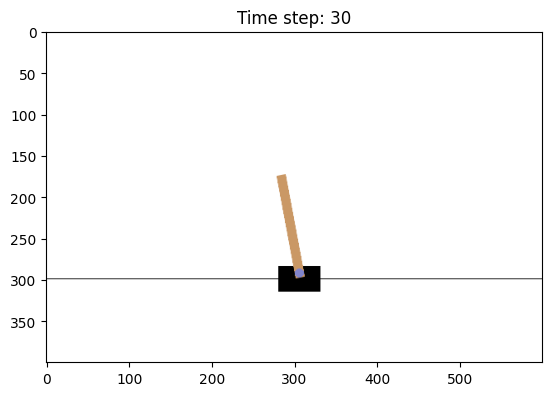

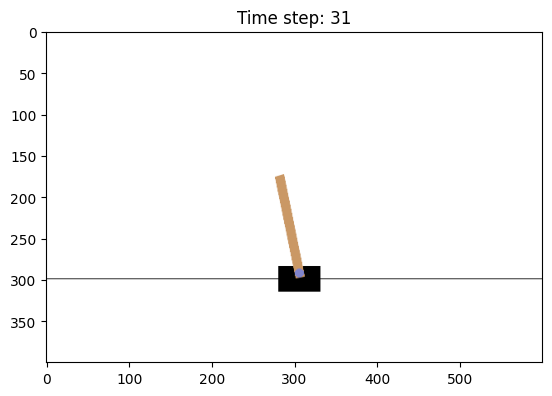

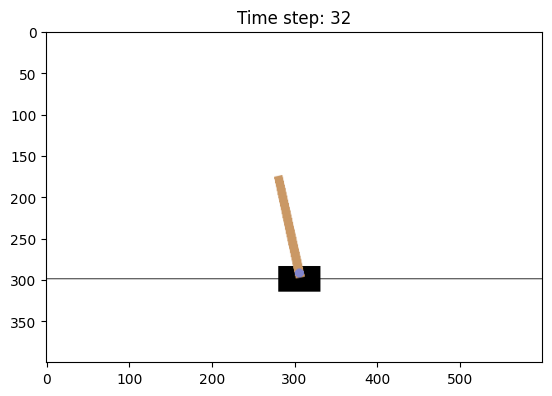

In [ ]:
# 최대 50 step 동안 랜덤 행동에 대한 상태 이미지 확인

state = env.reset()
# 환경 초기화 및 초기 상태 획득
plt.imshow(env.render()[0])
plt.title('Time step: 0')
plt.show()
# 현재 상태 이미지 출력
for t in range(1, 51):
    action = env.action_space.sample()
    # 랜덤 행동 선택
    nextState, reward, done, _info = env.step(action)
    # 환경과 상호작용
    plt.imshow(env.render()[0])
    plt.title(f'Time step: {t}')
    plt.show()
    if done:
        break

### 0-2. ɛ-greedy Q-learning 알고리즘

Outline:\
0-2-1. 필요 라이브러리 import\
0-2-2. hyperparameter 정의\
0-2-3. 환경 정의\
0-2-4. Q-table 정의\
0-2-5. 학습 시 사용하는 변수 정의\
0-2-6. 행동 선택\
0-2-7. Q-table 업데이트\
0-2-8. 학습

#### 0-2-1. 필요 라이브러리 import

In [ ]:
# 필요 라이브러리 로드

# import time
# import math
# # 수학 관련 기능을 지원하는 표준 라이브러리
import numpy as np
# numpy 라이브러리를 np라는 이름으로 로드
# - 다양한 수학적 계산 지원
import gym
# 강화학습 분야에서 환경으로 자주 사용하는 라이브러리, 다양한 환경 제공
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
# 지저분한 deprecation warning 문구 제거

#### 0-2-2. hyperparameter 정의

In [ ]:
config = dict(
    env_name        = "CartPole-v1", # 환경
    lr              = 0.1, # 학습률
    gamma           = 0.95, # discount, 할인율
    n_step          = 100000, # 학습 step(time step 단위)
    epsilon_init    = 1.0, # 초기 epsilon(=초기 탐험 비율)
    epsilon_min     = 0.05, # 최소 탐험 비율
    epsilon_decay   = 0.999995, # epsilon 감소 비율(매 time step 마다 epsilon에 곱해짐)
    obs             = [30, 30, 50, 50], # Q-table을 위한 상태 공간
    obs_window      = [0.25, 0.25, 0.01, 0.1], # 상태공간에서 discretize 시 분할 간격
    test_freq       = 10, # test 주기(time step 단위)
)

#### 0-2-3. 환경 정의

In [ ]:
# 환경 및 테스트 환경 정의

env      = gym.make(config["env_name"])
test_env = gym.make(config["env_name"])
dState = env.observation_space.shape[0]
dAction = env.action_space.n
print("상태공간 크기(continuous):", dState)
print("행동 개수(discrete):", dAction)

상태공간 크기(continuous): 4
행동 개수(discrete): 2


상태공간이 continuous이므로 tabular 방식의 Q-table을 직접 적용할 수 없음

본 챕터에서는 상태공간을 일정한 범위만큼 묶어서 활용(discretize)

In [ ]:
state = env.reset()
print("상태 변환 전 상태예시:", state)

state = state/np.array(config["obs_window"]) + np.array([15, 10, 1, 10])
state = tuple(state.astype(np.int))

print("상태 변환 후 상태예시:", state)

상태 변환 전 상태예시: [ 0.01476625  0.01779045 -0.03759475 -0.01112118]
상태 변환 후 상태예시: (15, 10, -2, 9)


In [ ]:
# 함수 정의

def toState(obs):
    state = obs/np.array(config["obs_window"]) + np.array([15, 10, 1, 10])
    return tuple(state.astype(np.int))

#### 0-2-4. Q-table 정의

In [ ]:
q_table = np.random.uniform(low=0, high=1, size=(config["obs"] + [dAction]))
print("Q-table 형태:", q_table.shape)
#state의 크기에 2개의 action 크기 만큼 Q-table 생성

Q-table 형태: (30, 30, 50, 50, 2)


#### 0-2-5. 학습 시 사용하는 변수 정의

In [ ]:
epsilon = config["epsilon_init"]
# epsilon-greedy 정책의 epsilon 비율 정의
## 매 time step마다 행동을 선택할때, epsilon의 확률로 랜덤한 행동을 선택하여 탐험(exploration)을 수행함
## 일반적으로 epsilon은 초기에 높게 설정하고, 이후 학습하며 감소시킴
## 여기서는 매 episode마다 현재 epsilon에 epsilon_decay를 곱한 값으로 업데이트를 함

#### 0-2-6. 행동 선택

In [ ]:
# exploration의 경우

action = np.random.randint(0, dAction)
# 랜덤 행동 선택
print("행동:", action)

행동: 0


In [ ]:
# exploitation의 경우

q = q_table[state]
# 현재 상태에서 모든 행동에 대한 Q를 계산
print("모든 행동에 대한 Q:", q)

action = q.argmax()
# 가장 Q가 높은 행동을 선택
print("가장 Q가 큰 행동:", action)

모든 행동에 대한 Q: [0.65021829 0.78968916]
가장 Q가 큰 행동: 1


#### 0-2-7. Q-table 업데이트

<img src='https://drive.google.com/uc?export=download&id=1Vw4twP5gRIOqmWQjIADJpbGbco6pOjsS' width="" height ="" /><br>

In [ ]:
# Q 게산

Q = q_table[state + (action,)]
# 현재 상태, 행동에 대한 Q 획득
print("Q(s_t, a_t):", Q)

Q(s_t, a_t): 0.7896891591616197


In [ ]:
# TD target Q 계산

nextObs, reward, done, _info = env.step(action)
nextState = toState(nextObs)
# 다음 상태(s_t+1) 획득
print("다음 상태(s_t+1):", nextState)
print("")

nextTargetQ = np.max(q_table[nextState])
# 다음 상태에서 가장 큰 Q 선택
# max_a' Q(s_t+1, a')
print("Q(s_t+1, -):", q_table[nextState])
print("max_a' Q(s_t+1, a'):", np.max(q_table[nextState]))
print("")

targetQ = reward + (1 - done) * config["gamma"] * nextTargetQ
# target Q 계산
# r + gamma * max_a' Q(s_t+1, a')
print("target Q:", targetQ)

다음 상태(s_t+1): (15, 10, -2, 6)

Q(s_t+1, -): [0.68788865 0.37950853]
max_a' Q(s_t+1, a'): 0.687888647367616

target Q: 1.653494214999235


In [ ]:
# Q와 target Q를 통해 Q-table 업데이트
print("기존 Q:", q_table[state + (action,)])

newQ = Q + config["lr"]*(targetQ - Q)
q_table[state + (action,)] = newQ
# Q <- Q + alpha*[targetQ - Q]

print("업데이트된 Q:", q_table[state + (action,)])

기존 Q: 0.7896891591616197
업데이트된 Q: 0.8760696647453813


#### 0-2-8. 학습

In [ ]:
obs = env.reset()
state = toState(obs)
test_scores = []

for t in range(1, config["n_step"]+1):
    if np.random.random() < epsilon: # exploration
        action = np.random.randint(0, dAction)
        # 랜덤 행동 선택
    else:
        action = np.argmax(q_table[state])
    nextObs, reward, done, _info = env.step(action)
    nextState = toState(nextObs)
    # 행동 수행

    if not done:
        # --- Q 게산 ---
        Q = q_table[state + (action,)]

        # --- target Q 계산 ---
        nextTargetQ = np.max(q_table[nextState])
        # max_a' Q(s_t+1, a')
        targetQ = reward + config["gamma"] * nextTargetQ
        # targetQ = reward + (1 - done) * config["gamma"] * nextTargetQ
        # r + gamma * max_a' Q(s_t+1, a')

        # --- Q-table 업데이트 ---
        newQ = Q + config["lr"]*(targetQ - Q)
        q_table[state + (action,)] = newQ
        # Q <- Q + alpha*[targetQ - Q]

    state = nextState
    if done:
        obs = env.reset()
        state = toState(obs)

    # --- epsilon 업데이트 ---
    epsilon = max(config["epsilon_min"], epsilon*config["epsilon_decay"])

    # --- test score 계산 ---
    if t % config["test_freq"] == 0:
        test_score = 0.0
        test_obs = test_env.reset()
        test_state = toState(test_obs)
        while True:
            if np.random.rand() < config["epsilon_min"]:
                test_action = np.random.randint(0, dAction)
            else:
                test_action = np.argmax(q_table[test_state])
            test_nextObs, test_reward, test_done, _test_info = test_env.step(test_action)
            test_nextState = toState(test_nextObs)
            test_score += reward
            test_state = test_nextState
            if test_done:
                break
        test_scores.append(test_score)
        print(f'[time:{t}]test score: {test_score}, epsilon: {epsilon:.3f}')
        # 정해진 주기마다 현재 모델로 환경과 한 episode 상호작용후 score 계산

스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
[time:50010]test score: 43.0, epsilon: 0.779
[time:50020]test score: 32.0, epsilon: 0.779
[time:50030]test score: 33.0, epsilon: 0.779
[time:50040]test score: 175.0, epsilon: 0.779
[time:50050]test score: 30.0, epsilon: 0.779
[time:50060]test score: 38.0, epsilon: 0.779
[time:50070]test score: 13.0, epsilon: 0.779
[time:50080]test score: 63.0, epsilon: 0.778
[time:50090]test score: 23.0, epsilon: 0.778
[time:50100]test score: 125.0, epsilon: 0.778
[time:50110]test score: 96.0, epsilon: 0.778
[time:50120]test score: 47.0, epsilon: 0.778
[time:50130]test score: 47.0, epsilon: 0.778
[time:50140]test score: 12.0, epsilon: 0.778
[time:50150]test score: 43.0, epsilon: 0.778
[time:50160]test score: 27.0, epsilon: 0.778
[time:50170]test score: 69.0, epsilon: 0.778
[time:50180]test score: 93.0, epsilon: 0.778
[time:50190]test score: 82.0, epsilon: 0.778
[time:50200]test score: 124.0, epsilon: 0.778
[time:50210]test score: 137.0, epsilon: 0.778
[time:50220]tes

### 0-3 성능 그래프 출력

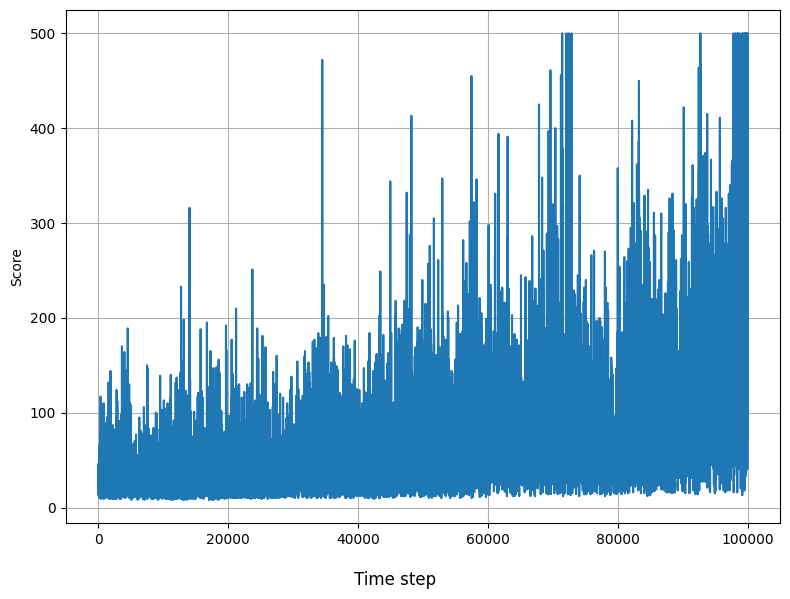

In [ ]:
import matplotlib.pyplot as plt

# 학습시 얻어진 test score를 그래프로 출력
y1 = np.array(test_scores)
x1 = np.arange(len(y1))*config["test_freq"]

fig, ax = plt.subplots(1, 1, figsize=(8, 6))
fig.supxlabel("Time step")

ax.plot(x1, y1)
ax.set_ylabel("Score")
ax.grid()

plt.tight_layout()

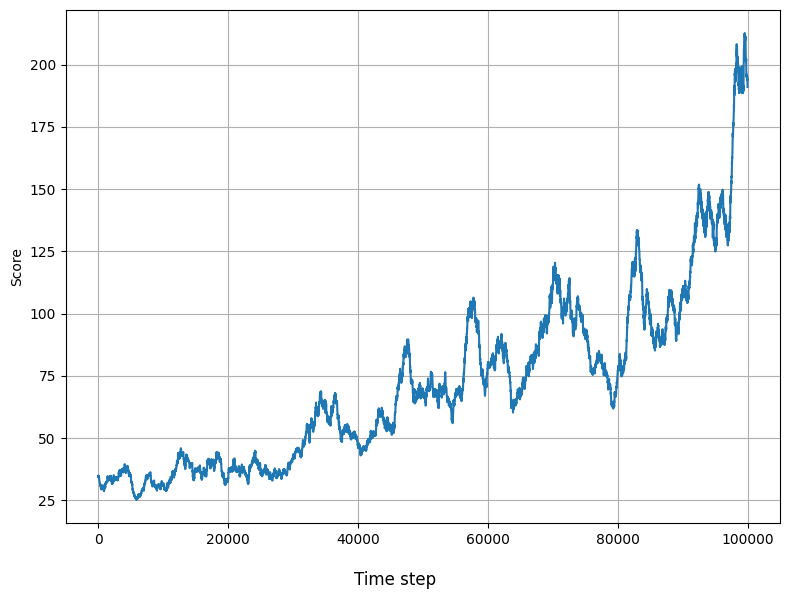

In [ ]:
# 그래프를 보기 좋게 이동평균 적용하여 출력
window = 100

y1 = np.convolve(np.pad(np.array(test_scores), (window//2, window//2), mode="edge"), np.ones(window)/window, mode="valid")
x1 = np.arange(len(y1))*config["test_freq"]

fig, ax = plt.subplots(1, 1, figsize=(8, 6))
fig.supxlabel("Time step")

ax.plot(x1, y1)
ax.set_ylabel("Score")
ax.grid()

plt.tight_layout()

### 0-4 학습된 모델의 동작 확인

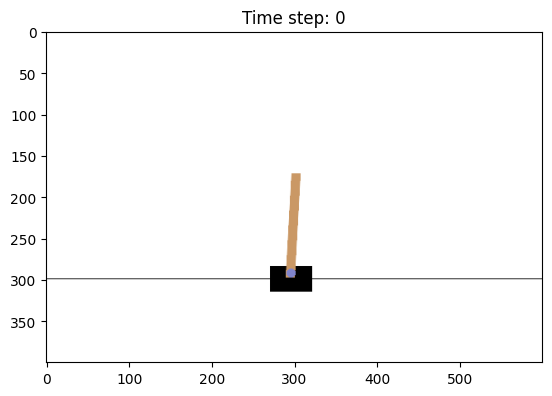

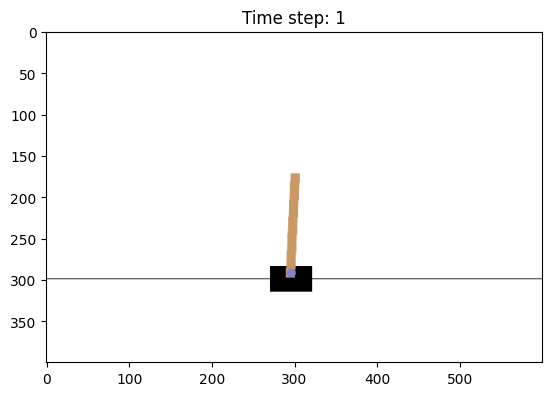

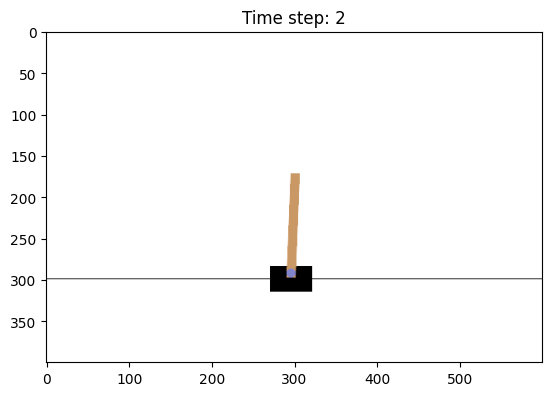

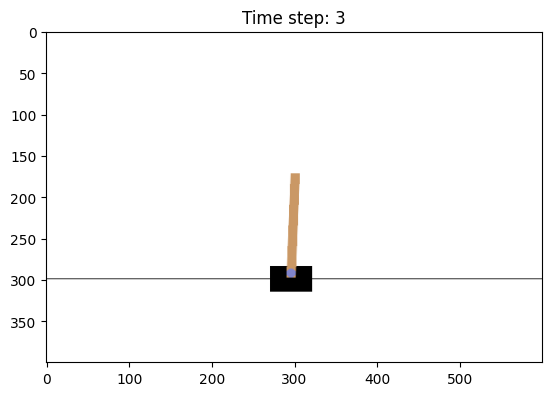

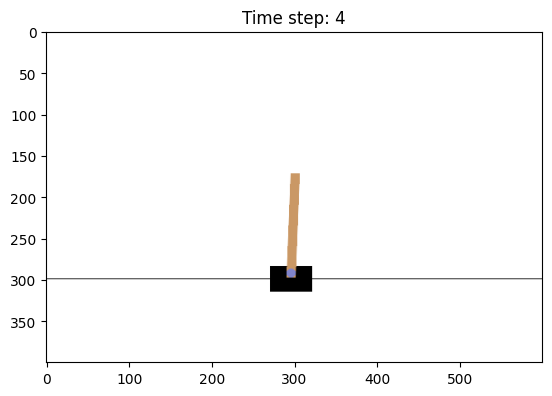

...

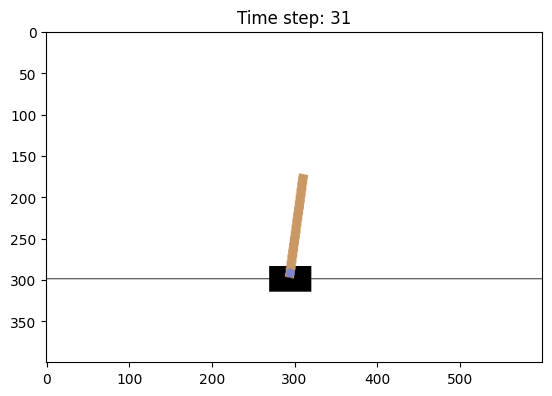

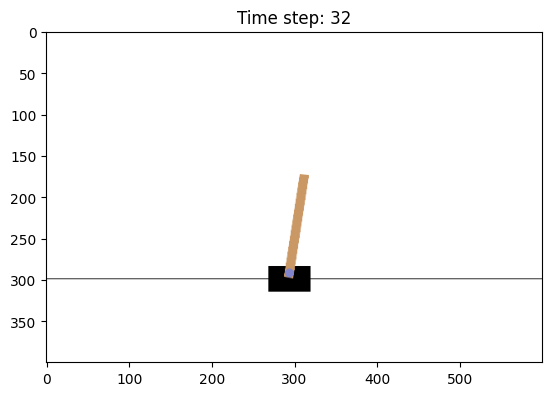

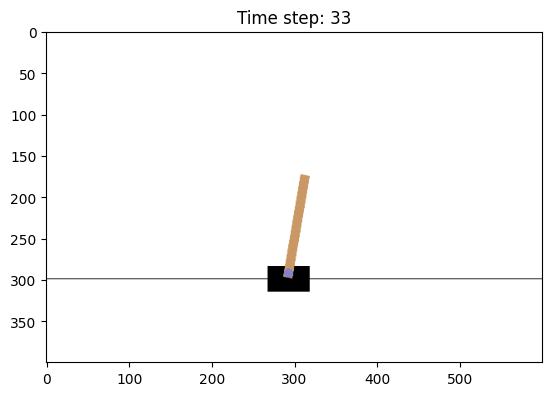

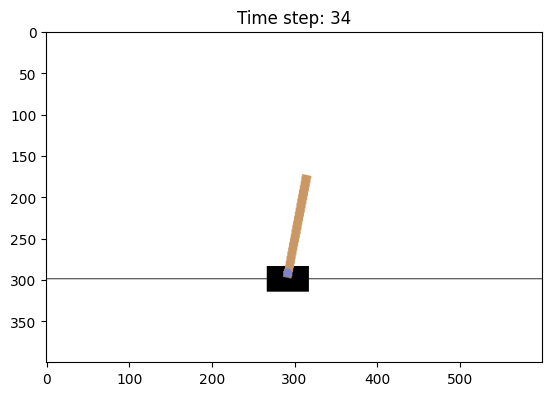

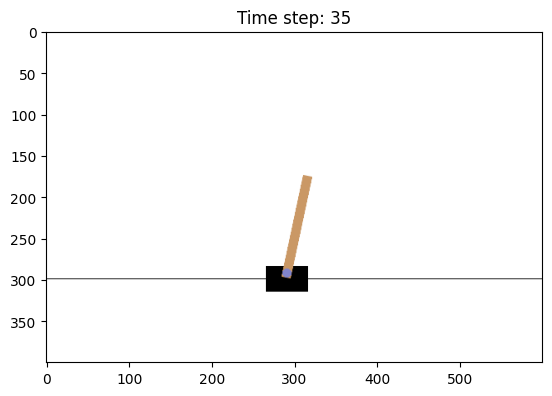

In [ ]:
# 학습 전(= train step 0) 모델의 성능
env = gym.make(config["env_name"], render_mode="rgb_array")
obs = env.reset()
state = toState(obs)
plt.imshow(env.render()[0])
plt.title("Time step: 0")
plt.show()
for t in range(1, 201):
    action = np.argmax(q_table[state])
    nextObs, reward, done, _info = env.step(action)
    nextState = toState(nextObs)
    plt.imshow(env.render()[0])
    plt.title(f'Time step: {t}')
    plt.show()
    state = nextState
    if done:
        break


# 1. Function approximation 방식 DQN

### 1-1. Acrobot 환경

<img src='https://drive.google.com/uc?export=download&id=15RLdP5hlbS83ldbLa4Y8Eg9ouEdyT5qz' width="" height ="" /><br>

In [ ]:
import gym
# 강화학습 분야에서 환경으로 자주 사용하는 라이브러리, 다양한 환경 제공
import matplotlib.pyplot as plt
# 이미지 및 그래프 출력을 위한 라이브러리
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
# 지저분한 deprecation warning 문구 제거

In [ ]:
env = gym.make("Acrobot-v1", render_mode="rgb_array")
# "Acrobot-v1" 환경 생성

## Acrobot-v1 환경은 조작가능한 상부 관절과 조작 불가능한 하부 관절로 구성됨
## 매 time step마다 "-1" 보상을 받으며, 특정 높이 도달 시 "0"의 보상을 받고 환경이 종료됨
## 상부 관절을 조작하여 최대한 빠르게 특정 높이에 도달하는 것이 목표
## 중력의 영향을 받으므로 한번에 올라갈 수 없으며, 좌/우를 반복 왕복하여 관성으로 올라가야함

<img src='https://drive.google.com/uc?export=download&id=1ssGrBfQUbp5dL8Cwi7vH230Ef13HDNYY' width="" height ="" /><br>

In [ ]:
print("상태공간:", env.observation_space)
# 상태공간 출력

# 상태공간은 총 6차원의 continuous 공간으로 구성
# 상태 각각의 요소가 의미하는 바는 아래 이미지와 같음

상태공간: Box([ -1.        -1.        -1.        -1.       -12.566371 -28.274334], [ 1.        1.        1.        1.       12.566371 28.274334], (6,), float32)


<img src='https://drive.google.com/uc?export=download&id=1eKZ1aB2huw_PGrzhZJ6BuzIvOcXYCAPI' width="" height ="" /><br>

In [ ]:
print("행동공간:", env.action_space)
# 행동공간 출력

# 행동공간은 3개의 discrete 행동으로 구성
# 행동 각각이 의미하는 바는 아래 이미지와 같음

행동공간: Discrete(3)


<img src='https://drive.google.com/uc?export=download&id=1frEzxN0cXgWhSltEsukNgeJvnFRxr9Lv' width="" height ="" /><br>

In [ ]:
state = env.reset()
# 환경 초기화
print(state)
# 초기 상태 출력

[ 0.9998628  -0.01656433  0.996119    0.08801616 -0.08081672 -0.06826896]


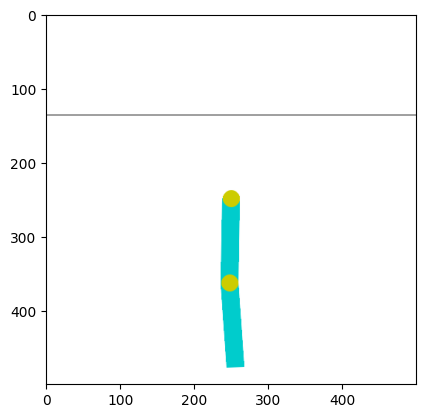

In [ ]:
image = env.render()
plt.imshow(image[0])
# 현재 상태를 이미지로 출력

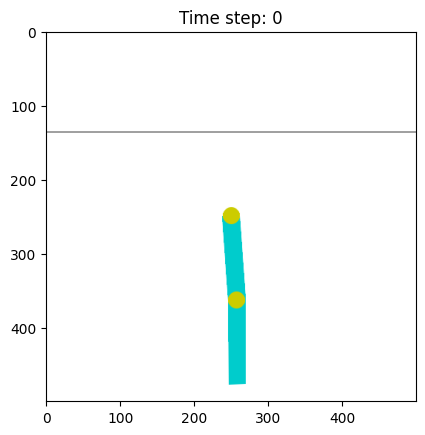

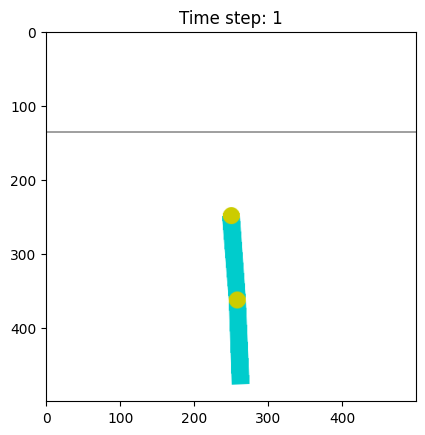

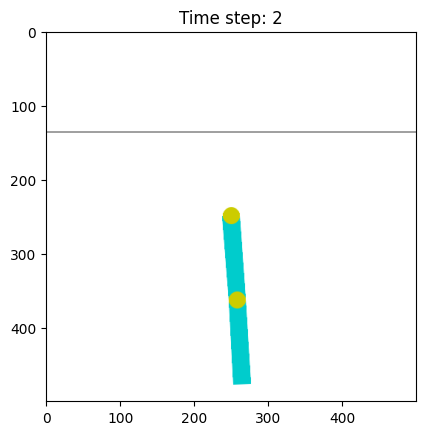

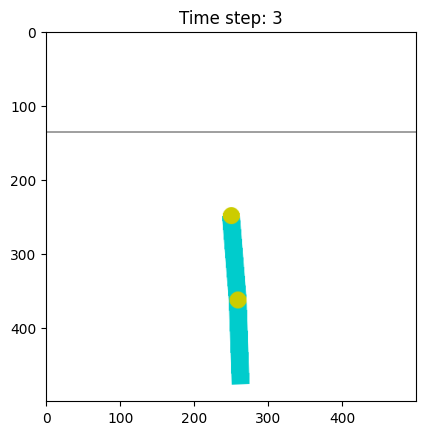

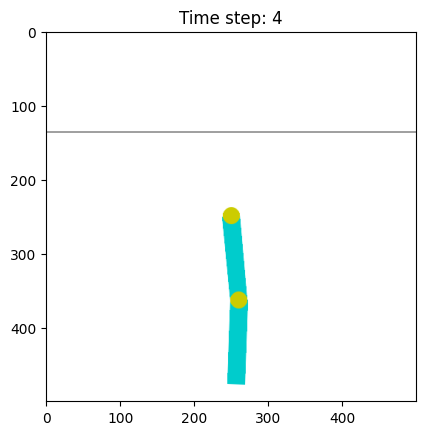

...

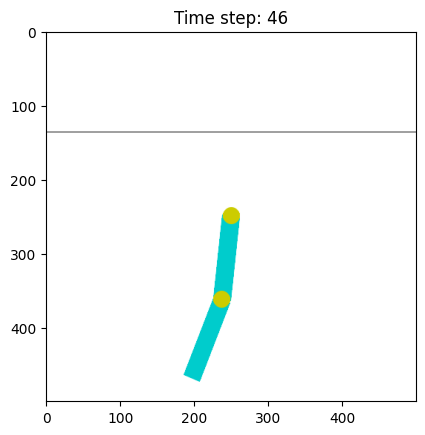

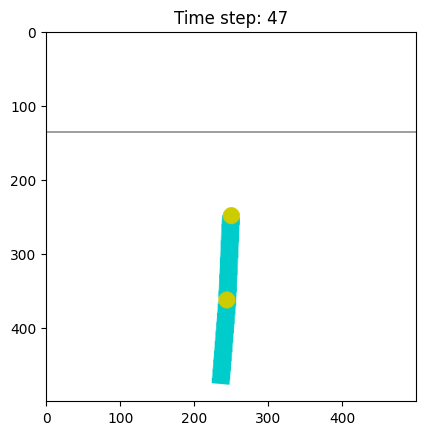

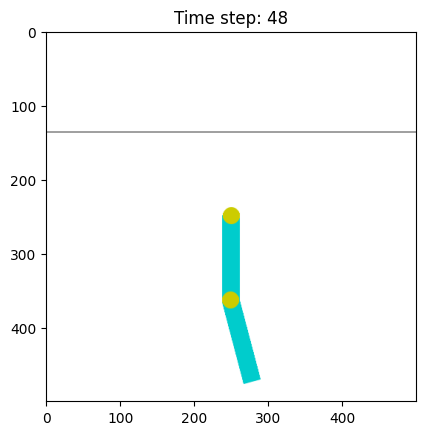

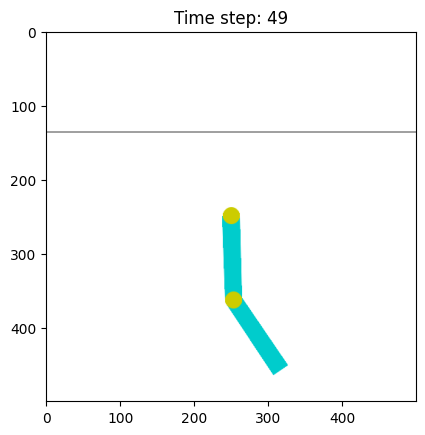

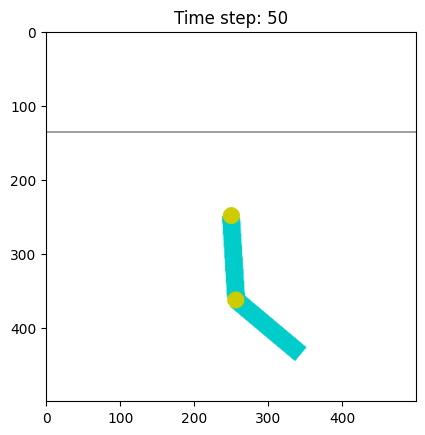

In [ ]:
# 50 step 동안 랜덤 행동에 대한 상태 이미지 확인

state = env.reset()
# 환경 초기화 및 초기 상태 획득
plt.imshow(env.render()[0])
plt.title('Time step: 0')
plt.show()
# 현재 상태 이미지 출력
for t in range(1, 51):
    action = env.action_space.sample()
    # 랜덤 행동 선택
    nextState, reward, done, _info = env.step(action)
    # 환경과 상호작용
    plt.imshow(env.render()[0])
    plt.title(f'Time step: {t}')
    plt.show()

현재 상태: [ 0.99763244  0.06877185  0.9979856  -0.0634404   0.07770939  0.09712069]
랜덤 행동: 0
다음 상태: [0.9951058  0.09881516 0.59520835 0.8035714  0.25180164 0.12276386]
보상: -1.0
환경 종료 여부: False
그 외 환경 정보: {}


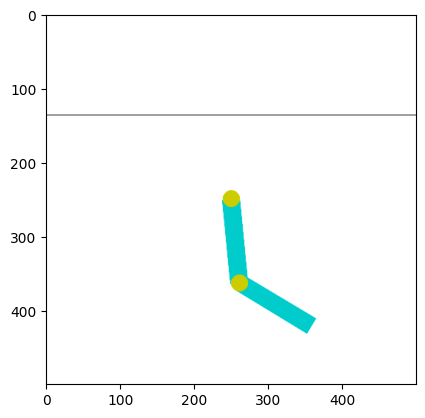

In [ ]:
action = env.action_space.sample()
# 랜덤 action 획득
nextState, reward, done, info = env.step(action)

print("현재 상태:", state)
print("랜덤 행동:", action)
print("다음 상태:", nextState)
print("보상:", reward)
print("환경 종료 여부:", done)
print("그 외 환경 정보:", info)
image = env.render()
plt.imshow(image[0])

### 1-2. DQN algorithm

<img src='https://drive.google.com/uc?export=download&id=13qyZS1e93Tr4katiu8bFJCzMcU6TJtCS' width="600" height ="" /><br>

Q네트워크와 experience replay 등 구성 요소를 정의하고,
정의한 요소를 활용하여 행동 선택과 batch 샘플링을 수행하여 loss를 계산하고 학습하는 과정을 거침

#### 1-2-1. 필요 라이브러리 import

In [ ]:
# 필요 라이브러리 로드

import random
import numpy as np
# numpy 라이브러리를 np라는 이름으로 로드
# - 다양한 수학적 계산 지원
import torch
# torch 라이브러리 로드
# - 딥러닝 모델을 다루기 위한 라이브러리
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
# 일반적으로 사용하는 torch의 세부 라이브러리 로드
from collections import deque
# python에서 기본으로 제공하는 자료구조
import gym
# 강화학습 분야에서 환경으로 자주 사용하는 라이브러리, 다양한 환경 제공
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)
# 지저분한 deprecation warning 문구 제거

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
# GPU 사용 가능하면 CUDA 사용

In [ ]:
print("현재 사용하는 device:", DEVICE)

현재 사용하는 device: cuda


#### 1-2-2. hyperparameter 정의

In [ ]:
# hyperparameter 정의

config = dict(
    env_name            = "Acrobot-v1", # 환경
    batch               = 128,          # 배치 크기
    buffer_size         = 10000,        # 버퍼의 최대 크기(transition 단위)
    lr                  = 0.001,        # 학습률
    gamma               = 0.99,         # discount(할인율)
    epsilon_init        = 0.1,          # 초기 epsilon(=초기 탐험 비율)
    epsilon_min         = 0.001,        # 최소 epsilon(=최종 탐험 비율)
    epsilon_decay       = 0.995,        # epsilon 감소 비율(매 episode마다 epsilon에 곱해짐)
    n_step              = 50000,        # 학습 횟수 (time step 단위)
    n_train_start       = 8000,         # 초기 버퍼 채우기(time step 단위)
    target_update_freq  = 100,          # target Q의 업데이트 주기(time step 단위)
    test_freq           = 100,          # test 주기(time step 단위)
)

#### 1-2-3. 환경 정의

In [ ]:
# 환경 및 테스트 환경 정의

env      = gym.make(config["env_name"])
test_env = gym.make(config["env_name"])
# test_env는 학습 도중 알고리즘의 성능을 확인하기 위한 환경
dState = env.observation_space.shape[0] # 환경의 state_space 크기
dAction = env.action_space.n # 환경의 discrete action 개수
print("상태공간 크기(continuous):", dState)
print("행동 개수(discrete):", dAction)

상태공간 크기(continuous): 6
행동 개수(discrete): 3


#### 1-2-4. Q 네트워크 정의

<img src='https://drive.google.com/uc?export=download&id=13eEIgRyLVaHxl9WPVeg2FcVYHDCPhHvx' width="" height ="" /><br>

In [ ]:
# Q 네트워크 클래스 정의

class Qnet(nn.Module):
    def __init__(self, dState, dAction):
        super().__init__()
        self.layers = nn.Sequential(
            nn.Linear(in_features=dState, out_features=128),    # 입력층
            nn.ReLU(),
            nn.Linear(in_features=128, out_features=128),       # 은닉층
            nn.ReLU(),
            nn.Linear(in_features=128, out_features=dAction),   # 출력층
        )
        # 신경망 모델 정의 총 3개의 레이어로 구성
        # 입력(state 차원) -> 입력층(128) -> 은닉층(128) -> 출력층(action 차원)

    def forward(self, x): # 네트워크 처리 과정 정의
        return self.layers(x) # self.layers 신경망을 통과한 후 출력을 반환

In [ ]:
# Q 및 target Q 네트워크 정의

Q = Qnet(dState=dState, dAction=dAction).to(DEVICE)
# Q 네트워크 선언(online network) 및 device 이동(GPU or CPU)
targetQ = Qnet(dState=dState, dAction=dAction).to(DEVICE) # target Q 정의
# target Q 네트워크 선언(target network) 및 device 이동(GPU or CPU)

In [ ]:
# Q 구성 확인

print(Q)
# 입력층, 은닉층, 출력층 각각 1층으로 구성
# 활성화 함수는 ReLU 설정

Qnet(
  (layers): Sequential(
    (0): Linear(in_features=6, out_features=128, bias=True)
    (1): ReLU()
    (2): Linear(in_features=128, out_features=128, bias=True)
    (3): ReLU()
    (4): Linear(in_features=128, out_features=3, bias=True)
  )
)


In [ ]:
# Q의 매개변수(parameter) 확인

print(Q.layers[0])
# Q의 0번 레이어 확인
print(Q.layers[0].weight)
# Q의 0번 레이어 가중치(weight) 확인
print(Q.layers[0].bias)
# Q의 0번 레이어 편향(bias) 확인

Linear(in_features=6, out_features=128, bias=True)
Parameter containing:
tensor([[-7.9194e-02,  7.1367e-02,  1.5692e-01, -3.6953e-01,  9.4122e-02,
          7.4693e-02],
        [ 3.8987e-01, -1.4740e-01,  7.5382e-02,  3.1578e-01,  1.0584e-02,
          3.3284e-01],
        [ 1.0063e-01,  4.7846e-02, -3.7309e-03,  2.7250e-01,  3.0783e-01,
         -1.2784e-01],
        [ 1.8601e-01,  3.4385e-01,  3.1958e-01,  2.9935e-01, -6.1434e-02,
         -6.2638e-02],
        [ 3.6542e-01, -1.1634e-01, -9.8712e-02, -2.4634e-01, -3.4432e-01,
         -2.0311e-03],
        [ 3.1536e-01, -3.5830e-01, -1.5022e-01, -3.9245e-01, -1.9842e-01,
         -1.9879e-01],
        [ 3.3336e-01,  5.6571e-02, -4.7263e-02,  3.8161e-01,  3.0665e-02,
         -3.3719e-01],
        [ 4.2956e-02,  2.0623e-02, -1.3096e-01,  3.4823e-01,  2.0619e-01,
         -3.5764e-02],
        [-1.7851e-01, -2.8995e-01, -4.0386e-01, -3.9269e-01,  3.5612e-01,
          3.1762e-01],
        [ 2.1682e-01, -2.6259e-01, -2.4498e-02,  5.669

In [ ]:
# targetQ의 매개변수(parameter) 확인

print(targetQ.layers[0])
# Q의 0번 레이어 확인
print(targetQ.layers[0].weight)
# Q의 0번 레이어 가중치(weight) 확인
print(targetQ.layers[0].bias)
# Q의 0번 레이어 편향(bias) 확인

Linear(in_features=6, out_features=128, bias=True)
Parameter containing:
tensor([[ 0.3438,  0.3513, -0.2709,  0.1689, -0.0965,  0.2742],
        [ 0.2799,  0.3306,  0.0800,  0.1572, -0.3467,  0.2744],
        [ 0.3885,  0.0716, -0.2178, -0.0449, -0.3940, -0.2241],
        [-0.0423,  0.1464, -0.2336,  0.2836,  0.2574, -0.0690],
        [ 0.2116, -0.1800, -0.2261,  0.1504, -0.0418,  0.0801],
        [ 0.2680,  0.4075, -0.0898,  0.1773,  0.1902, -0.3240],
        [ 0.2252,  0.3973,  0.0916,  0.2135,  0.3310, -0.3552],
        [ 0.1072, -0.2326,  0.3228, -0.1871,  0.1555,  0.1022],
        [ 0.2956, -0.3903,  0.0446, -0.2970,  0.1741, -0.1128],
        [ 0.3031, -0.2918, -0.0647, -0.1352, -0.0746,  0.1174],
        [ 0.0204, -0.2063,  0.1774, -0.2855,  0.2820, -0.2754],
        [-0.3628, -0.0078, -0.0303,  0.2262, -0.0072,  0.3219],
        [-0.2082,  0.0502,  0.3578,  0.0716, -0.2902,  0.0065],
        [-0.1492,  0.1916, -0.0283, -0.1065, -0.1058,  0.1937],
        [-0.0894,  0.3840,  0.0

In [ ]:
# 초기 Q와 target Q를 동일한 매개변수로 설정
## torch 라이브러리는 네트워크를 랜덤한 매개변수(parameter)로 초기화함
## 그러므로 target Q의 초기 매개변수를 Q의 매개변수로 동기화 해줘야함

print("매개변수 업데이트 전")
print("Q:", Q.layers[0].weight[0])
print("targetQ:", targetQ.layers[0].weight[0])
print()

targetQ.load_state_dict(Q.state_dict())
# 매개변수 업데이트

print("매개변수 업데이트 후")
print("Q:", Q.layers[0].weight[0])
print("targetQ:", targetQ.layers[0].weight[0])

매개변수 업데이트 전
Q: tensor([-0.0792,  0.0714,  0.1569, -0.3695,  0.0941,  0.0747], device='cuda:0',
       grad_fn=<SelectBackward0>)
targetQ: tensor([ 0.3438,  0.3513, -0.2709,  0.1689, -0.0965,  0.2742], device='cuda:0',
       grad_fn=<SelectBackward0>)

매개변수 업데이트 후
Q: tensor([-0.0792,  0.0714,  0.1569, -0.3695,  0.0941,  0.0747], device='cuda:0',
       grad_fn=<SelectBackward0>)
targetQ: tensor([-0.0792,  0.0714,  0.1569, -0.3695,  0.0941,  0.0747], device='cuda:0',
       grad_fn=<SelectBackward0>)


In [ ]:
optimizerQ = optim.Adam(Q.parameters(), lr=config["lr"])
# 경사 하강법 학습을 위한 optimizer 정의
# 여기서는 SGD 대신 최근 딥러닝 분야에서 널리 사용중인 Adam 방법 사용

In [ ]:
# optimizer에 등록되는 Q의 매개변수
list(Q.parameters())
## Q네트워크 3개 Linear 층의 가중치와 편향이 담겨있음

[Parameter containing:
 tensor([[-7.9194e-02,  7.1367e-02,  1.5692e-01, -3.6953e-01,  9.4122e-02,
           7.4693e-02],
         [ 3.8987e-01, -1.4740e-01,  7.5382e-02,  3.1578e-01,  1.0584e-02,
           3.3284e-01],
         [ 1.0063e-01,  4.7846e-02, -3.7309e-03,  2.7250e-01,  3.0783e-01,
          -1.2784e-01],
         [ 1.8601e-01,  3.4385e-01,  3.1958e-01,  2.9935e-01, -6.1434e-02,
          -6.2638e-02],
         [ 3.6542e-01, -1.1634e-01, -9.8712e-02, -2.4634e-01, -3.4432e-01,
          -2.0311e-03],
         [ 3.1536e-01, -3.5830e-01, -1.5022e-01, -3.9245e-01, -1.9842e-01,
          -1.9879e-01],
         [ 3.3336e-01,  5.6571e-02, -4.7263e-02,  3.8161e-01,  3.0665e-02,
          -3.3719e-01],
         [ 4.2956e-02,  2.0623e-02, -1.3096e-01,  3.4823e-01,  2.0619e-01,
          -3.5764e-02],
         [-1.7851e-01, -2.8995e-01, -4.0386e-01, -3.9269e-01,  3.5612e-01,
           3.1762e-01],
         [ 2.1682e-01, -2.6259e-01, -2.4498e-02,  5.6690e-02,  2.9177e-02,
          -

#### 1-2-5. Experience Replay Buffer 정의

<img src='https://drive.google.com/uc?export=download&id=1JijgZJGF96t3tqqnN8ttrjykEOmyNzSK' width="800" height ="" />

In [ ]:
# replay buffer 정의

replay_buffer = deque(maxlen=config["buffer_size"])
# deque는 정해진 maxlen 까지 샘플을 추가하며
# maxlen을 넘을 경우 가장 오래된 샘플을 최근 샘플로 덮어쓰기하여 샘플을 저장함

#### 1-2-6. 학습 시 사용하는 변수 정의

In [ ]:
gamma = config["gamma"]
# discount(할인율) 정의
## 할인율은 현재의 보상과 미래의 보상 중 어느쪽에 더 가중할지를 결정함
## 할인율이 1에 가까울수록 미래 보상과 현재 보상을 동등하게 다룸
## 할인율이 0에 가까울수록 현재 보상을 더 가중함
## 일반적으로 할인율은 0.99를 사용

epsilon = config["epsilon_init"]
# epsilon-greedy 정책의 epsilon 비율 정의
## 매 time step마다 행동을 선택할때, epsilon의 확률로 랜덤한 행동을 선택하여 탐험(exploration)을 수행함
## 일반적으로 epsilon은 초기에 높게 설정하고, 이후 학습하며 감소시킴
## 여기서는 매 episode마다 현재 epsilon에 epsilon_decay를 곱한 값으로 업데이트를 함

#### 1-2-7. 행동 선택

<img src='https://drive.google.com/uc?export=download&id=1y3Fqc6S7ny8Pip2H8obDQzsddbPcFryl' width="800" height ="" /><br>

##### exploitation

In [ ]:
# exploitation의 경우

state = env.reset()
# numpy 행렬 초기 상태 획득
state = torch.from_numpy(state).float().to(DEVICE)
# numpy state를 torch tensor로 변환 및 device 이동
print(state)
# 상태 출력

tensor([ 0.9964, -0.0844,  0.9993, -0.0376,  0.0839,  0.0763], device='cuda:0')


In [ ]:
print(Q(state))
# Q 네트워크를 통해 현재 state에서 모든 행동에 대한 Q를 계산

tensor([-0.0110, -0.0030, -0.0211], device='cuda:0', grad_fn=<ViewBackward0>)


In [ ]:
print(Q(state).argmax(dim=-1))
# 그 중 가장 큰 Q의 인덱스(행동)를 선택

tensor(1, device='cuda:0')


In [ ]:
action = Q(state).argmax(dim=-1).detach().cpu().numpy()
print(action)
# 이후 사용을 위해 cpu로 가져옴

1


##### exploration

In [ ]:
# exploration의 경우

action = np.random.randint(low=0, high=dAction)
print(action)
# 랜덤하게 행동을 샘플링

0


In [ ]:
# 종합 코드

# DQN은 정책으로 epsilon-greedy 방식을 사용하므로 epsilon의 비율로 exploration을 수행
# random.random() 을 통해 0~1 사이 수를 랜덤하게 뽑아 epsilon보다 작으면 exploration을 수행하고, 크면 exploitation을 수행함
def getAction(state, dAction, epsilon, Q):
    with torch.no_grad(): # 본 함수는 역전파를 위한 gradient 계산이 필요 없으므로 gradient 계산을 제외시켜 연산량 줄임
        if (random.random() > epsilon): # exploitation(활용)
            state = torch.from_numpy(state).float().to(DEVICE)
            # Q 네트워크가 device에 존재하므로 입력인 state도 동일한 device로 이동시켜줌
            action = Q(state).argmax(dim=-1).detach().cpu().numpy()
            # state에서 모든 action에 대해 Q를 계산하고, 가장 높은 Q를 가진 action 선택
        else: # exploration(탐험)
            action = np.random.randint(low=0, high=dAction)
            # random하게 action 선택
    return action

#### 1-2-8. 학습 전, 샘플 수집

In [ ]:
# 지도학습의 경우 학습을 위한 데이터가 전부 주어지기 때문에 이런 과정이 필요 없지만,
## e.g. 이미지 분류 시 이미지 데이터와 정답 데이터가 주어짐
# 강화학습은 환경과 상호작용하여 학습을 위한 데이터를 직접 수집해야 하기 때문에 학습 전 샘플 수집 절차가 필요

In [ ]:
# 환경 상호작용

state = env.reset()
# 환경 초기화 및 초기 상태 획득
action = getAction(state, dAction, epsilon, Q)
# 앞서 정의한 getAction 함수로 행동 선택
nextState, reward, done, _info = env.step(action)
# 행동을 수행하고 변화된 한경 정보를 받아옴
transition = (state, action, reward, nextState, done)
# buffer에 저장할 transition 모음

In [ ]:
# transition 내용물 확인

print("state:", state)
print("action:", action)
print("reward:", reward)
print("nextState:", nextState)
print("done:", done)

state: [ 0.9959849   0.08952141  0.9985477  -0.05387498 -0.04024974 -0.08886055]
action: 1
reward: -1.0
nextState: [ 0.99755454  0.06989202  0.9983455  -0.05750015 -0.15266782  0.04995023]
done: False


In [ ]:
print("transition 추가 전 buffer 크기:", len(replay_buffer))

replay_buffer.append(transition)
# buffer에 저장

print("transition 추가 후 buffer 크기:", len(replay_buffer))

transition 추가 전 buffer 크기: 0
transition 추가 후 buffer 크기: 1


In [ ]:
# 추가된 transition 확인
print(replay_buffer[-1])

(array([ 0.9959849 ,  0.08952141,  0.9985477 , -0.05387498, -0.04024974,
       -0.08886055], dtype=float32), array(1), -1.0, array([ 0.99755454,  0.06989202,  0.9983455 , -0.05750015, -0.15266782,
        0.04995023], dtype=float32), False)


In [ ]:
# 학습 전, 샘플 수집 종합 코드

state = env.reset()
# 환경 초기화 및 초기 상태 획득
for t in range(1, config["n_train_start"]+1):
    action = getAction(state, dAction, epsilon, Q)
    # 현재 상태(state)와 Q네트워크 기반으로 행동 선택
    nextState, reward, done, _info = env.step(action)
    # 행동을 수행하고 변화된 환경 정보를 받아옴
    transition = (state, action, reward, nextState, done)
    replay_buffer.append(transition)
    # transition 쌍으로 만든 후 replay buffer에 저장
    # transition은 (현재상태, 행동, 보상, 다음상태, 다음상태의 terminal 유무)로 구성됨
    state = nextState
    # 다음상태를 현재상태로 설정
    if done:
        state = env.reset()
        # done의 경우 현재 episode가 끝나게 된 경우 True를, 그렇지 않으면 False를 반환함
        # 일반적으로 episode가 끝나는 경우는 terminal에 도달하거나, 정해진 max time step에 도달하는 경우를 의미함
        # Acrobot-v1 환경은 특정 높이에 도달 시 또는 500 time step 도달 시 done=True가 됨

In [ ]:
print("샘플 수집 후 buffer 크기:", len(replay_buffer))

샘플 수집 후 buffer 크기: 8001


#### 1-2-9. batch 샘플링

<img src='https://drive.google.com/uc?export=download&id=14SWTOvC1uT_mWVrQD00UrfXUlH-Lh3-h' width="800" height ="" /><br>

In [ ]:
# batch 샘플링

transitions = random.sample(replay_buffer, config["batch"])
# batch 크기만큼 transition을 랜덤하게 추출

In [ ]:
# 추출된 batch 확인
print("transition 개수:", len(transitions))
print("transition 샘플:", transitions[0])

transition 개수: 128
transition 샘플: (array([0.9999993 , 0.00120685, 0.9994388 , 0.03349705, 0.05653665,
       0.12221489], dtype=float32), array(1), -1.0, array([0.99991965, 0.01267532, 0.99853677, 0.05407679, 0.0564466 ,
       0.08204295], dtype=float32), False)


In [ ]:
# 이후 학습을 위해 transition 단위 데이터를 batch 단위로 tensor로 변환

batch = []
for item in zip(*transitions):
    item = torch.from_numpy(np.stack(item)).float().to(DEVICE)
    batch.append(item)
states, actions, rewards, nextStates, dones = batch

print("batch의 state 형태:", states.shape)
print("batch의 action 형태:", actions.shape)
print("batch의 reward 형태:", rewards.shape)
print("batch의 nextState 형태:", nextStates.shape)
print("batch의 done 형태:", dones.shape)

batch의 state 형태: torch.Size([128, 6])
batch의 action 형태: torch.Size([128])
batch의 reward 형태: torch.Size([128])
batch의 nextState 형태: torch.Size([128, 6])
batch의 done 형태: torch.Size([128])


In [ ]:
# batch 차원 추가

actions = actions.unsqueeze(dim=-1).long()
# action의 경우 이후 gather 메서드에서 사용하기 위해 long 자료형으로 변환
rewards = rewards.unsqueeze(dim=-1)
dones = dones.unsqueeze(dim=-1)
print("action 형태:", actions.shape)
print("reward 형태:", rewards.shape)
print("done 형태:", dones.shape)

action 형태: torch.Size([128, 1])
reward 형태: torch.Size([128, 1])
done 형태: torch.Size([128, 1])


In [ ]:
# 코드 종합

transitions = random.sample(replay_buffer, config["batch"])
batch = []
for item in zip(*transitions):
    item = torch.from_numpy(np.stack(item)).float().to(DEVICE)
    batch.append(item)
states, actions, rewards, nextStates, dones = batch
actions = actions.unsqueeze(dim=-1).long()
# action은 loss계산 시 gather 연산을 위해 long 자료형으로 변환
rewards = rewards.unsqueeze(dim=-1)
dones = dones.unsqueeze(dim=-1)

#### 1-2-10. loss(오차) 계산

<img src='https://drive.google.com/uc?export=download&id=1lcQhu5TecOCHil7qivu0kxcHnAUlAVMh' width="" height ="" /><br>

In [ ]:
# estimate Q 계산

Qs = Q(states)
# batch state의 Q 계산
print("batch state의 Q 형태:", Qs.shape)
# 모든 행동에 따른 Q가 계산됨
estimateQs = Q(states).gather(dim=1, index=actions)
# batch action에 해당하는 Q값을 가져옴
print("batch action의 Q값:", estimateQs)

batch state의 Q 형태: torch.Size([128, 3])
batch action의 Q값: tensor([[ 0.0045],
        [-0.0056],
        [ 0.0062],
        [ 0.0134],
        [ 0.0064],
        [ 0.0060],
        [ 0.0021],
        [-0.0057],
        [-0.0349],
        [ 0.0855],
        [ 0.0180],
        [-0.0206],
        [ 0.0083],
        [ 0.0147],
        [ 0.0144],
        [-0.0043],
        [ 0.0067],
        [-0.0041],
        [ 0.0028],
        [-0.0020],
        [-0.0093],
        [ 0.0055],
        [ 0.0279],
        [ 0.0048],
        [-0.0057],
        [-0.0009],
        [-0.0017],
        [ 0.0008],
        [ 0.0182],
        [-0.0055],
        [ 0.0042],
        [-0.0022],
        [ 0.0841],
        [ 0.0157],
        [-0.0076],
        [ 0.0117],
        [ 0.0056],
        [ 0.0126],
        [ 0.0060],
        [ 0.0077],
        [ 0.0123],
        [ 0.0370],
        [-0.0284],
        [ 0.0116],
        [ 0.0043],
        [ 0.0203],
        [ 0.0091],
        [-0.0127],
        [-0.0105],
        [ 0

In [ ]:
# target Q 계산

nextTargetQs = targetQ(nextStates).max(dim=-1, keepdim=True).values
# targetQ 네트워크로 다음 상태에 대한 Q값 중 가장 큰값을 가져옴
## max_a Q'(s_t+1, a)

targetQs = rewards + (1 - dones) * gamma * nextTargetQs
# 1-step TD target 방식으로 target Q 계산
## r + gamma * max_a Q'(s_t+1, a)
print(targetQs)

tensor([[-0.9906],
        [-1.0049],
        [-0.9945],
        [-0.9912],
        [-0.9953],
        [-0.9972],
        [-0.9941],
        [-1.0172],
        [-1.0130],
        [-0.9672],
        [-0.9870],
        [-0.9893],
        [-0.9936],
        [-0.9832],
        [-0.9874],
        [-1.0101],
        [-0.9944],
        [-1.0364],
        [-0.9988],
        [-1.0020],
        [-1.0108],
        [-0.9933],
        [-1.0002],
        [-0.9968],
        [-1.0075],
        [-1.0004],
        [-0.9963],
        [-0.9954],
        [-0.9850],
        [-1.0085],
        [-1.0013],
        [-1.0059],
        [-0.8744],
        [-0.9865],
        [-1.0156],
        [-0.9862],
        [-1.0072],
        [-0.9874],
        [-0.9900],
        [-0.9948],
        [-0.9879],
        [-0.9719],
        [-1.0079],
        [-0.9918],
        [-0.9904],
        [-0.9910],
        [-0.9942],
        [-0.9925],
        [-0.9875],
        [-0.9903],
        [-0.9944],
        [-0.9865],
        [-1.

In [ ]:
# MSE loss 계산

loss = F.mse_loss(targetQs.detach(), estimateQs)
# MSE loss 계산
print(loss)

tensor(1.0019, device='cuda:0', grad_fn=<MseLossBackward0>)


In [ ]:
# 코드 종합

# estimate
estimateQs = Q(states).gather(dim=1, index=actions) # (dBatch, 1)
# Q(s, a)

# target
with torch.no_grad():
    nextTargetQs = targetQ(nextStates).max(dim=-1, keepdim=True).values # (dBatch, 1)
    # max_a Q'(s_t+1, a)
    targetQs = rewards + (1 - dones) * gamma * nextTargetQs # (dBatch, 1)
    # r + gamma * max_a Q'(s_t+1, a)

loss = F.mse_loss(targetQs.detach(), estimateQs) # scalar
# MSE{ targetQ, Q }

#### 1-2-11. 오차 역전파 및 매개변수 업데이트

In [ ]:
# loss 역전파 및 Adam으로 최적화 수행

optimizerQ.zero_grad()
# 이전 계산된 기울기를 0으로 초기화
loss.backward()
# 역전파 수행

In [ ]:
# 계산된 gradient 확인
print("Q 0번 레이어 가중치 gradient 일부 출력:", Q.layers[0].weight.grad[0])
# gradient가 전부 0일수도 있음

Q 0번 레이어 가중치 gradient 일부 출력: tensor([-0.0017, -0.0007, -0.0011,  0.0014, -0.0011,  0.0013], device='cuda:0')


In [ ]:
# 매개변수 업데이트 수행

print("매개변수 업데이트 전:", Q.layers[0].weight[0])

optimizerQ.step()
# 계산된 기울기를 활용해 Q 네트워크 매개변수(parameter) 업데이트

print("매개변수 업데이트 후:", Q.layers[0].weight[0])

매개변수 업데이트 전: tensor([-0.0792,  0.0714,  0.1569, -0.3695,  0.0941,  0.0747], device='cuda:0',
       grad_fn=<SelectBackward0>)
매개변수 업데이트 후: tensor([-0.0782,  0.0724,  0.1579, -0.3705,  0.0951,  0.0737], device='cuda:0',
       grad_fn=<SelectBackward0>)


#### 1-2-12. target Q 업데이트 및 epsilon 업데이트

In [ ]:
# target Q 업데이트

print("target Q 네트워크 업데이트 전:", targetQ.layers[0].weight[0])
targetQ.load_state_dict(Q.state_dict())
# target Q 업데이트
print("target Q 네트워크 업데이트 후:", targetQ.layers[0].weight[0])

target Q 네트워크 업데이트 전: tensor([-0.0792,  0.0714,  0.1569, -0.3695,  0.0941,  0.0747], device='cuda:0',
       grad_fn=<SelectBackward0>)
target Q 네트워크 업데이트 후: tensor([-0.0782,  0.0724,  0.1579, -0.3705,  0.0951,  0.0737], device='cuda:0',
       grad_fn=<SelectBackward0>)


In [ ]:
# epsilon 업데이트

print("epsilon 업데이트 전:", epsilon)
epsilon = max(config["epsilon_min"], epsilon*config["epsilon_decay"])
# 현재 epsilon에 epsilon_decay를 곱해서 계산, 이때 epsilon_min 이하로 감소는 제한함
print("epsilon 업데이트 후:", epsilon)

epsilon 업데이트 전: 0.1
epsilon 업데이트 후: 0.0995


#### 1-2-13. test score 계산

In [ ]:
# 한 episode 동안 환경과 상호작용하여 얻어진 reward의 합 계산

def test(env, Q, dAction, epsilon):
    with torch.no_grad():
        score = 0.0
        state = env.reset()
        while True:
            action = getAction(state, dAction, epsilon, Q)
            nextState, reward, done, _info = env.step(action)
            score += reward
            state = nextState
            # done=True가 되어 episode가 종료될때까지 루프
            if done:
                break
    return score

print("test score:", test(test_env, Q, dAction, config["epsilon_min"]))
# score 출력

test score: -500.0


#### 1-2-14. 전체 코드

In [ ]:
# 필요 라이브러리 로드

import random
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from collections import deque
import gym
import warnings
import copy
warnings.filterwarnings("ignore", category=DeprecationWarning)
# 지저분한 deprecation warning 문구 제거

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# hyperparameter 정의
config = dict(
    env_name            = "Acrobot-v1", # 환경
    batch               = 128,          # 배치 크기
    buffer_size         = 10000,        # 버퍼의 최대 크기(transition 단위)
    lr                  = 0.001,        # 학습률
    gamma               = 0.99,         # discount(할인율)
    epsilon_init        = 0.1,          # 초기 epsilon(=초기 탐험 비율)
    epsilon_min         = 0.001,        # 최소 epsilon(=최종 탐험 비율)
    epsilon_decay       = 0.995,        # epsilon 감소 비율(매 episode마다 epsilon에 곱해짐)
    n_step              = 50000,        # 학습 횟수 (time step 단위)
    n_train_start       = 8000,         # 초기 버퍼 채우기(time step 단위)
    target_update_freq  = 100,          # target Q의 업데이트 주기(time step 단위)
    test_freq           = 100,          # test 주기(time step 단위)
)

# 환경 및 테스트 환경 정의
env      = gym.make(config["env_name"])
test_env = gym.make(config["env_name"])
dState = env.observation_space.shape[0] # 환경의 state_space 크기
dAction = env.action_space.n # 환경의 discrete action 개수

# Q 네트워크 클래스 정의
class Qnet(nn.Module):
    def __init__(self, dState, dAction):
        super().__init__()
        self.layers = nn.Sequential(
            nn.Linear(in_features=dState, out_features=128),    # 입력층
            nn.ReLU(),
            nn.Linear(in_features=128, out_features=128),       # 은닉층
            nn.ReLU(),
            nn.Linear(in_features=128, out_features=dAction),   # 출력층
        )
        # 신경망 모델 정의 총 3개의 레이어로 구성
        # 입력(state 차원) -> 입력층(128) -> 은닉층(128) -> 출력층(action 차원)

    def forward(self, x): # 네트워크 처리 과정 정의
        return self.layers(x) # self.layers 신경망을 통과한 후 출력을 반환


# Q 및 target Q 네트워크 정의
Q = Qnet(dState=dState, dAction=dAction).to(DEVICE)
targetQ = Qnet(dState=dState, dAction=dAction).to(DEVICE) # target Q 정의
targetQ.load_state_dict(Q.state_dict())
optimizerQ = optim.Adam(Q.parameters(), lr=config["lr"])

# replay buffer 정의
replay_buffer = deque(maxlen=config["buffer_size"])

gamma = config["gamma"]
epsilon = config["epsilon_init"]

def getAction(state, dAction, epsilon, Q):
    with torch.no_grad(): # 본 함수는 역전파를 위한 gradient 계산이 필요 없으므로 gradient 계산을 제외시켜 연산량 줄임
        if (random.random() > epsilon): # exploitation(활용)
            state = torch.from_numpy(state).float().to(DEVICE)
            # Q 네트워크가 device에 존재하므로 입력인 state도 동일한 device로 이동시켜줌
            action = Q(state).argmax(dim=-1).detach().cpu().numpy()
            # state에서 모든 action에 대해 Q를 계산하고, 가장 높은 Q를 가진 action 선택
        else: # exploration(탐험)
            action = np.random.randint(low=0, high=dAction)
            # random하게 action 선택
    return action

def test(env, Q, dAction, epsilon):
    with torch.no_grad():
        score = 0.0
        state = env.reset()
        while True:
            action = getAction(state, dAction, epsilon, Q)
            nextState, reward, done, _info = env.step(action)
            score += reward
            state = nextState
            if done:
                break
    return score


# 학습 전, 샘플 수집
state = env.reset()
for t in range(1, config["n_train_start"]+1):
    action = getAction(state, dAction, epsilon, Q)
    nextState, reward, done, _info = env.step(action)
    transition = (state, action, reward, nextState, done)
    replay_buffer.append(transition)
    state = nextState
    if done:
        state = env.reset()

# 메인 학습 루프
score = 0.0
scores = []
test_scores = []
losses = []
qs = []
models = [copy.deepcopy(Q.state_dict())]
# score 및 각종 성능 계산을 위한 변수 정의

state = env.reset() # (dState)
# 환경 초기화 및 초기 상태 획득
for t in range(1, config["n_step"]+1):
    # --- 환경 상호작용 ---
    action = getAction(state, dAction, epsilon, Q)
    nextState, reward, done, _info = env.step(action)
    transition = (state, action, reward, nextState, done)
    replay_buffer.append(transition)

    score += reward
    state = nextState
    if done: # episode 종료 시
        state = env.reset()
        scores.append(score)
        score = 0.0
        # --- epsilon 업데이트 ---
        epsilon = max(config["epsilon_min"], epsilon*config["epsilon_decay"])

    # --- batch 샘플링 ---
    transitions = random.sample(replay_buffer, config["batch"])
    batch = []
    for item in zip(*transitions):
        item = torch.from_numpy(np.stack(item)).float().to(DEVICE)
        batch.append(item)
    states, actions, rewards, nextStates, dones = batch # (dBatch, -)
    actions = actions.unsqueeze(dim=-1).long()
    rewards = rewards.unsqueeze(dim=-1)
    dones = dones.unsqueeze(dim=-1)
    # 배치 샘플 준비

    # --- loss 계산 ---
    # estimate
    estimateQs = Q(states).gather(dim=1, index=actions) # (dBatch, 1)
    # Q(s, a)

    # target
    with torch.no_grad():
        nextTargetQs = targetQ(nextStates).max(dim=-1, keepdim=True).values # (dBatch, 1)
        # max_a Q'(s_t+1, a)
        targetQs = rewards + (1 - dones) * gamma * nextTargetQs # (dBatch, 1)
        # r + gamma * max_a Q'(s_t+1, a)

    loss = F.mse_loss(targetQs.detach(), estimateQs) # scalar
    # MSE{ targetQ, Q }

    # --- 오차 역전파 및 매개변수 업데이트 ---
    optimizerQ.zero_grad()
    loss.backward()
    optimizerQ.step()
    losses.append(loss.detach().cpu().item())
    qs.append(estimateQs.detach().mean().cpu().item())

    # --- target Q 네트워크 업데이트 ---
    if t % config["target_update_freq"] == 0:
        targetQ.load_state_dict(Q.state_dict())
        # 정해진 주기마다 targetQ 를 Q 네트워크로 업데이트

    # --- test score 계산 ---
    if t % config["test_freq"] == 0:
        test_score = test(test_env, Q, dAction, epsilon=config["epsilon_min"])
        test_scores.append(test_score)
        print(f'[time:{t}]test score: {test_score}, train loss: {losses[-1]:.3f}, epsilon: {epsilon:.3f}')
        # 정해진 주기마다 현재 모델로 환경과 한 episode 상호작용후 score 계산

    # 성능 비교를 위한 모델 저장
    if t % 10000 == 0:
        models.append(copy.deepcopy(Q.state_dict()))

[time:100]test score: -500.0, train loss: 0.001, epsilon: 0.100
[time:200]test score: -500.0, train loss: 0.000, epsilon: 0.100
[time:300]test score: -500.0, train loss: 0.000, epsilon: 0.100
[time:400]test score: -500.0, train loss: 0.001, epsilon: 0.100
[time:500]test score: -500.0, train loss: 0.007, epsilon: 0.100
[time:600]test score: -500.0, train loss: 0.178, epsilon: 0.100
[time:700]test score: -500.0, train loss: 0.003, epsilon: 0.100
[time:800]test score: -500.0, train loss: 0.333, epsilon: 0.100
[time:900]test score: -350.0, train loss: 0.007, epsilon: 0.100
[time:1000]test score: -188.0, train loss: 0.016, epsilon: 0.099
[time:1100]test score: -335.0, train loss: 0.006, epsilon: 0.099
[time:1200]test score: -500.0, train loss: 0.007, epsilon: 0.099
[time:1300]test score: -500.0, train loss: 0.028, epsilon: 0.099
[time:1400]test score: -500.0, train loss: 0.005, epsilon: 0.099
[time:1500]test score: -500.0, train loss: 0.010, epsilon: 0.099
[time:1600]test score: -500.0, tra

### 1-3. 성능 그래프 출력

In [ ]:
import matplotlib.pyplot as plt

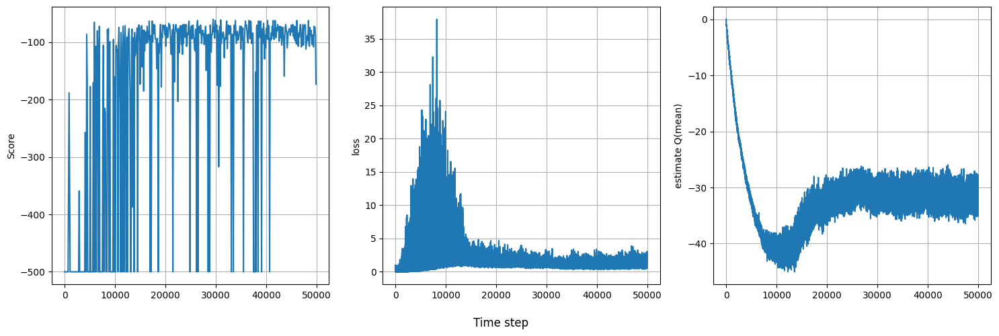

In [ ]:
# DQN 학습시 test score, loss, 평균 Q 를 그래프로 출력

y1 = np.array(test_scores)
y2 = np.array(losses)
y3 = np.array(qs)
x1 = np.arange(len(y1))*config["test_freq"]
x2 = np.arange(len(y2))
x3 = np.arange(len(y3))

fig, ax = plt.subplots(1, 3, sharex=True, sharey=False, figsize=(15, 5))
fig.supxlabel("Time step")

ax[0].plot(x1, y1)
ax[0].set_ylabel("Score")
ax[0].grid()

ax[1].plot(x2, y2)
ax[1].set_ylabel("loss")
ax[1].grid()

ax[2].plot(x3, y3)
ax[2].set_ylabel("estimate Q(mean)")
ax[2].grid()

plt.tight_layout()

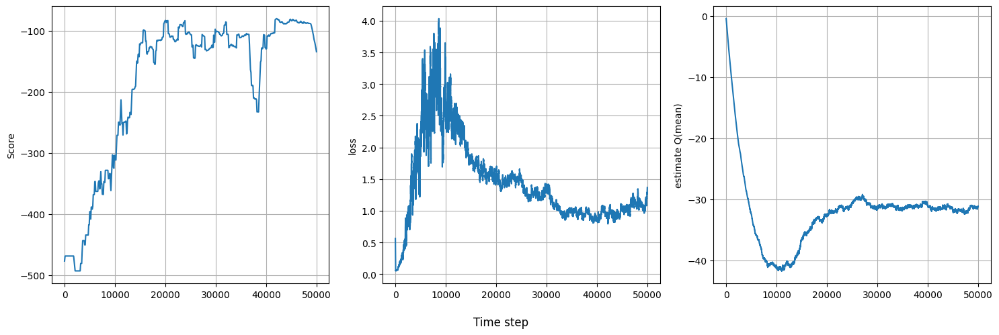

In [ ]:
# 그래프를 보기 좋게 이동평균 적용하여 출력
window1 = 20
window2 = 100

y1 = np.convolve(np.pad(np.array(test_scores), (window1//2, window1//2), mode="edge"), np.ones(window1)/window1, mode="valid")
y2 = np.convolve(np.pad(np.array(losses), (window2//2, window2//2), mode="edge"), np.ones(window2)/window2, mode="valid")
y3 = np.convolve(np.pad(np.array(qs), (window2//2, window2//2), mode="edge"), np.ones(window2)/window2, mode="valid")
x1 = np.arange(len(y1))*config["test_freq"]
x2 = np.arange(len(y2))
x3 = np.arange(len(y3))

fig, ax = plt.subplots(1, 3, sharex=True, sharey=False, figsize=(15, 5))
fig.supxlabel("Time step")

ax[0].plot(x1, y1)
ax[0].set_ylabel("Score")
ax[0].grid()

ax[1].plot(x2, y2)
ax[1].set_ylabel("loss")
ax[1].grid()

ax[2].plot(x3, y3)
ax[2].set_ylabel("estimate Q(mean)")
ax[2].grid()

plt.tight_layout()

### 1-4 Time step 별 모델의 동작 확인

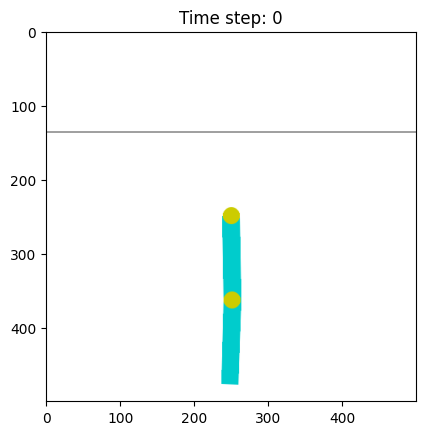

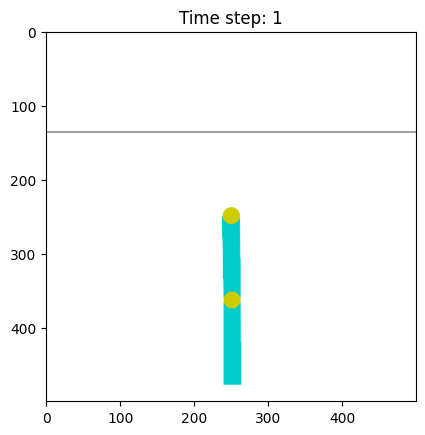

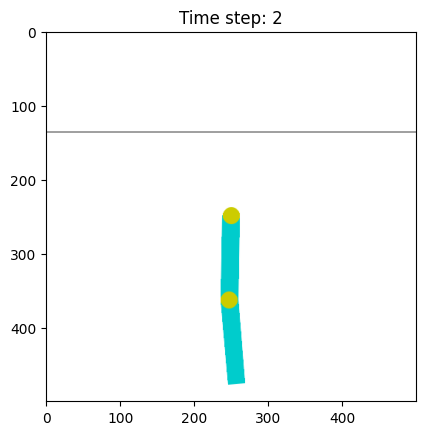

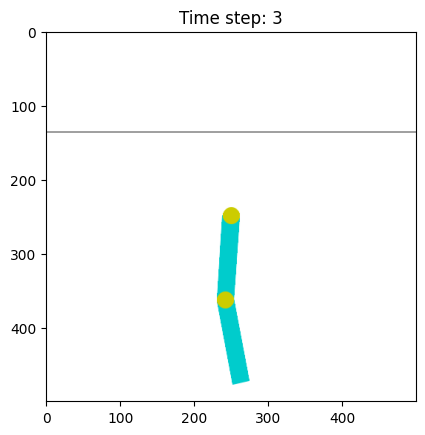

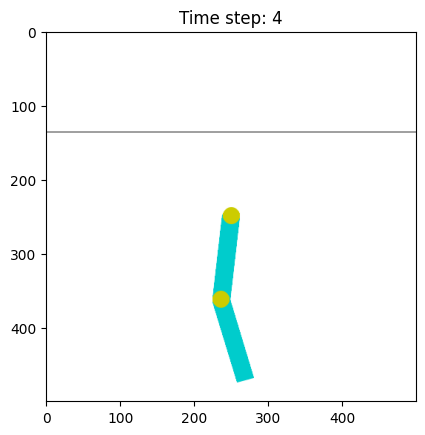

...

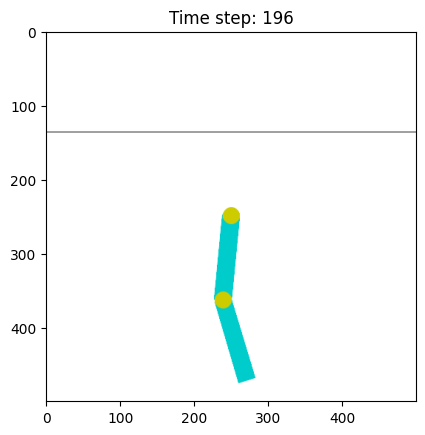

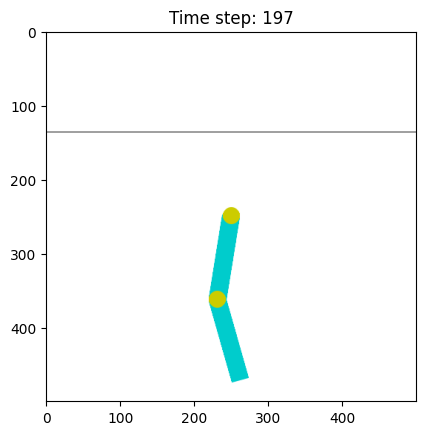

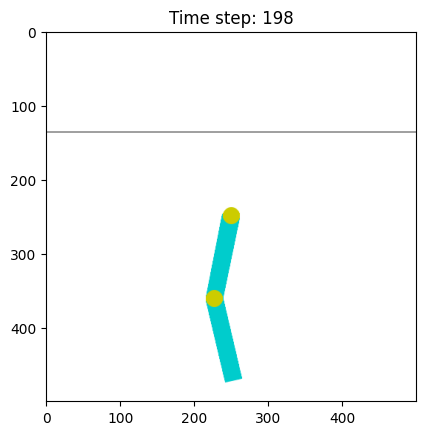

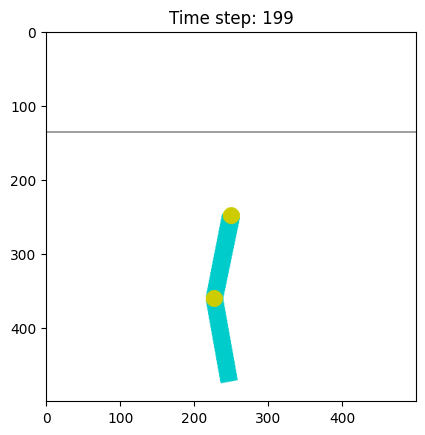

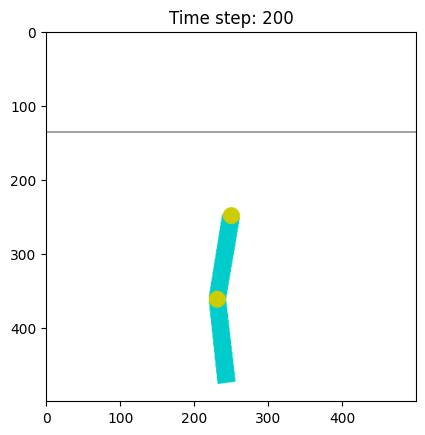

In [ ]:
# 학습 전(= train step 0) 모델의 성능
Q.load_state_dict(models[0])

env = gym.make(config["env_name"], render_mode="rgb_array")
state = env.reset()
plt.imshow(env.render()[0])
plt.title("Time step: 0")
plt.show()
for t in range(1, 201):
    action = getAction(state, dAction, config["epsilon_min"], Q)
    nextState, reward, done, _info = env.step(action)
    plt.imshow(env.render()[0])
    plt.title(f'Time step: {t}')
    plt.show()
    state = nextState
    if done:
        break


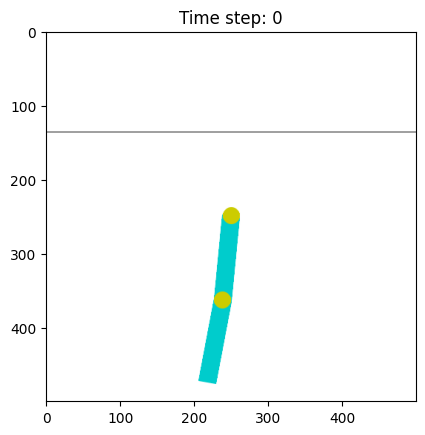

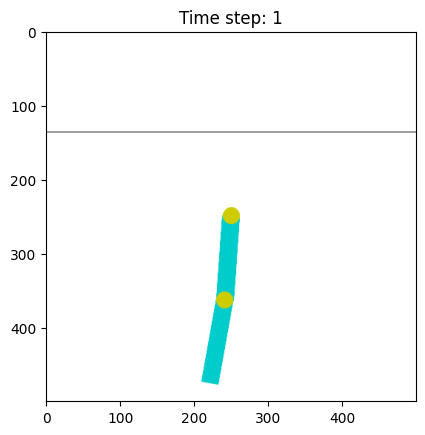

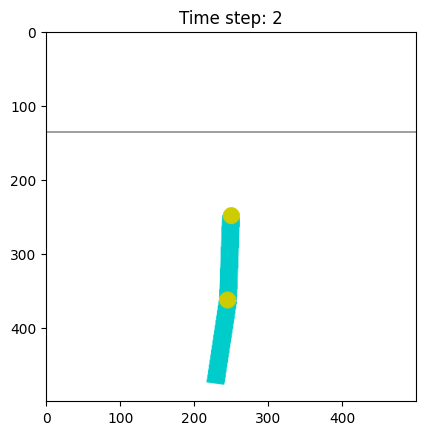

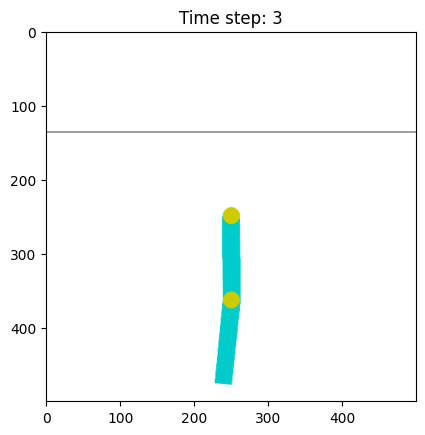

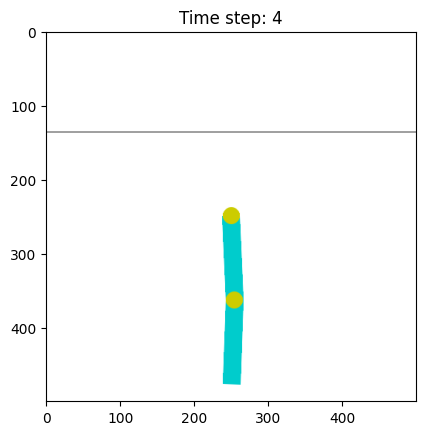

...

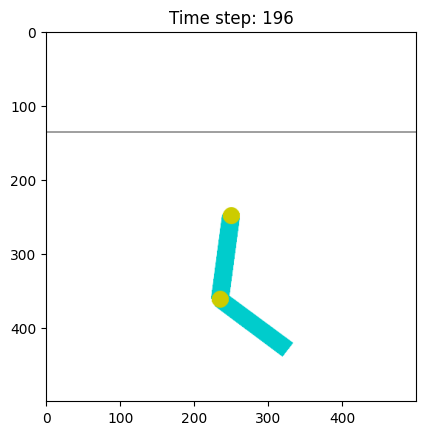

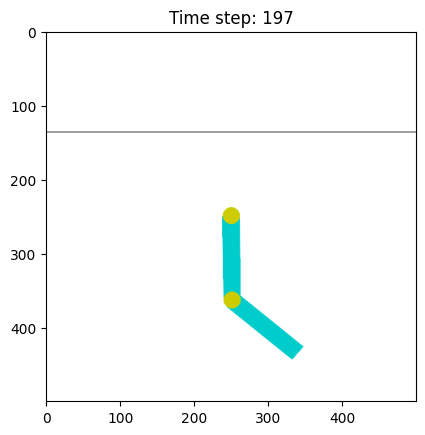

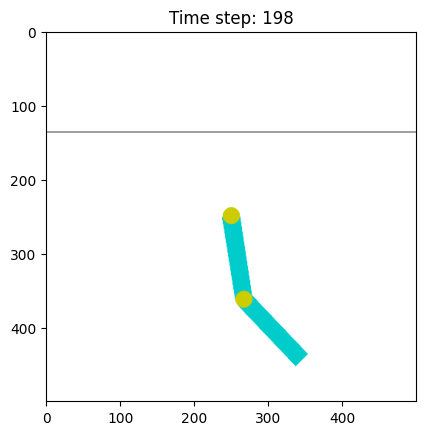

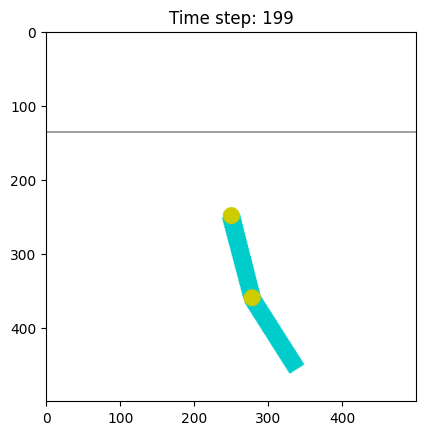

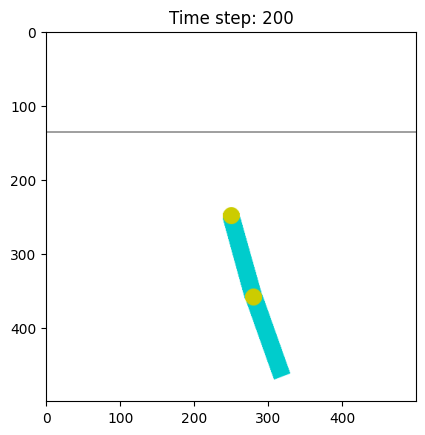

In [ ]:
# 학습 중반(= train step 10000) 모델의 성능
Q.load_state_dict(models[1])

env = gym.make(config["env_name"], render_mode="rgb_array")
state = env.reset()
plt.imshow(env.render()[0])
plt.title("Time step: 0")
plt.show()
for t in range(1, 201):
    action = getAction(state, dAction, config["epsilon_min"], Q)
    nextState, reward, done, _info = env.step(action)
    plt.imshow(env.render()[0])
    plt.title(f'Time step: {t}')
    plt.show()
    state = nextState
    if done:
        break


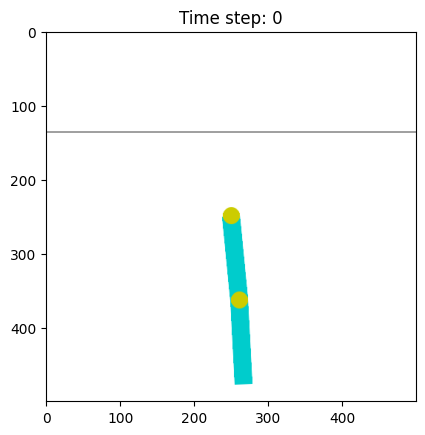

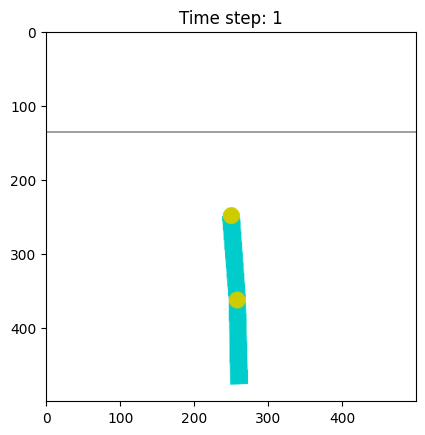

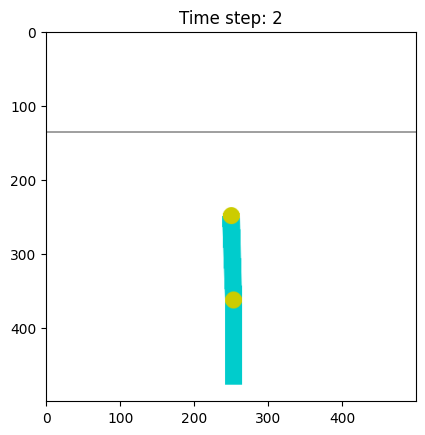

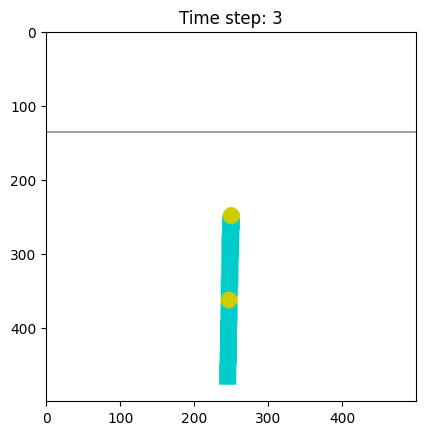

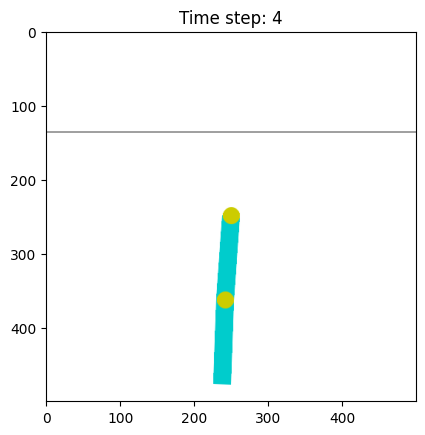

...

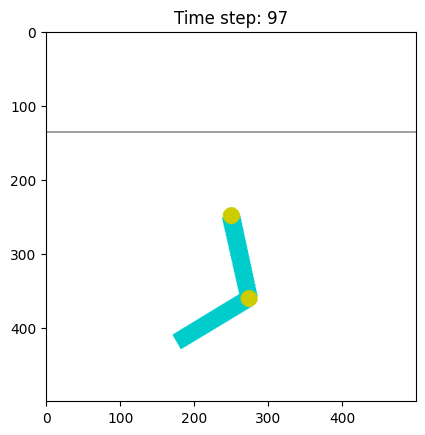

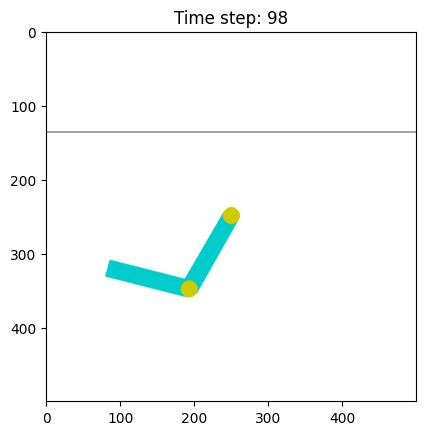

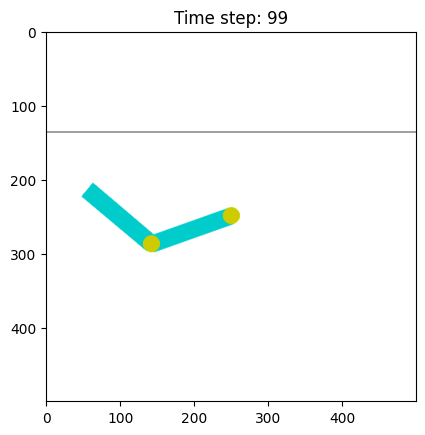

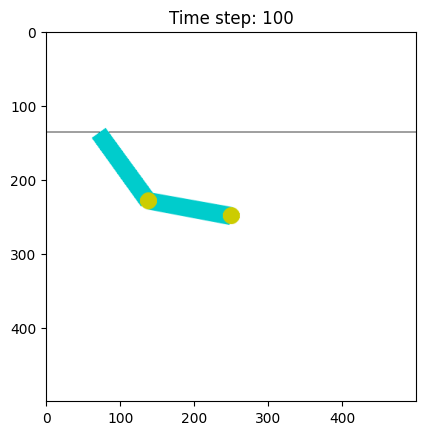

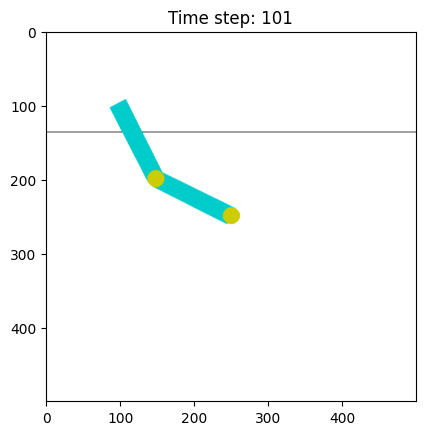

In [ ]:
# 학습 종료(= train step 50000) 모델의 성능
Q.load_state_dict(models[-1])

env = gym.make(config["env_name"], render_mode="rgb_array")
state = env.reset()
plt.imshow(env.render()[0])
plt.title("Time step: 0")
plt.show()
for t in range(1, 201):
    action = getAction(state, dAction, config["epsilon_min"], Q)
    nextState, reward, done, _info = env.step(action)
    plt.imshow(env.render()[0])
    plt.title(f'Time step: {t}')
    plt.show()
    state = nextState
    if done:
        break


# 3. CNN 기반 DQN

### 3-1. CarRacing 환경

<img src='https://drive.google.com/uc?export=download&id=1IiY5oZpDiUsqx5Vw1Tai6mnoM-bPLQWN' width="" height ="" /><br>

In [ ]:
import gym
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

env = gym.make("CarRacing-v2", continuous=False, render_mode="rgb_array")
# CarRacing 환경 생성
## CarRacing 환경은 continuous 행동 버전과 discrete 행동 버전으로 나뉘며, 여기서는 discrete 행동 버전을 수행
## 환경 reset 시, 맵이 랜덤하게 새로 생성됨
## 보상은 매 프레임 "-0.1"이고 새로운 트랙 타일 방문 시 "1000/(전체타일수)" 을 부여하고 트랙에서 크게 벗어날 경우 "-100" 부여
## 따라서 빠르게 경로를 크게 벗어나지 않고 모든 타일을 빠르게 완주하는게 목표

## 상태는 (96 x 96 x 3)크기의 이미지 기반 상태로 구성
## 행동은 총 5개로 구성 (가만히 있기, 핸들 왼쪽으로, 핸들 오른쪽으로, 가속, 브레이크)

<img src='https://drive.google.com/uc?export=download&id=1F7K0wgxL5kmn8SbkKZ2wilrs7kp5ZMe9' width="" height ="" /><br>

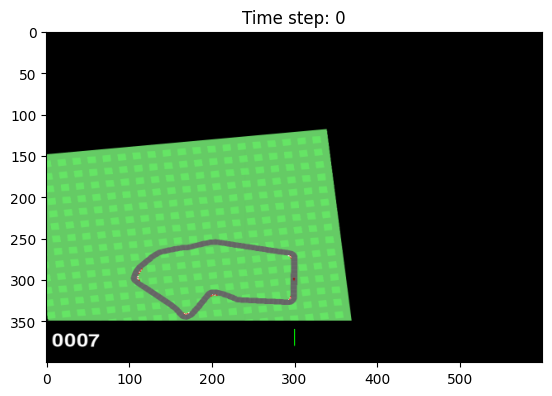

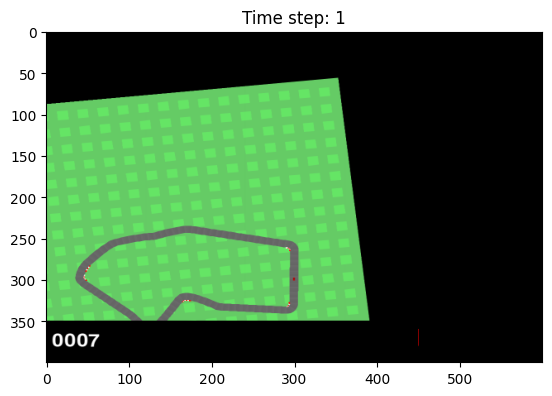

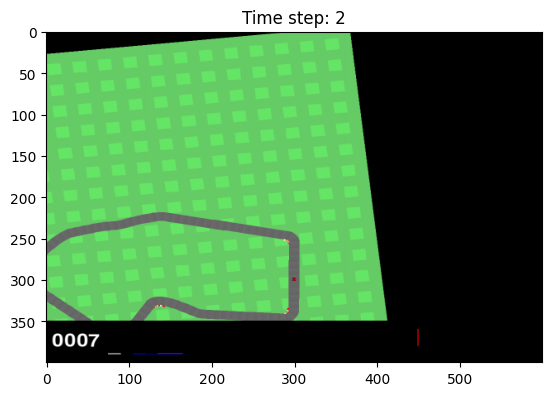

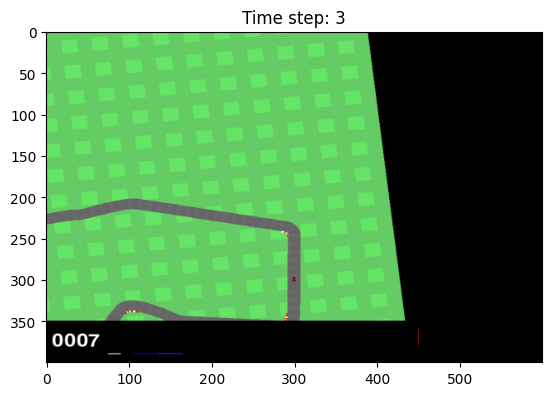

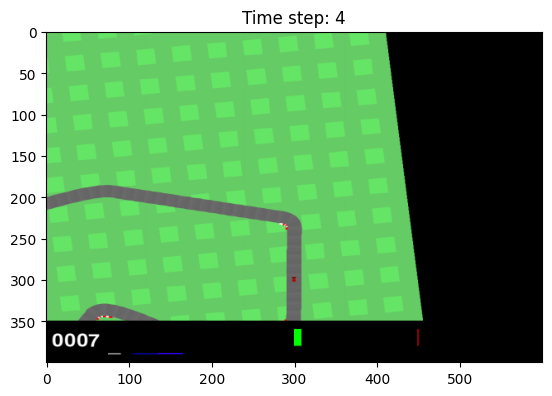

...

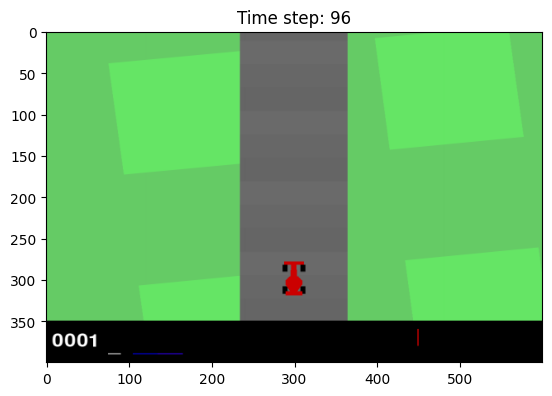

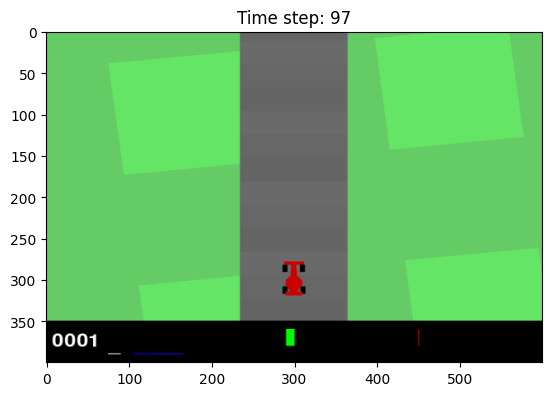

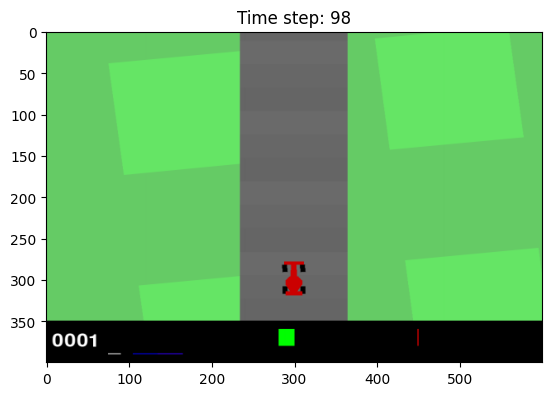

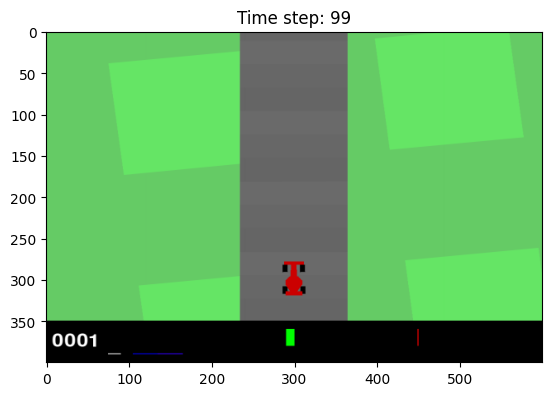

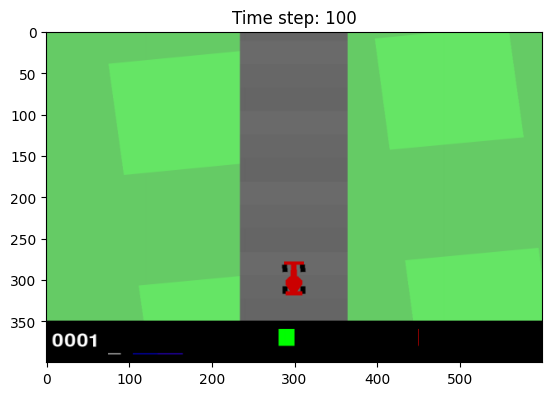

In [ ]:
# 100 step 동안 랜덤 행동에 대한 상태 이미지 확인

state = env.reset()
# 환경 초기화 및 초기 상태 획득
plt.imshow(env.render()[0])
plt.title('Time step: 0')
plt.show()
# 현재 상태 이미지 출력
for t in range(1, 101):
    action = env.action_space.sample()
    # 랜덤 행동 선택
    nextState, reward, done, _info = env.step(action)
    # 환경과 상호작용
    plt.imshow(env.render()[0])
    plt.title(f'Time step: {t}')
    plt.show()
    # 현재 상태 이미지 출력

하단의 정보는 좌측부터 (속도, 4개의 ABS 센서등, 핸들의 위치(녹색), 자이로센서)를 표시

랜덤 행동 수행 시 차량이 거의 제자리에 정지해 있는 모습을 보여준다

### 3-2. 상태 변환

환경을 통해 얻어지는 상태는 (3 x 96 x 96) 크기의 RGB 이미지임

본 실습에서 3채널의 RGB 이미지가 큰 의미 없으므로 1채널의 Gray 이미지(96 x 96)로 변환하고,

3장의 연속된 프레임을 하나로 결합하여 (3 x 96 x 96)의 이미지를 상태로 사용함

In [ ]:
import cv2
# 이미지 변환 관련 기능을 제공하는 라이브러리

obs 형태: (96, 96, 3)


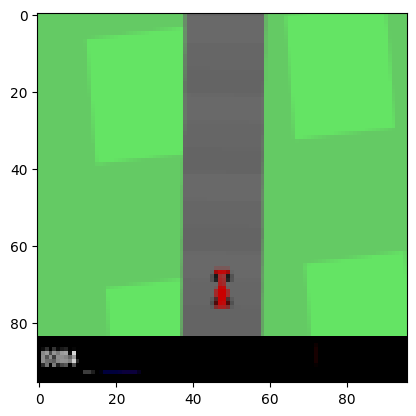

In [ ]:
obs = env.reset()
for _ in range(50):
    obs, _, _, _ = env.step(env.action_space.sample())
# 환경이 제공하는 상태
print("obs 형태:", obs.shape)
plt.imshow(obs)

obs 형태: (96, 96)


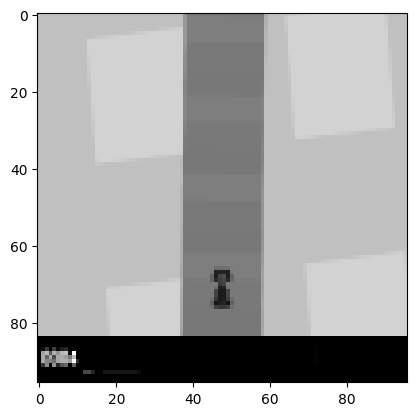

In [ ]:
# RGB 이미지를 Grayscale 이미지로 변환

obs = cv2.cvtColor(obs, cv2.COLOR_BGR2GRAY)
# cv2 라이브러리의 RGB -> Gray 이미지 변환 기능 사용
obs = obs.astype(float)
# 자료형 변환
obs /= 255.0
# 0~255 사이의 픽셀값을 0~1사이로 정규화
print("obs 형태:", obs.shape)
plt.imshow(obs, cmap="gray")

In [ ]:
# 연속된 3개 프레임의 Gray 이미지를 하나로 결합
from collections import deque
import numpy as np

frame_stack_deque = deque([obs]*3, maxlen=3)
# 초기 상태는 1장의 이미지 밖에 없으므로 동일한 3개의 Gray 이미지를 deque에 저장
state = np.array(frame_stack_deque)
# 3장의 Gray 이미지를 결합하여 최종적으로 상태 획득
print("state 형태:", state.shape)

# 이후 환경과 상호작용 하며
# frame_stack_deque에 다음 상태(Gray 이미지)를 넣고 state를 만들어 모델의 입력으로 활용함

state 형태: (3, 96, 96)


In [ ]:
# 위 내용으로 함수 정의

def toGray(obs):
    # Gray 이미지로 변환
    obs = cv2.cvtColor(obs, cv2.COLOR_BGR2GRAY)
    obs = obs.astype(float)
    obs /= 255.0
    return obs

def toState(deque):
    # deque의 이미지 3장을 결합하여 반환
    frame_stack = np.array(deque)
    return frame_stack

### 3-3. CNN 기반 DQN algorithm

In [ ]:
# 필요 라이브러리 로드(이전 실습과 동일)

import random
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from collections import deque
import gym
import warnings
warnings.filterwarnings("ignore", category=DeprecationWarning)

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

In [ ]:
# 환경 및 테스트 환경 정의

env      = gym.make("CarRacing-v2", continuous=False)
test_env = gym.make("CarRacing-v2", continuous=False)
# test_env는 학습 도중 알고리즘의 성능을 확인하기 위한 환경
dState = env.observation_space.shape[2] # 환경의 채널 수
dAction = env.action_space.n # 환경의 discrete action 개수
print("상태 이미지 채널 수:", dState) # RGB 이므로 3채널
print("행동공간 크기(discrete):", dAction)

# 오류 발생 시, 본 실습코드 최상단 첫번째 코드를 실행하여 관련 라이브러리 설치 필요

상태 이미지 채널 수: 3
행동공간 크기(discrete): 5


### 3-3-1. Q 네트워크 정의

앞선 실습과 달리 상태공간이 이미지이므로 CNN을 활용한 Q 네트워크를 활용할 수 있음

In [ ]:
# Q 네트워크 클래스 정의

class Qnet(nn.Module):
    def __init__(self, dChannel, dAction):
        super().__init__()
        self.layers = nn.Sequential(
            nn.Conv2d(in_channels=dChannel, out_channels=6, kernel_size=(7, 7), stride=3),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=(2, 2)),
            nn.Conv2d(in_channels=6, out_channels=12, kernel_size=(4, 4), stride=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=(2, 2)),
            nn.Flatten(),
            nn.Linear(in_features=12*6*6, out_features=256),
            nn.ReLU(),
            nn.Linear(in_features=256, out_features=dAction)
        )
        # CNN 부분: 2개의 convolution & maxpooling 층으로 구성
        # MLP 부분: 2개의 linear 층으로 구성

    def forward(self, x): # 네트워크 처리 과정 정의
        return self.layers(x) # self.layers 신경망을 통과한 후 출력을 반환

In [ ]:
# Q 및 target Q 네트워크 정의

Q = Qnet(dChannel=dState, dAction=dAction).to(DEVICE)
# Q 네트워크 선언(online network) 및 device 이동(GPU or CPU)
targetQ = Qnet(dChannel=dState, dAction=dAction).to(DEVICE) # target Q 정의
# target Q 네트워크 선언(target network) 및 device 이동(GPU or CPU)

In [ ]:
# Q 구성 확인

print(Q)

Qnet(
  (layers): Sequential(
    (0): Conv2d(3, 6, kernel_size=(7, 7), stride=(3, 3))
    (1): ReLU()
    (2): MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(6, 12, kernel_size=(4, 4), stride=(1, 1))
    (4): ReLU()
    (5): MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
    (6): Flatten(start_dim=1, end_dim=-1)
    (7): Linear(in_features=432, out_features=256, bias=True)
    (8): ReLU()
    (9): Linear(in_features=256, out_features=5, bias=True)
  )
)


In [ ]:
# 각각의 레이어 통과 시 입력 데이터의 변화

x = torch.rand(10, 3, 96, 96).to(DEVICE)
# batch 크기 10 짜리의 더미 상태 생성

print("입력 데이터 형태:", x.shape)
print("")

x = Q.layers[0](x)
print("1층-conv2d 통과 후 형태:", x.shape)
x = Q.layers[2](x)
print("1층-maxpool2d 통과 후 형태:", x.shape)
print("")

x = Q.layers[3](x)
print("2층-conv2d 통과 후 형태:", x.shape)
x = Q.layers[5](x)
print("2층-maxpool2d 통과 후 형태:", x.shape)
print("")

x = Q.layers[6](x)
print("flatten 통과 후 형태:", x.shape)
print("")

x = Q.layers[7](x)
print("3층-linear 통과 후 형태:", x.shape)
print("")

x = Q.layers[9](x)
print("4층-linear 통과 후 형태:", x.shape)

# 최종적으로 batch 데이터 별, 5개의 Q값을 반환

입력 데이터 형태: torch.Size([10, 3, 96, 96])

1층-conv2d 통과 후 형태: torch.Size([10, 6, 30, 30])
1층-maxpool2d 통과 후 형태: torch.Size([10, 6, 15, 15])

2층-conv2d 통과 후 형태: torch.Size([10, 12, 12, 12])
2층-maxpool2d 통과 후 형태: torch.Size([10, 12, 6, 6])

flatten 통과 후 형태: torch.Size([10, 432])

3층-linear 통과 후 형태: torch.Size([10, 256])

4층-linear 통과 후 형태: torch.Size([10, 5])


#### 3-3-2. 전체 코드

이미지 기반 환경 특성상 학습 시간이 오래 걸리는 관계로 전체 학습 횟수를 줄여서  수행

아래 코드는 학습에 약 30~40분 소요



In [ ]:
import random
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from collections import deque
import gym
import warnings
import cv2
warnings.filterwarnings("ignore", category=DeprecationWarning)
# 지저분한 deprecation warning 문구 제거

DEVICE = "cuda" if torch.cuda.is_available() else "cpu"

# hyperparameter 정의
config = dict(
    env_name            = "CarRacing-v2", # 환경
    batch               = 128,          # 배치 크기
    buffer_size         = 10000,        # 버퍼의 최대 크기(transition 단위)
    lr                  = 0.001,        # 학습률
    gamma               = 0.99,         # discount(할인율)
    epsilon_init        = 0.1,          # 초기 epsilon(=초기 탐험 비율)
    epsilon_min         = 0.001,        # 최소 epsilon(=최종 탐험 비율)
    epsilon_decay       = 0.99,         # epsilon 감소 비율(매 episode마다 epsilon에 곱해짐)
    n_step              = 15000,        # 학습 횟수 (time step 단위)
    n_train_start       = 3000,         # 초기 버퍼 채우기(time step 단위)
    target_update_freq  = 100,          # target Q의 업데이트 주기(time step 단위)
    test_freq           = 100,          # test 주기(time step 단위)

    skip_frame          = 2,
)

# 환경 및 테스트 환경 정의
env      = gym.make(config["env_name"], continuous=False)
test_env = gym.make(config["env_name"], continuous=False)
dState = env.observation_space.shape[0] # 환경의 state_space 크기
dAction = env.action_space.n # 환경의 discrete action 개수

# Q 네트워크 클래스 정의
class Qnet(nn.Module):
    def __init__(self, dChannel, dAction):
        super().__init__()
        self.layers = nn.Sequential(
            nn.Conv2d(in_channels=dChannel, out_channels=6, kernel_size=(7, 7), stride=3),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=(2, 2)),
            nn.Conv2d(in_channels=6, out_channels=12, kernel_size=(4, 4), stride=1),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=(2, 2)),
            nn.Flatten(),
            nn.Linear(in_features=12*6*6, out_features=256),
            nn.ReLU(),
            nn.Linear(in_features=256, out_features=dAction)
        )

    def forward(self, x): # 네트워크 처리 과정 정의
        return self.layers(x) # self.layers 신경망을 통과한 후 출력을 반환


# Q 및 target Q 네트워크 정의
Q = Qnet(dChannel=3, dAction=dAction).to(DEVICE)
targetQ = Qnet(dChannel=3, dAction=dAction).to(DEVICE) # target Q 정의
targetQ.load_state_dict(Q.state_dict())
optimizerQ = optim.Adam(Q.parameters(), lr=config["lr"])

# replay buffer 정의
replay_buffer = deque(maxlen=config["buffer_size"])

gamma = config["gamma"]
epsilon = config["epsilon_init"]

def getAction(state, dAction, epsilon, Q):
    with torch.no_grad(): # 본 함수는 역전파를 위한 gradient 계산이 필요 없으므로 gradient 계산을 제외시켜 연산량 줄임
        if (random.random() > epsilon): # exploitation(활용)
            state = torch.from_numpy(state).float().to(DEVICE).unsqueeze(dim=0)
            # Q 네트워크가 device에 존재하므로 입력인 state도 동일한 device로 이동시켜줌
            action = Q(state).argmax(dim=-1).detach().cpu().numpy().squeeze()
            # state에서 모든 action에 대해 Q를 계산하고, 가장 높은 Q를 가진 action 선택
        else: # exploration(탐험)
            action = np.random.randint(low=0, high=dAction)
            # random하게 action 선택
    return action

def test(env, Q, dAction, epsilon):
    with torch.no_grad():
        score = 0.0
        obs = env.reset()
        obs = toGray(obs)
        frame_stack_deque = deque([obs]*3, maxlen=3)
        state = toState(frame_stack_deque)
        while True:
            action = getAction(state, dAction, epsilon, Q)
            reward = 0.0
            for _ in range(config["skip_frame"] + 1):
                nextObs, r, done, _info = env.step(action)
                reward += r
            nextObs = toGray(nextObs)
            frame_stack_deque.append(nextObs)
            nextState = toState(frame_stack_deque)
            score += reward
            state = nextState
            if done:
                break
    return score

def toGray(obs):
    obs = cv2.cvtColor(obs, cv2.COLOR_BGR2GRAY)
    obs = obs.astype(float)
    obs /= 255.0
    return obs

def toState(deque):
    frame_stack = np.array(deque)
    # return np.transpose(frame_stack, (1, 2, 0))
    return frame_stack


# 학습 전, 샘플 수집
print("--- sample 수집 중... ---")
obs = env.reset()
obs = toGray(obs)
frame_stack_deque = deque([obs]*3, maxlen=3)
state = toState(frame_stack_deque)
for t in range(1, config["n_train_start"]+1):
    action = getAction(state, dAction, epsilon, Q)
    reward = 0.0
    for _ in range(config["skip_frame"] + 1):
        nextObs, r, done, _info = env.step(action)
        reward += r
        if done:
            break
    nextObs = toGray(nextObs)
    frame_stack_deque.append(nextObs)
    nextState = toState(frame_stack_deque)
    transition = (state, action, reward, nextState, done)
    replay_buffer.append(transition)
    state = nextState
    if done:
        obs = env.reset()
        obs = toGray(obs)
        frame_stack_deque = deque([obs]*3, maxlen=3)
        state = toState(frame_stack_deque)
print("--- sample 수집 완료 ---")

print("--- 메인 학습 루프 ---")

# 메인 학습 루프
score = 0.0
scores = []
test_scores = []
losses = []
qs = []
# score 및 각종 성능 계산을 위한 변수 정의

obs = env.reset() # (96, 96, 3)
obs = toGray(obs) # (96, 96)
frame_stack_deque = deque([obs]*3, maxlen=3)
state = toState(frame_stack_deque) # (3, 96, 96)
# 환경 초기화 및 초기 상태 획득
for t in range(1, config["n_step"]+1):
    # --- 환경 상호작용 ---
    action = getAction(state, dAction, epsilon, Q)
    reward = 0.0
    for _ in range(config["skip_frame"] + 1):
        nextObs, r, done, _info = env.step(action)
        reward += r
        if done:
            break
    nextObs = toGray(nextObs)
    frame_stack_deque.append(nextObs)
    nextState = toState(frame_stack_deque)
    transition = (state, action, reward, nextState, done)
    replay_buffer.append(transition)

    score += reward
    state = nextState
    if done: # episode 종료 시
        obs = env.reset()
        obs = toGray(obs)
        frame_stack_deque = deque([obs]*3, maxlen=3)
        state = toState(frame_stack_deque)
        scores.append(score)
        score = 0.0
        # --- epsilon 업데이트 ---
        epsilon = max(config["epsilon_min"], epsilon*config["epsilon_decay"])

    # --- batch 샘플링 ---
    transitions = random.sample(replay_buffer, config["batch"])
    batch = []
    for item in zip(*transitions):
        item = torch.from_numpy(np.stack(item)).float().to(DEVICE)
        batch.append(item)
    states, actions, rewards, nextStates, dones = batch # (dBatch, -)
    actions = actions.unsqueeze(dim=-1).long()
    rewards = rewards.unsqueeze(dim=-1)
    dones = dones.unsqueeze(dim=-1)
    # 배치 샘플 준비

    # --- loss 계산 ---
    # estimate
    estimateQs = Q(states).gather(dim=1, index=actions) # (dBatch, 1)
    # Q(s, a)

    # target
    with torch.no_grad():
        nextTargetQs = targetQ(nextStates).max(dim=-1, keepdim=True).values # (dBatch, 1)
        # max_a Q'(s_t+1, a)
        targetQs = rewards + (1 - dones) * gamma * nextTargetQs # (dBatch, 1)
        # r + gamma * max_a Q'(s_t+1, a)

    loss = F.mse_loss(targetQs.detach(), estimateQs) # scalar
    # MSE{ targetQ, Q }

    # --- 오차 역전파 및 매개변수 업데이트 ---
    optimizerQ.zero_grad()
    loss.backward()
    optimizerQ.step()
    losses.append(loss.detach().cpu().item())
    qs.append(estimateQs.detach().mean().cpu().item())

    # --- target Q 네트워크 업데이트 ---
    if t % config["target_update_freq"] == 0:
        targetQ.load_state_dict(Q.state_dict())
        # 정해진 주기마다 targetQ 를 Q 네트워크로 업데이트

    # --- test score 계산 ---
    if t % config["test_freq"] == 0:
        test_score = test(test_env, Q, dAction, epsilon=config["epsilon_min"])
        test_scores.append(test_score)
        print(f'[time:{t}]test score: {test_score}, train loss: {losses[-1]:.3f}, epsilon: {epsilon:.3f}')
        # 정해진 주기마다 현재 모델로 환경과 한 episode 상호작용후 score 계산

--- sample 수집 중... ---
--- sample 수집 완료 ---
--- 메인 학습 루프 ---
[time:100]test score: -93.18245614034986, train loss: 0.010, epsilon: 0.100
[time:200]test score: -180.08219178082248, train loss: 0.222, epsilon: 0.100
[time:300]test score: -20.654545454545207, train loss: 0.321, epsilon: 0.100
[time:400]test score: -93.59933993399235, train loss: 0.022, epsilon: 0.099
[time:500]test score: -23.276923076923577, train loss: 0.251, epsilon: 0.099
[time:600]test score: -24.38772563176968, train loss: 0.232, epsilon: 0.099
[time:700]test score: 20.48965517241261, train loss: 0.156, epsilon: 0.098
[time:800]test score: -93.83057324840658, train loss: 0.311, epsilon: 0.098
[time:900]test score: 20.543034055728562, train loss: 0.325, epsilon: 0.098
[time:1000]test score: -35.5741496598647, train loss: 0.430, epsilon: 0.098
[time:1100]test score: -32.458064516129824, train loss: 0.281, epsilon: 0.097
[time:1200]test score: -12.998327759194353, train loss: 0.198, epsilon: 0.097
[time:1300]test score

### 3-4. 성능 그래프 출력

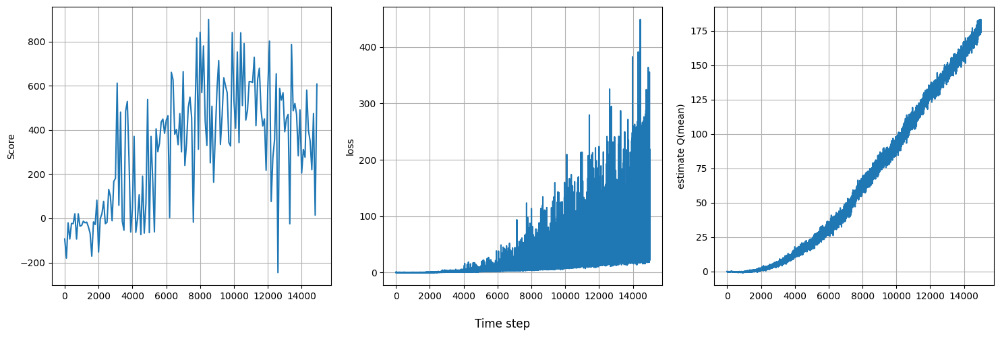

In [ ]:
import matplotlib.pyplot as plt
# DQN 학습시 test score, loss, 평균 Q 를 그래프로 출력

y1 = np.array(test_scores)
y2 = np.array(losses)
y3 = np.array(qs)
x1 = np.arange(len(y1))*config["test_freq"]
x2 = np.arange(len(y2))
x3 = np.arange(len(y3))

fig, ax = plt.subplots(1, 3, sharex=True, sharey=False, figsize=(15, 5))
fig.supxlabel("Time step")

ax[0].plot(x1, y1)
ax[0].set_ylabel("Score")
ax[0].grid()

ax[1].plot(x2, y2)
ax[1].set_ylabel("loss")
ax[1].grid()

ax[2].plot(x3, y3)
ax[2].set_ylabel("estimate Q(mean)")
ax[2].grid()

plt.tight_layout()

### 3-5. 모델의 동작 확인

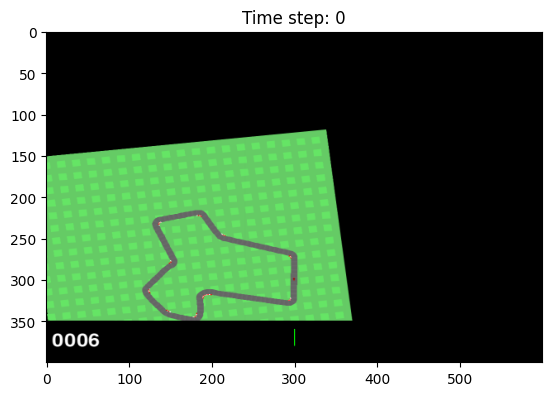

0


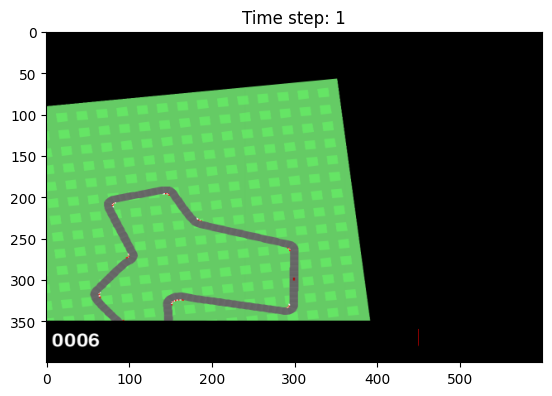

2


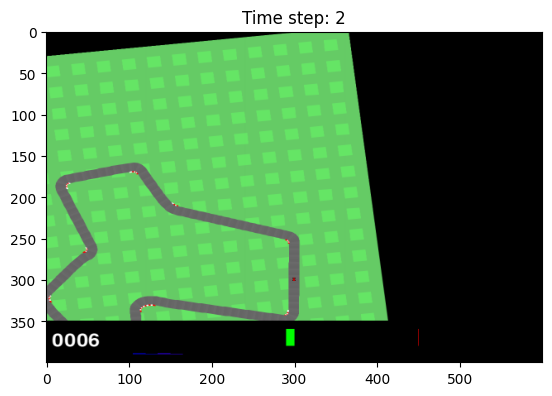

1


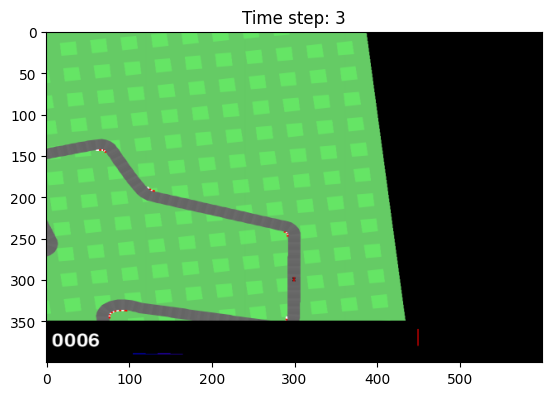

4


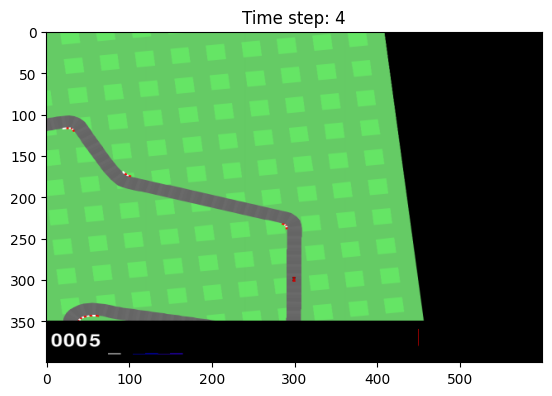

3


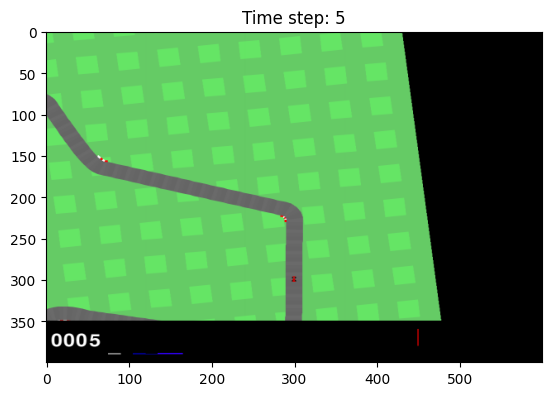

3


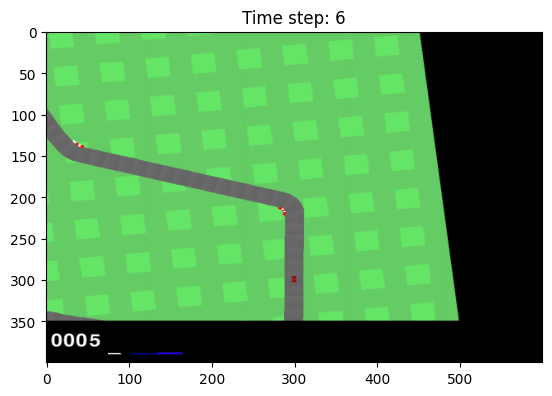

3


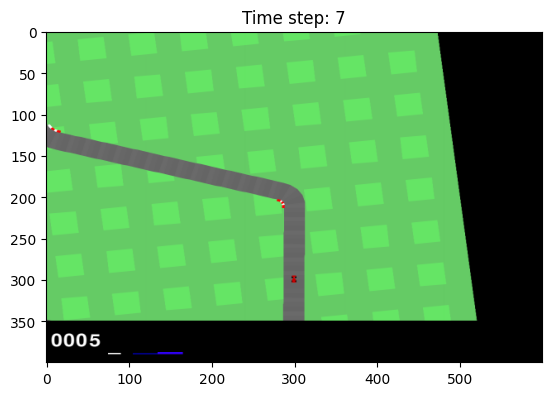

3


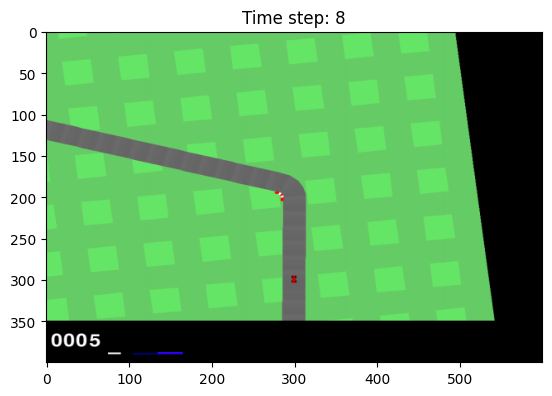

3


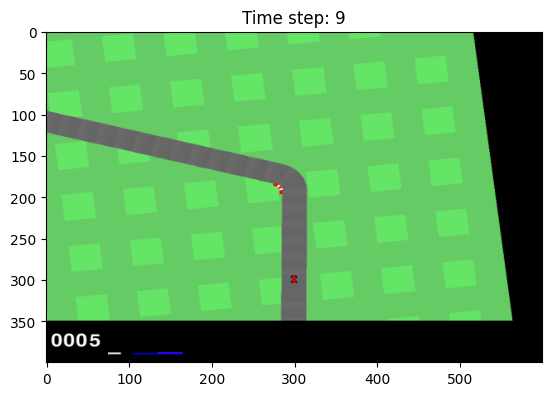

0


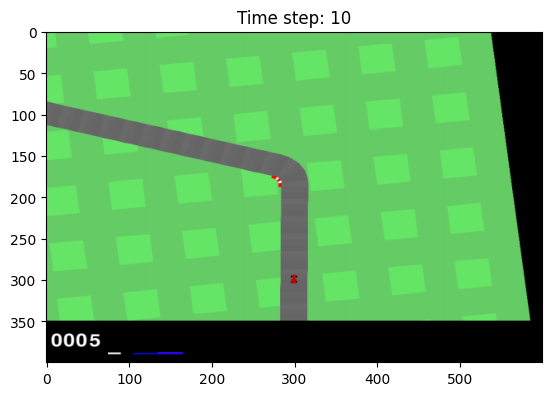

1


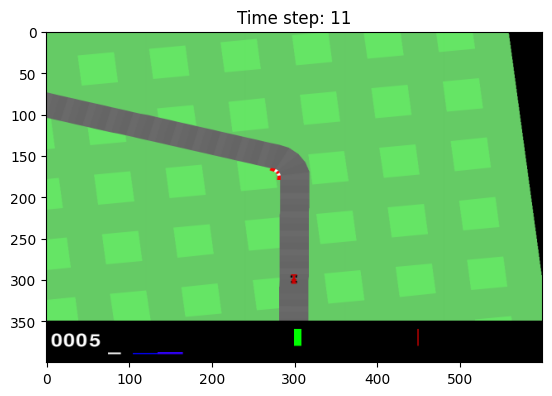

1


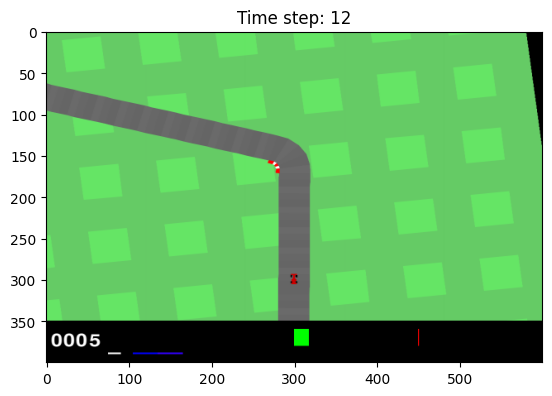

1


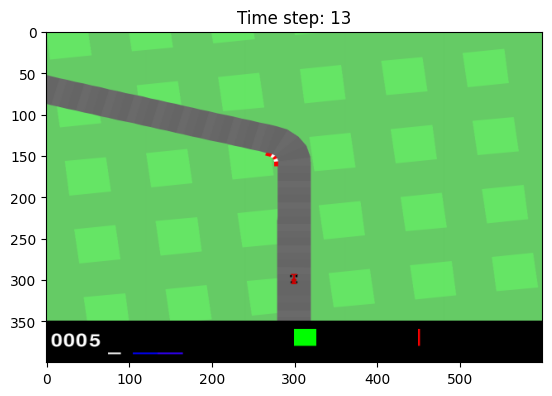

1


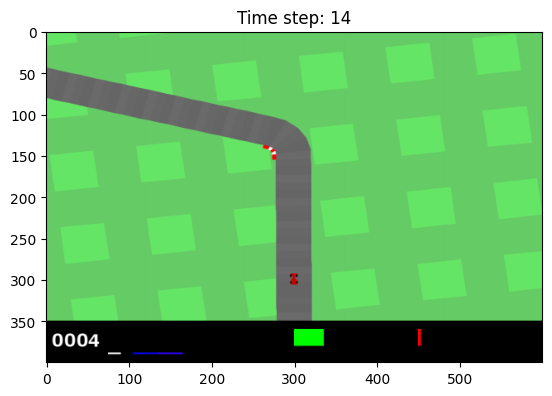

0


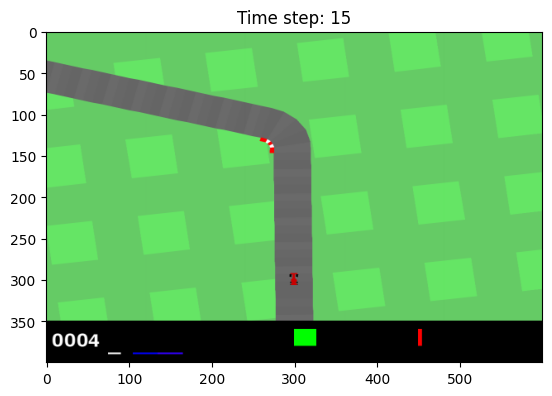

2


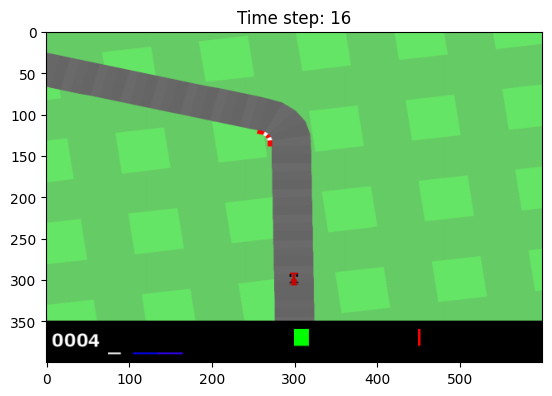

1


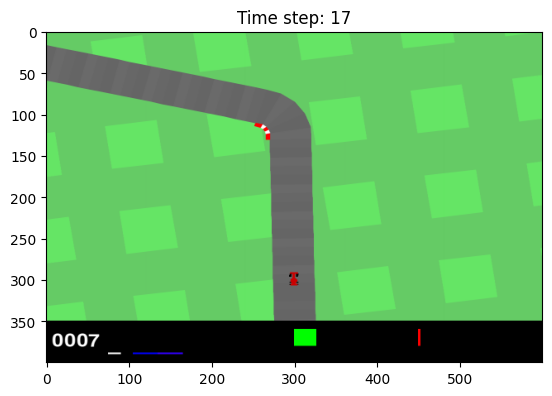

3


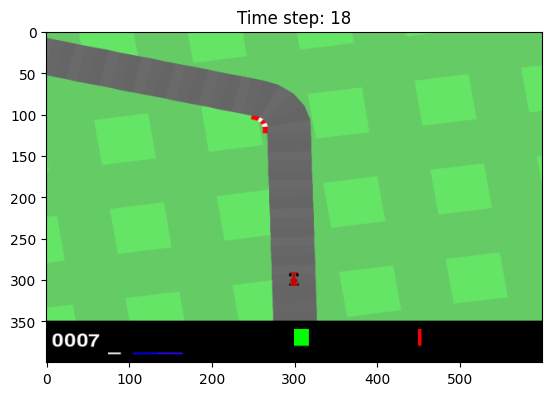

3


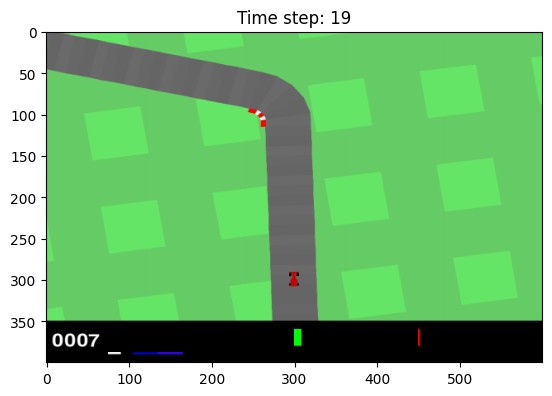

3


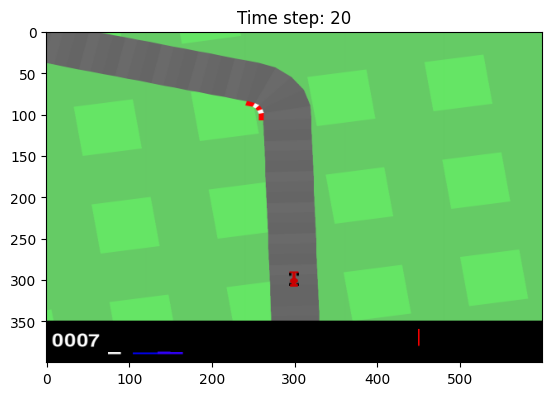

3


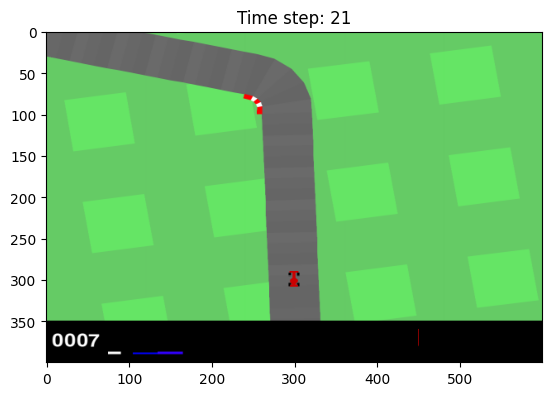

3


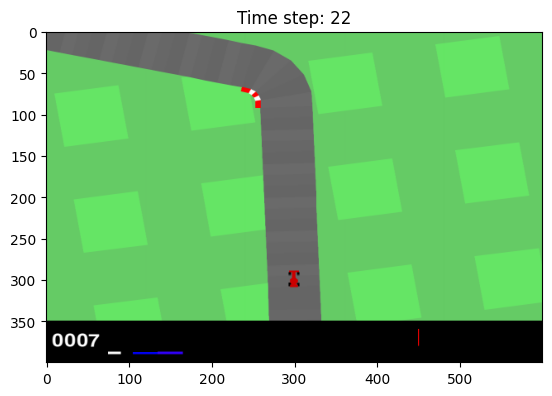

1


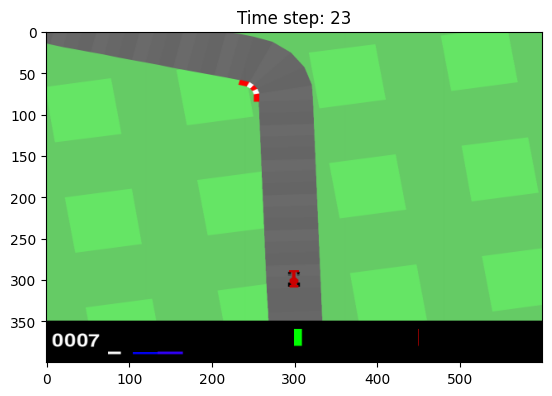

3


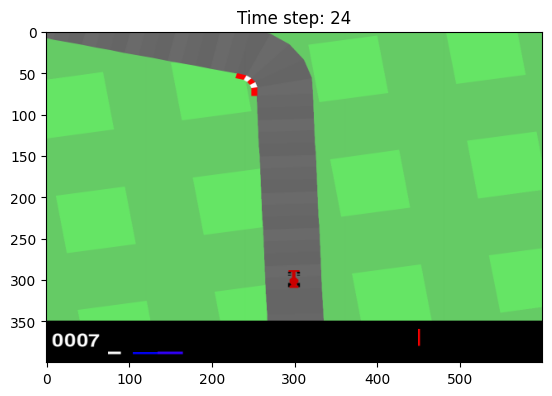

3


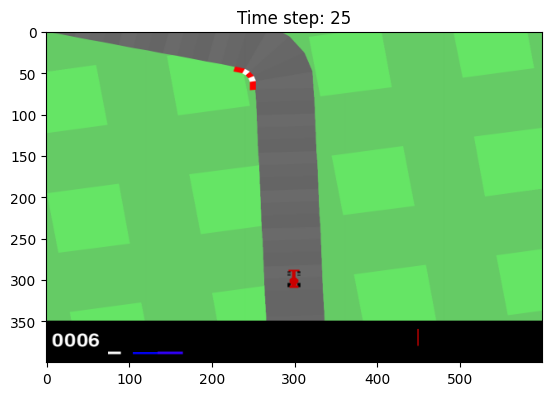

3


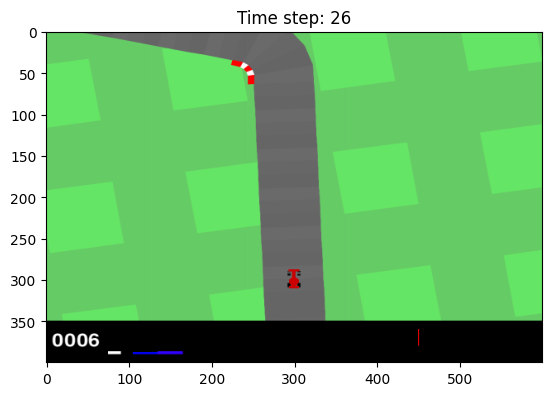

3


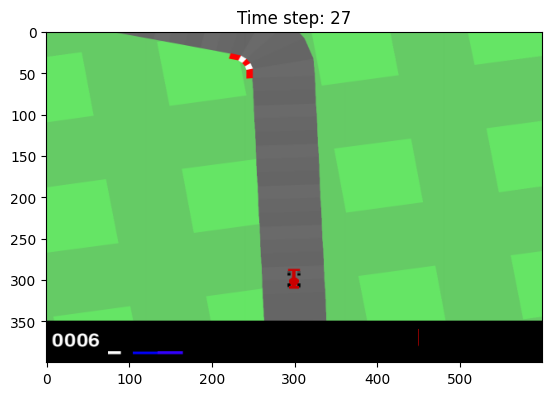

3


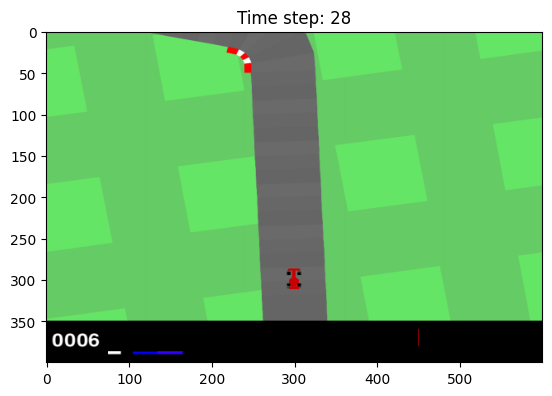

3


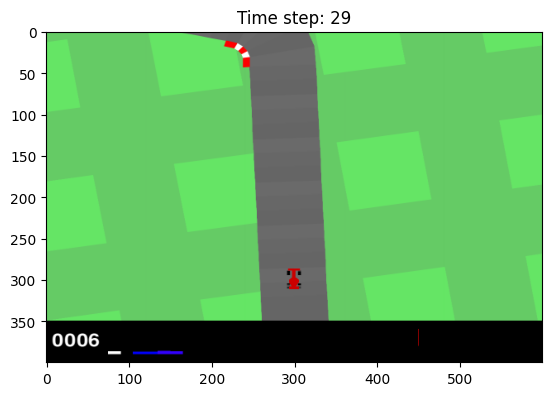

0


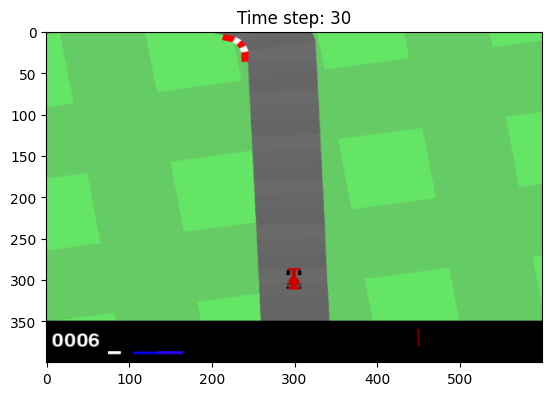

1


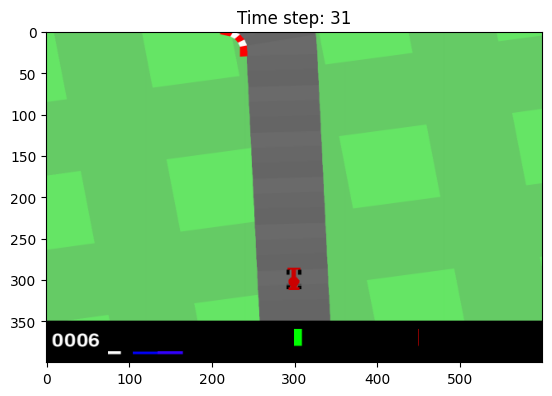

1


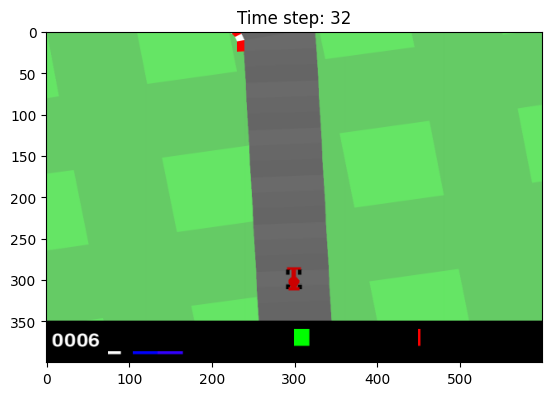

0


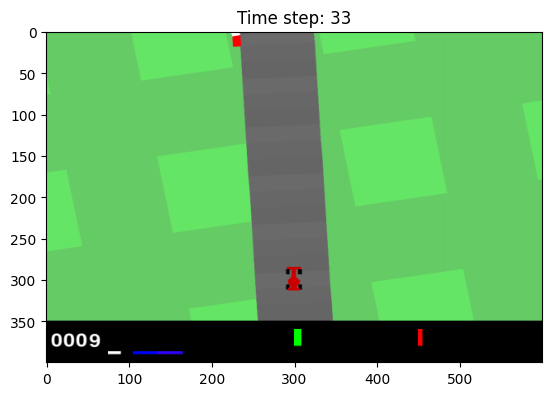

0


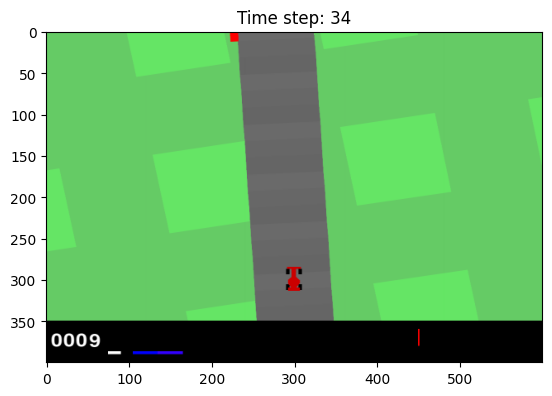

0


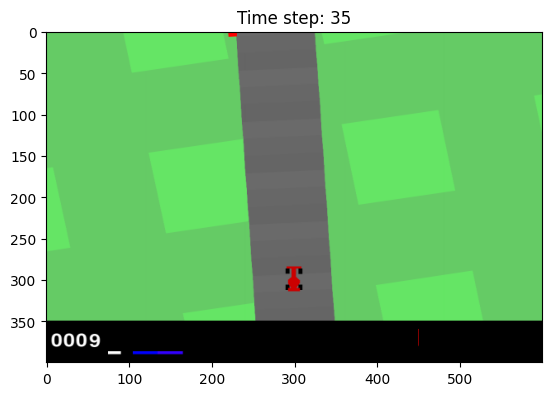

3


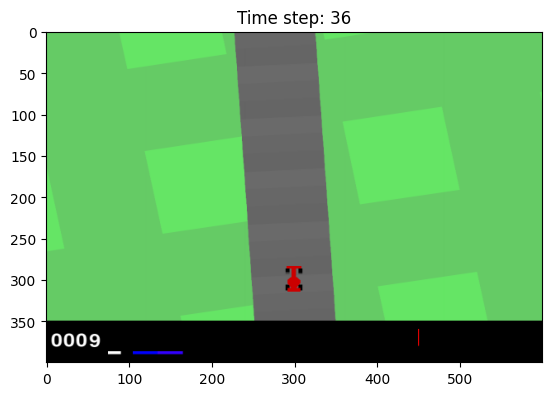

3


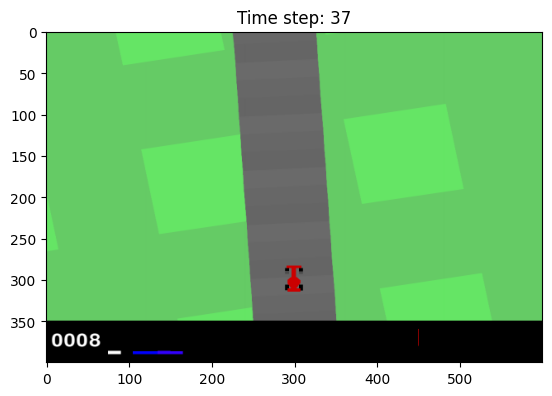

1


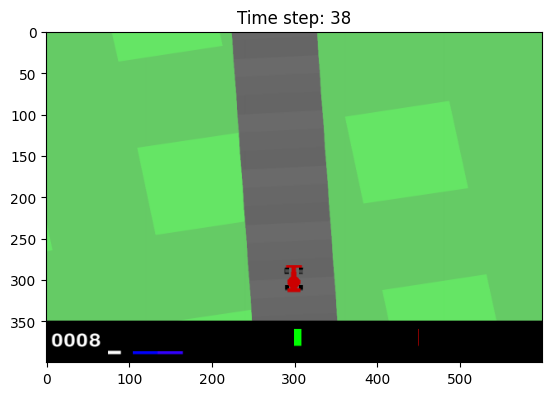

1


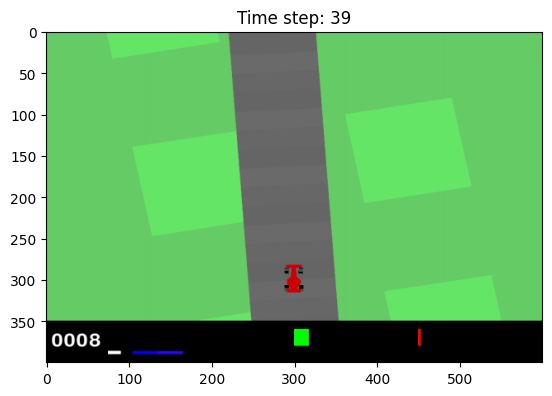

1


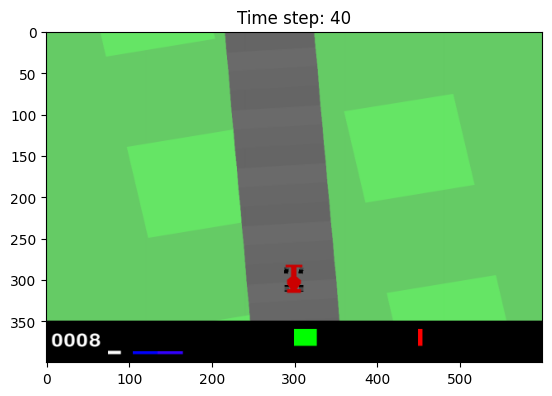

2


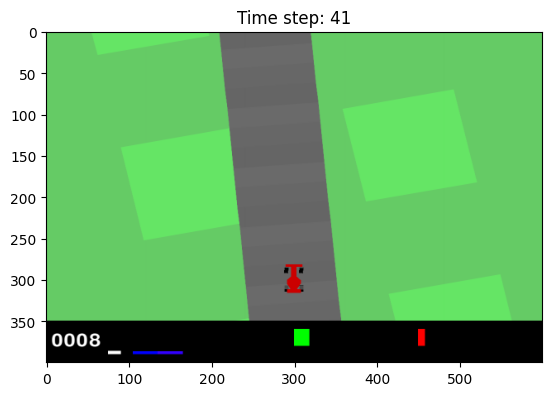

2


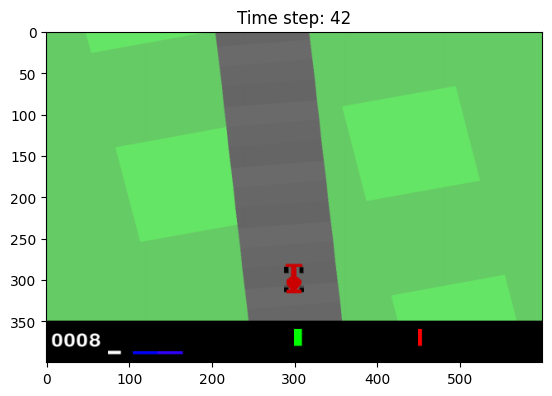

2


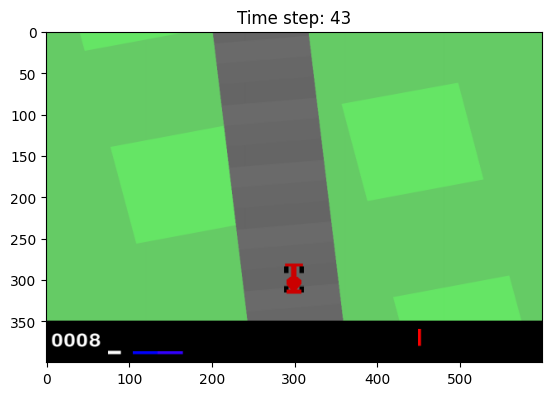

2


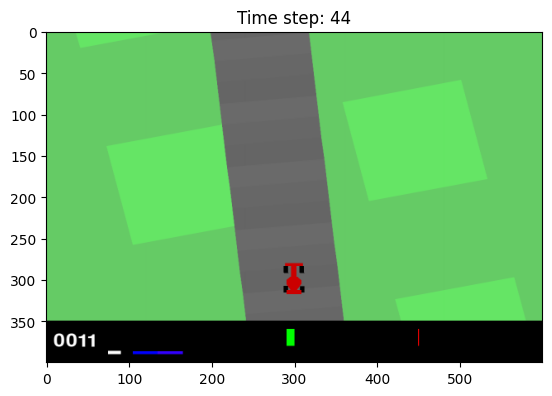

2


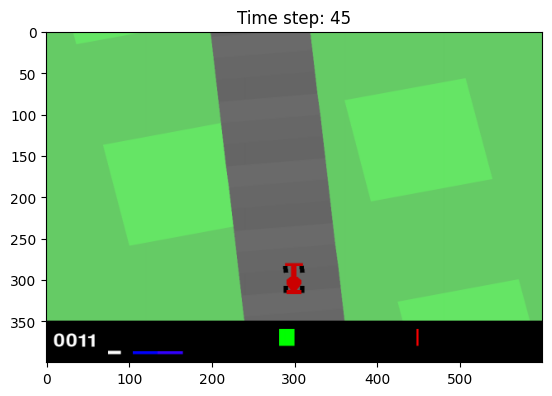

2


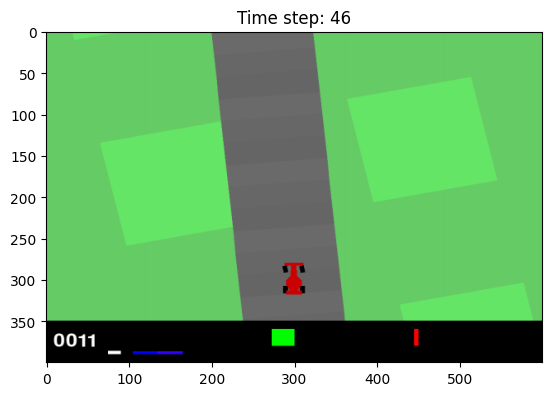

3


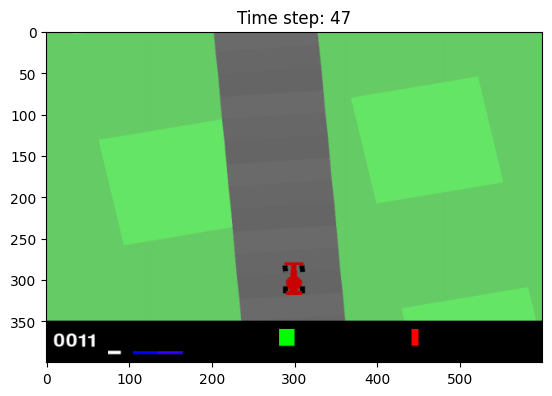

3


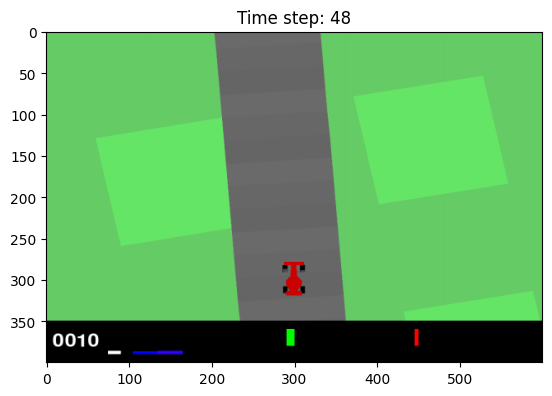

3


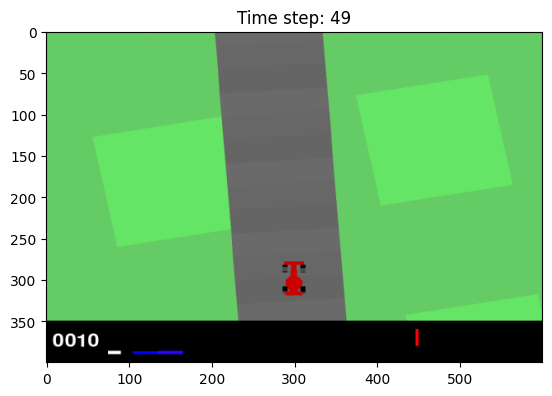

3


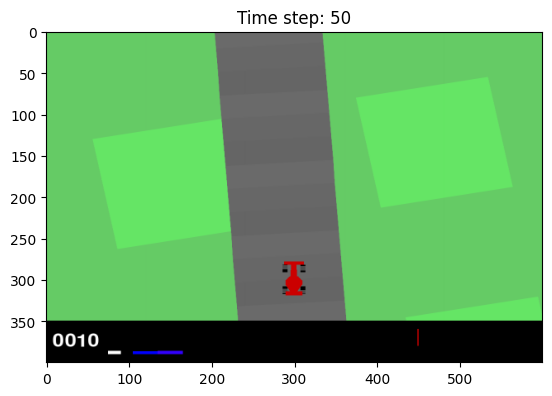

3


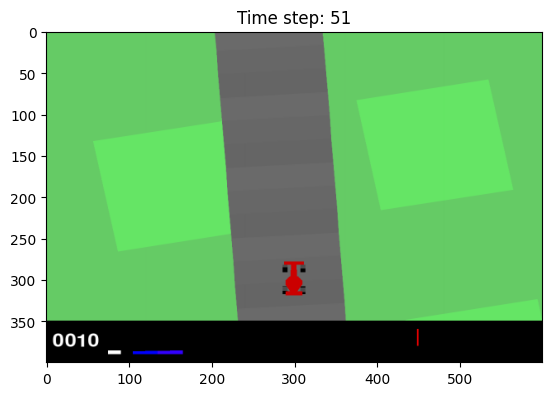

3


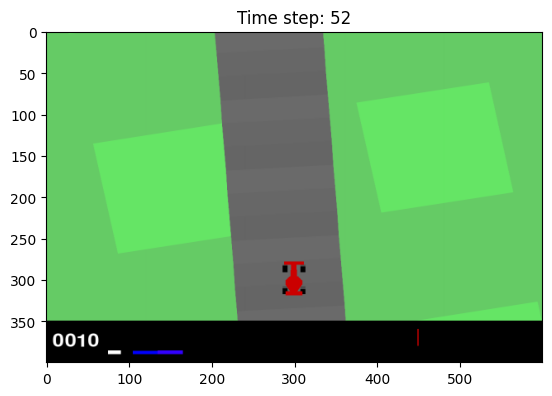

3


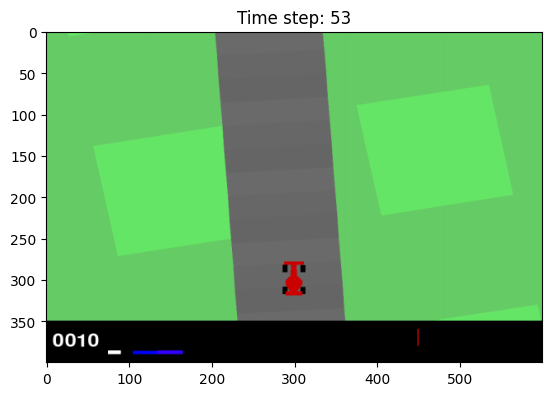

3


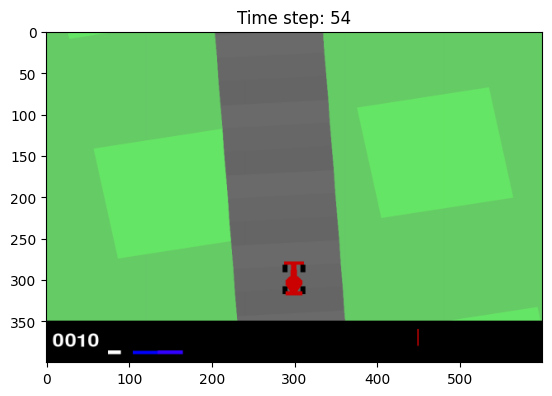

3


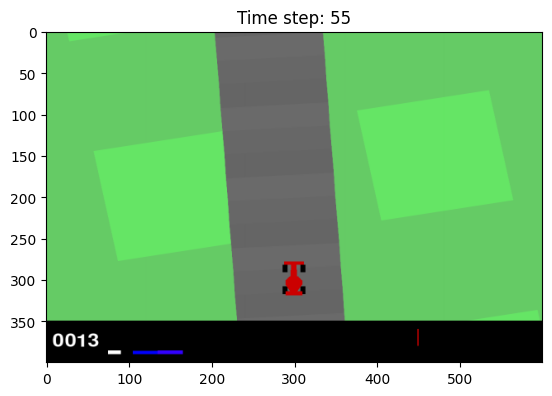

3


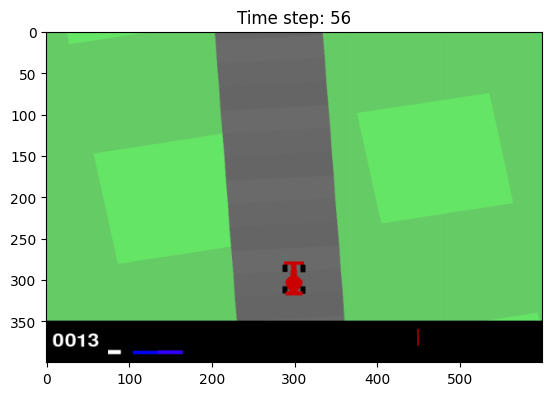

3


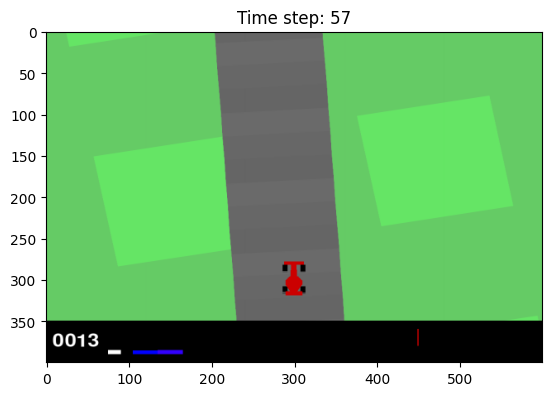

3


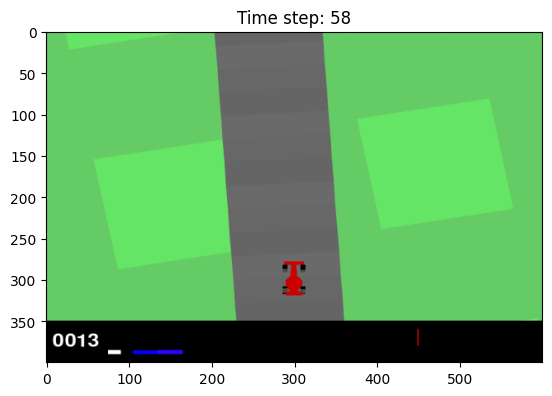

3


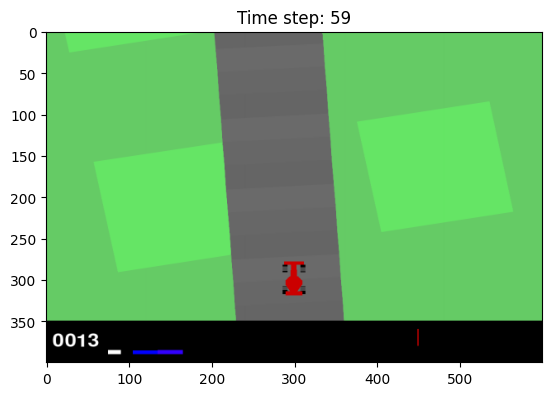

3


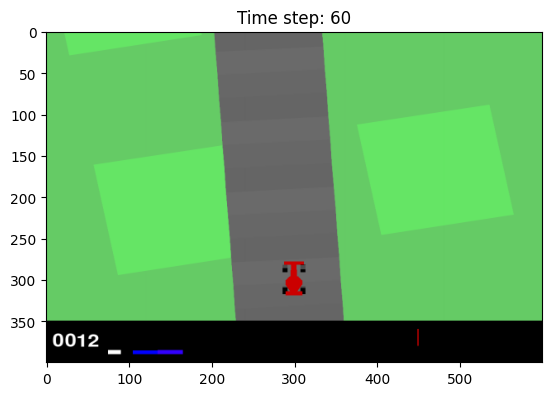

3


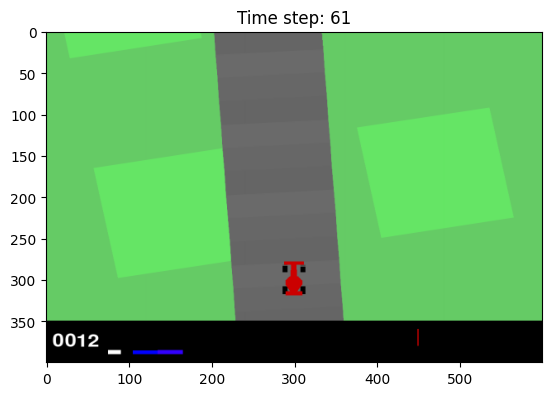

3


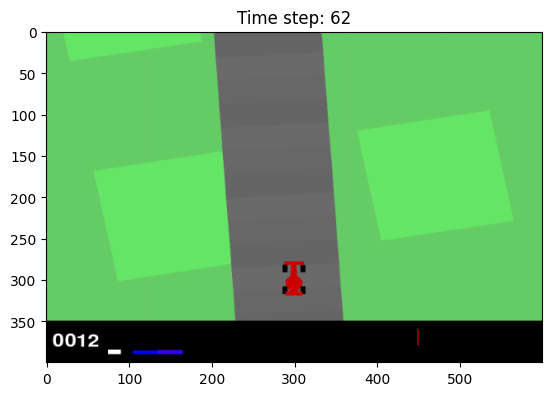

3


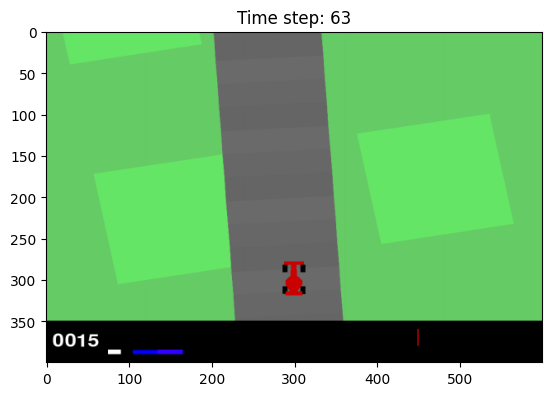

1


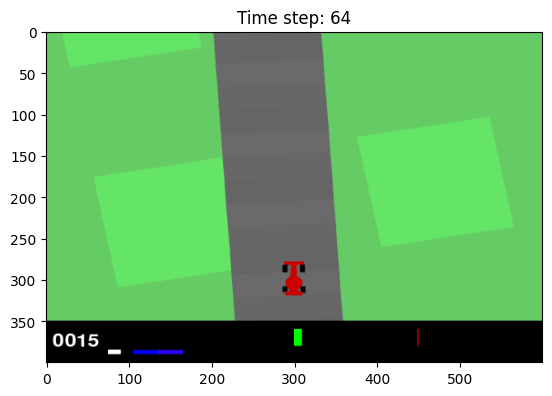

1


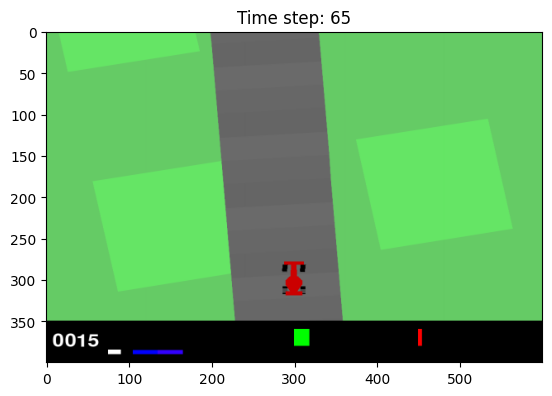

1


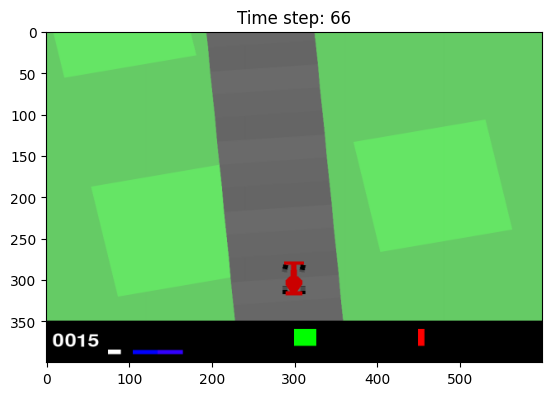

0


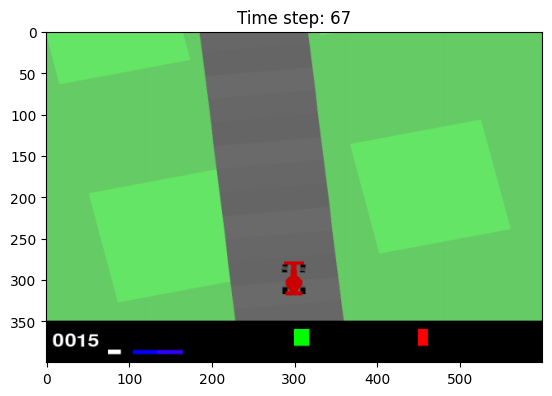

3


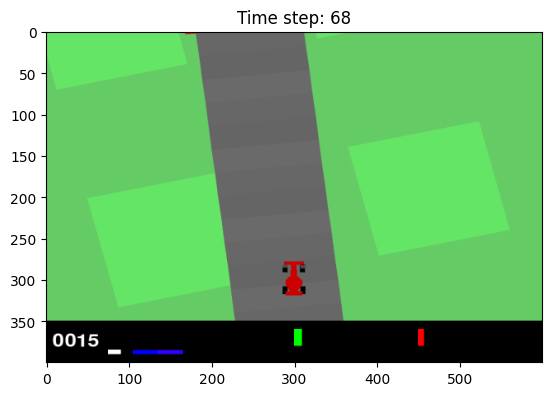

3


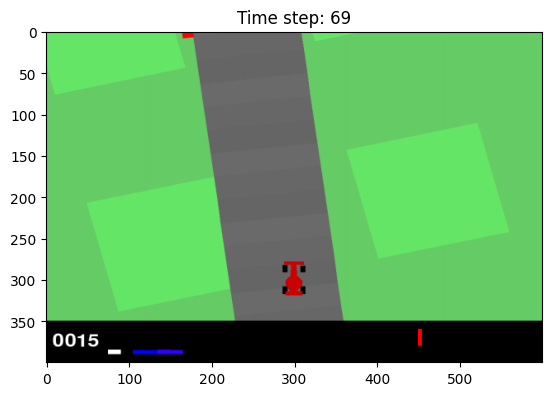

3


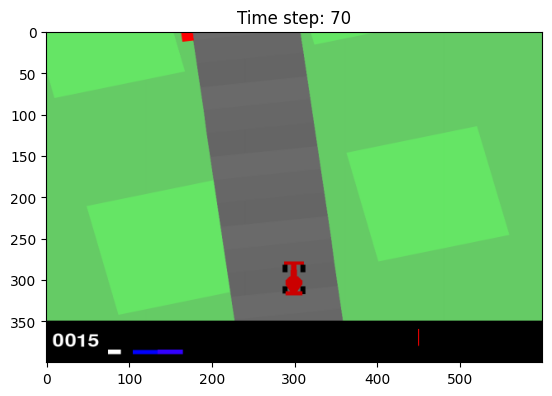

3


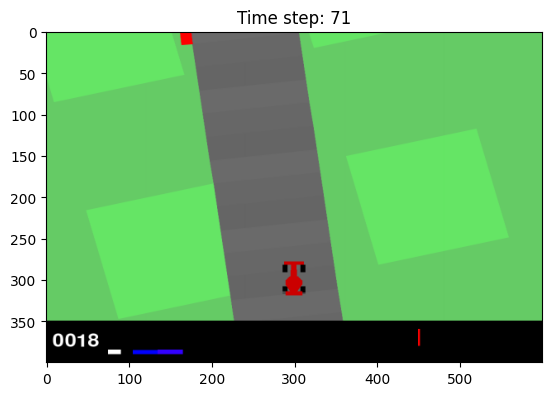

3


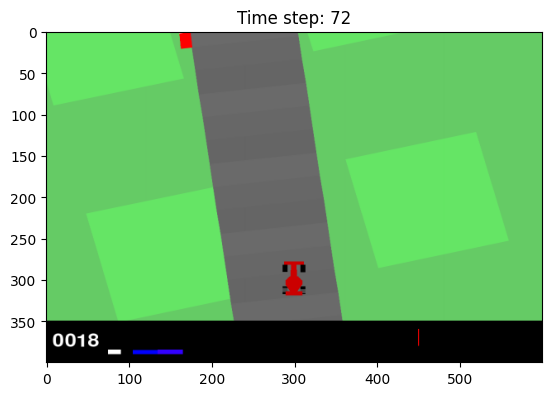

3


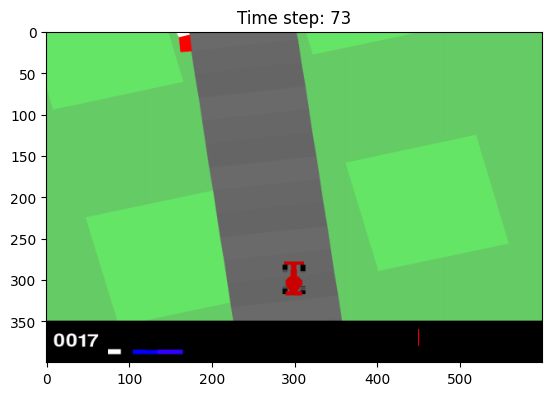

3


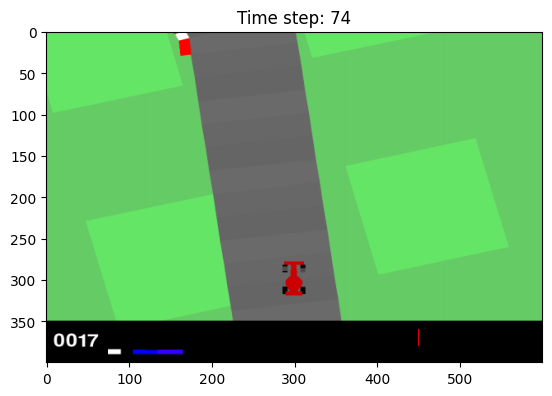

3


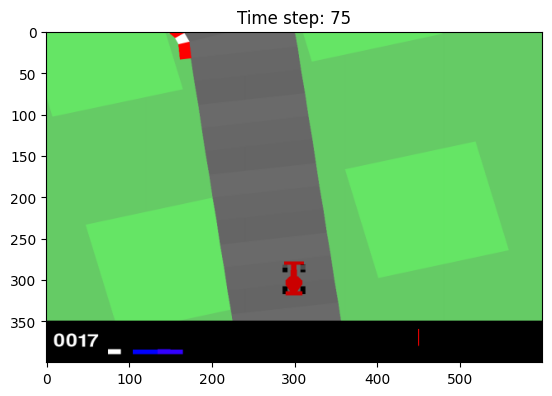

3


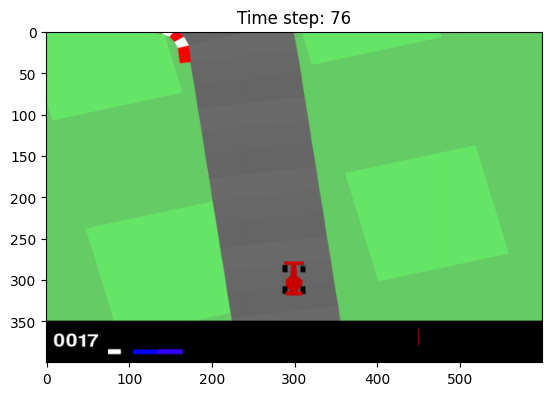

3


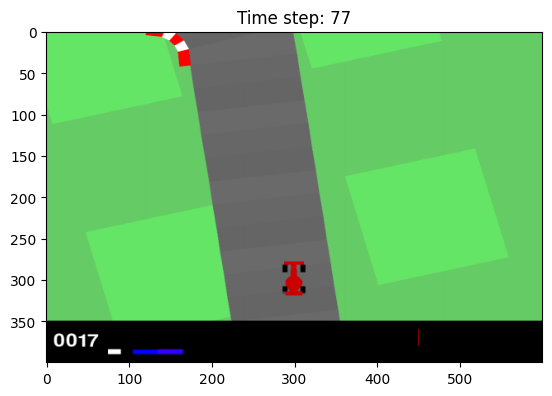

3


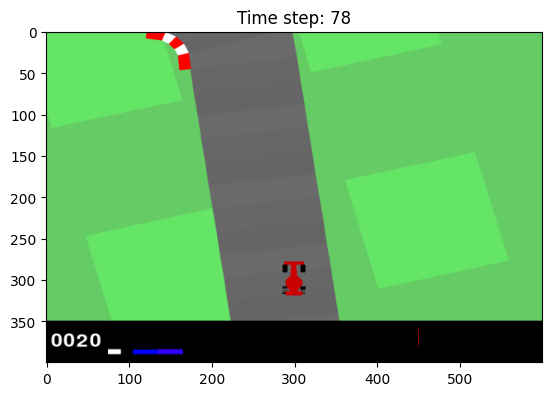

3


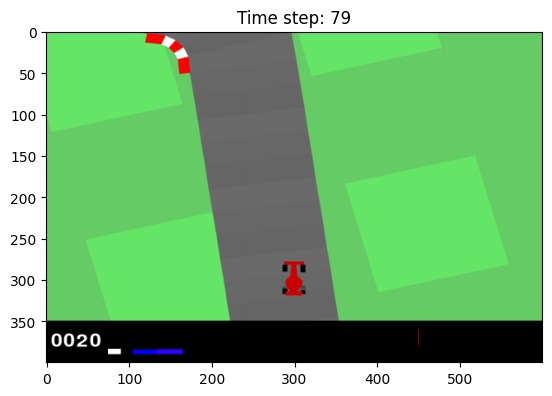

3


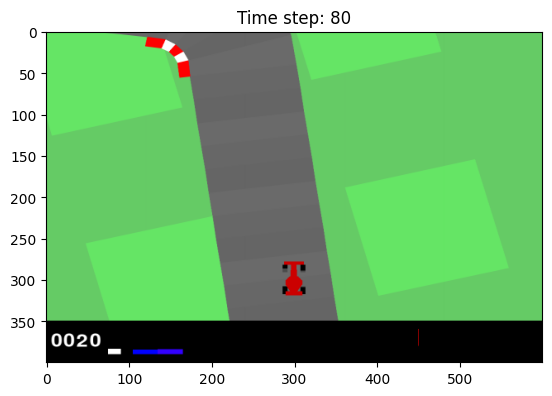

3


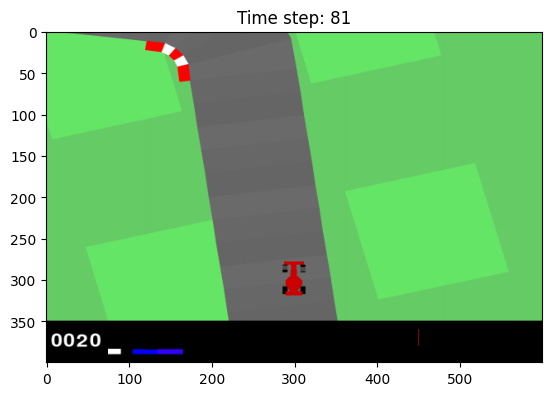

3


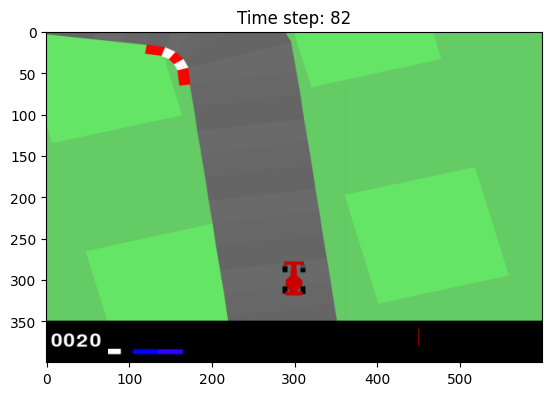

0


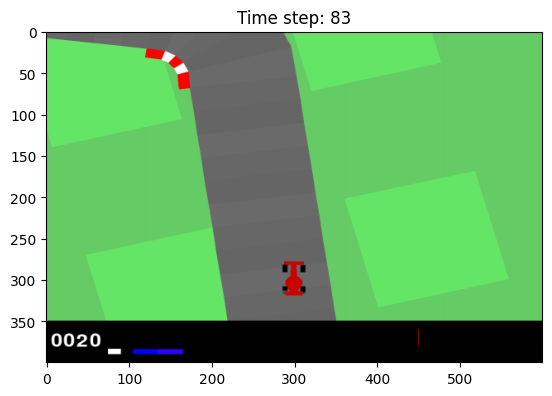

0


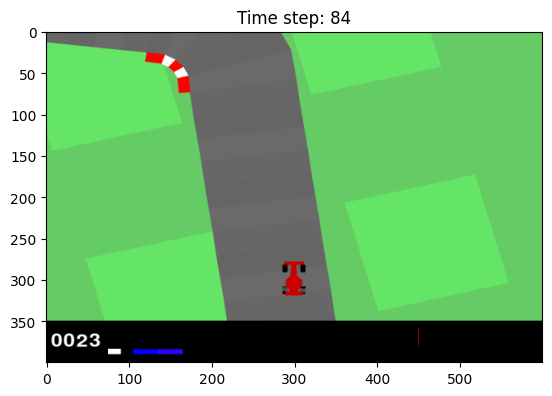

2


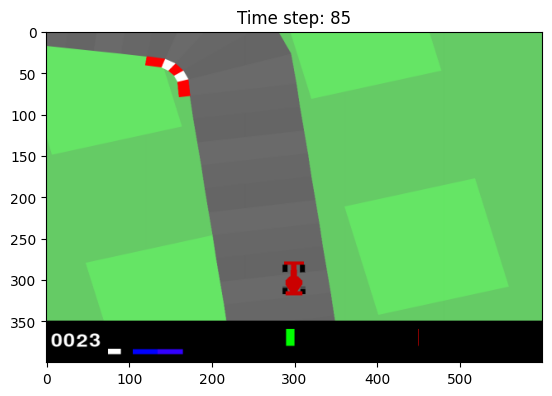

2


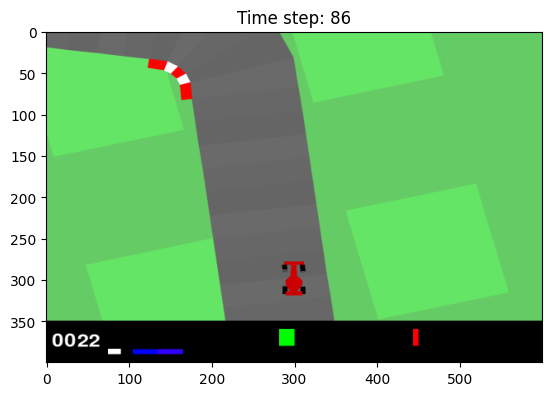

2


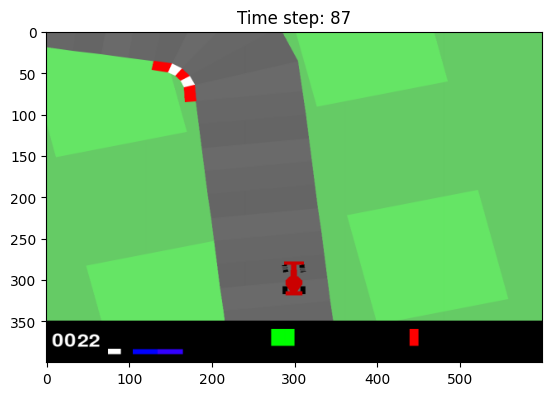

2


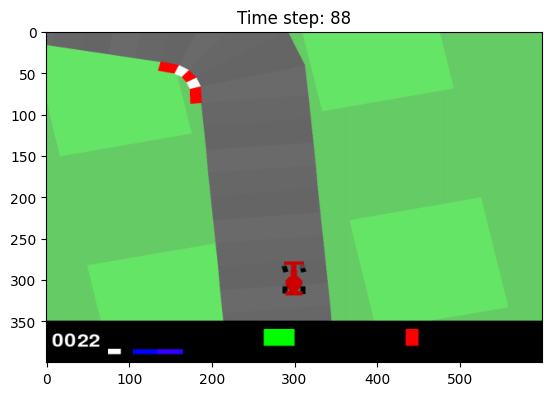

2


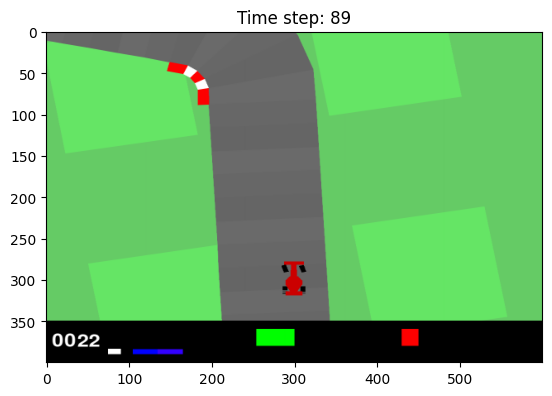

1


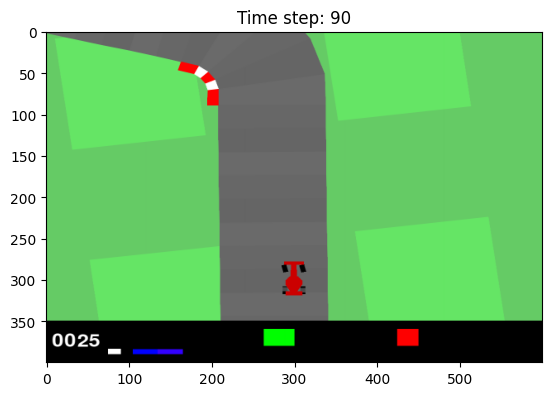

1


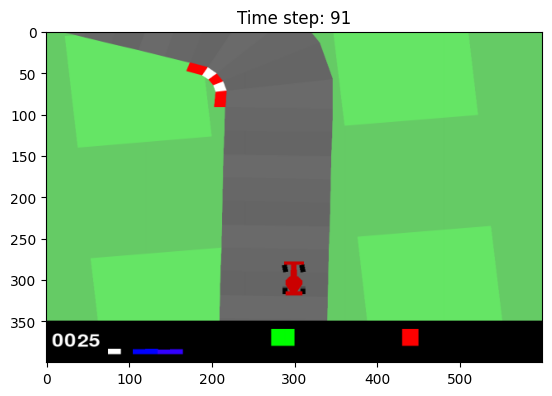

1


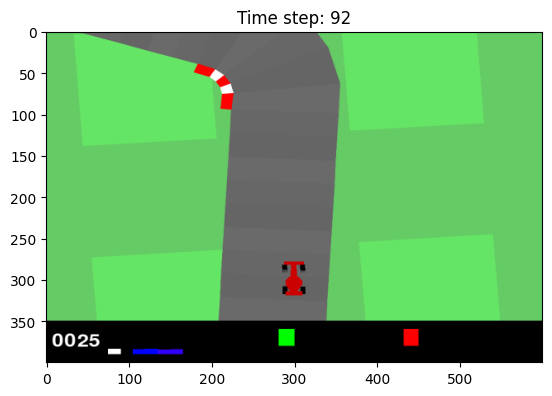

1


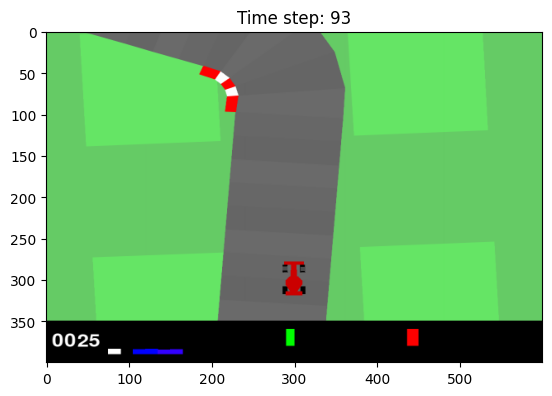

1


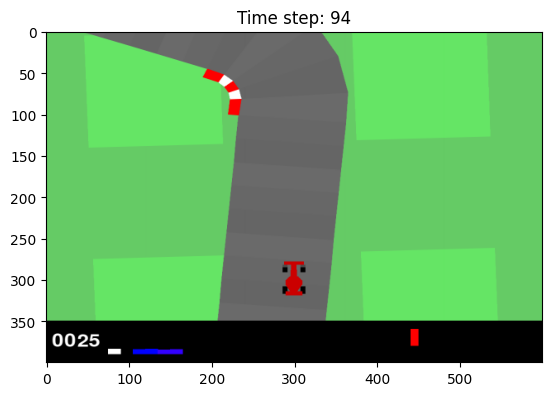

1


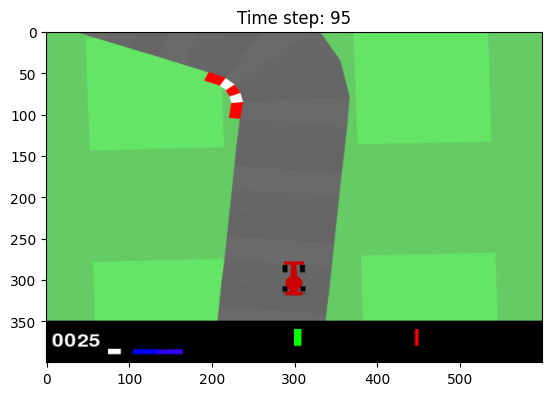

2


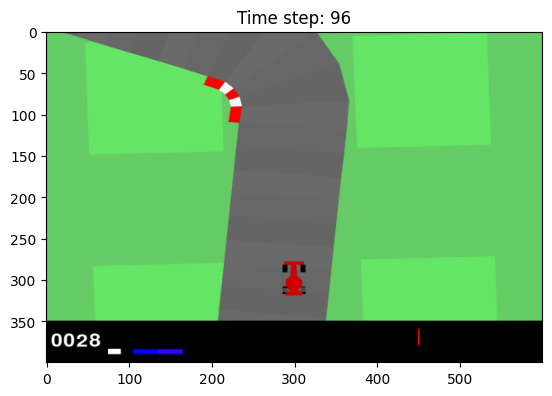

2


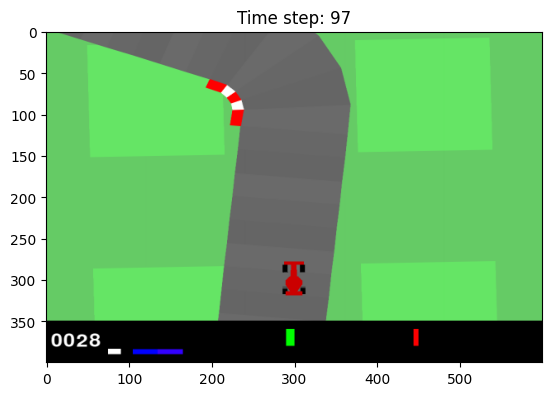

2


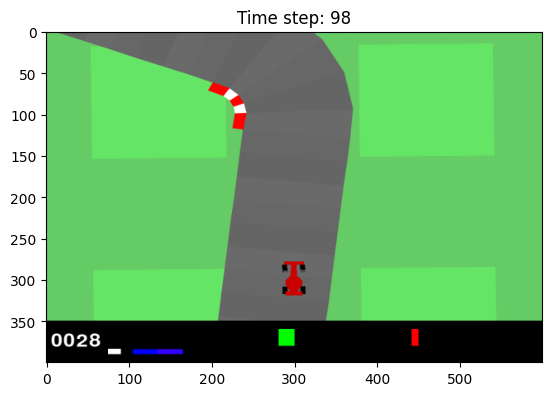

2


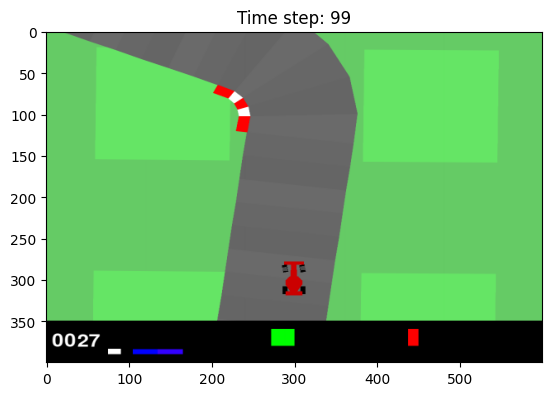

2


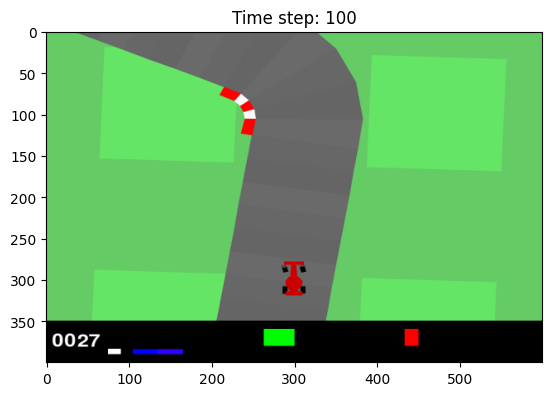

2


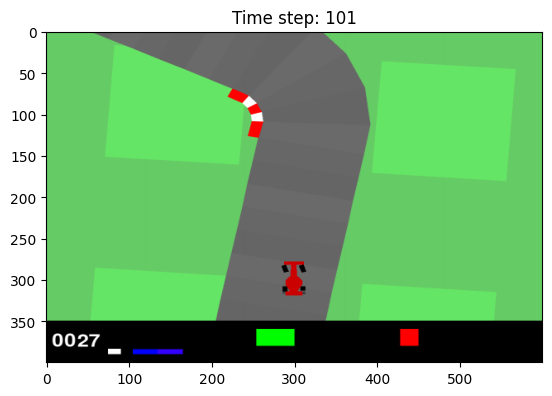

1


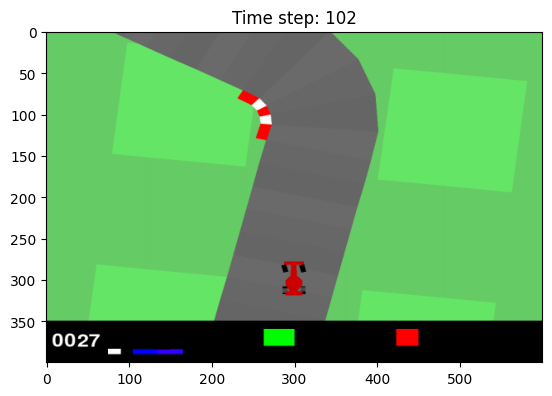

1


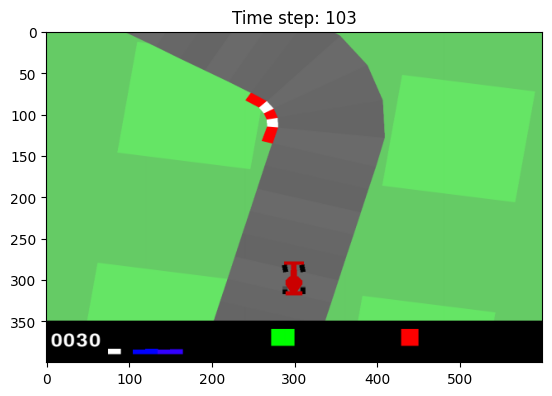

1


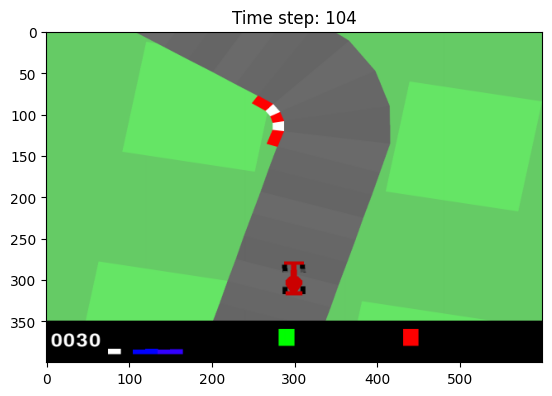

1


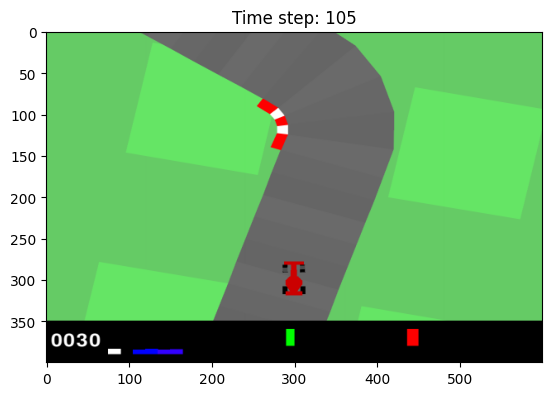

3


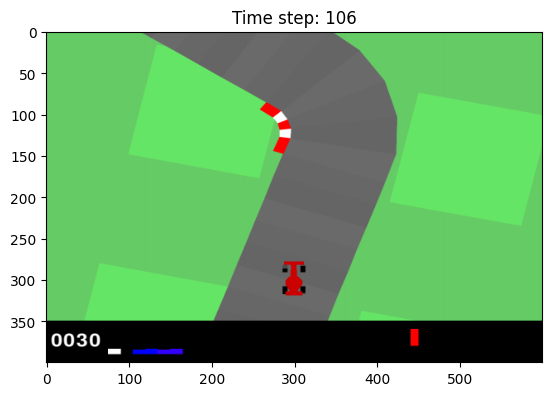

3


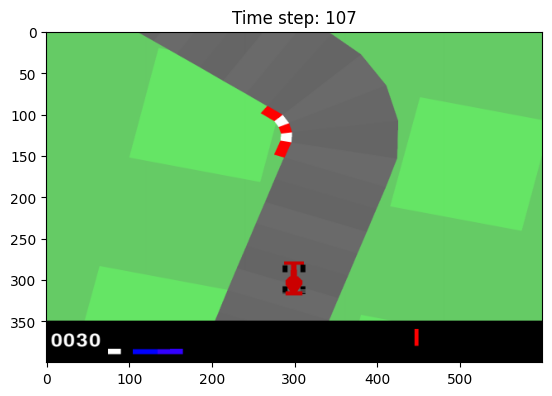

3


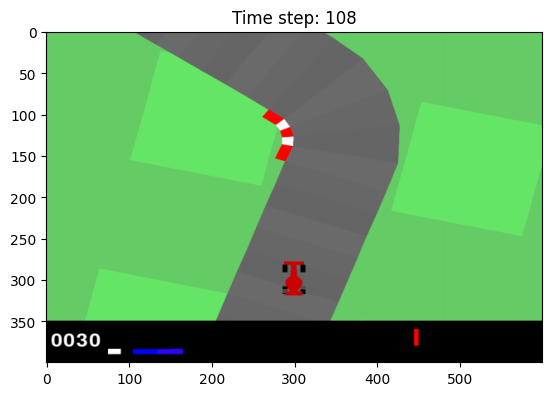

3


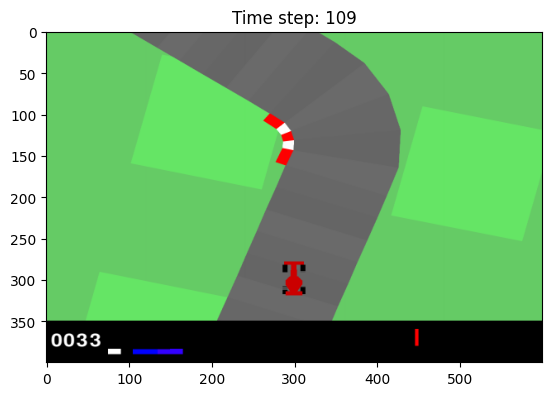

3


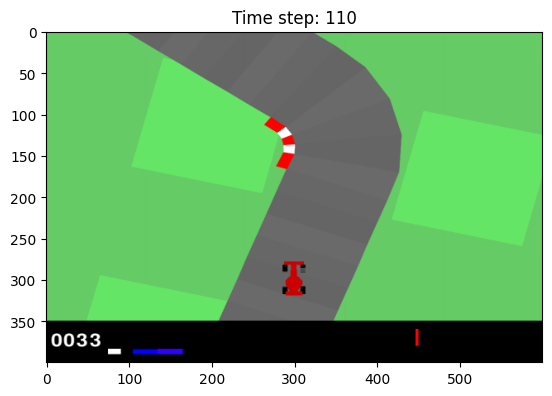

3


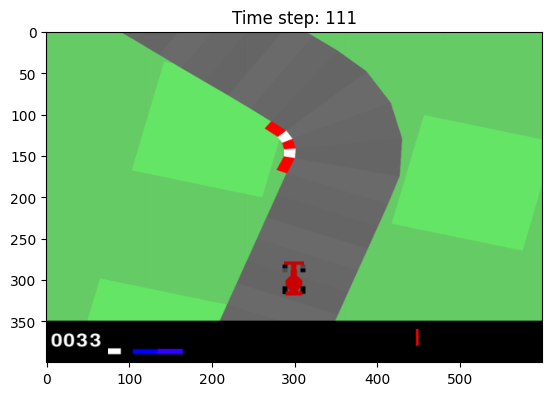

3


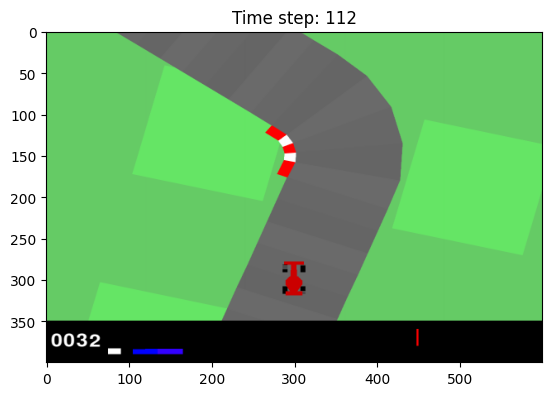

2


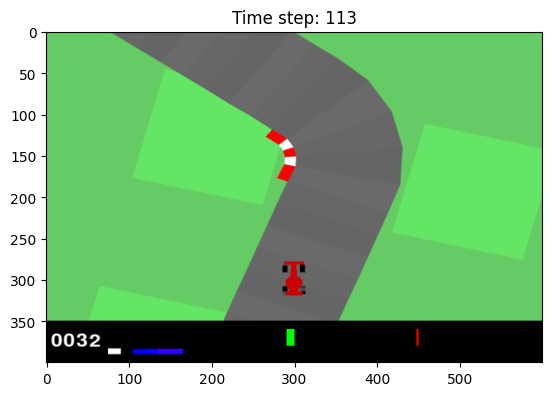

2


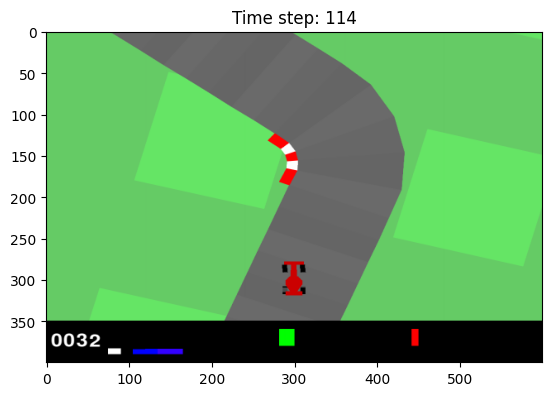

1


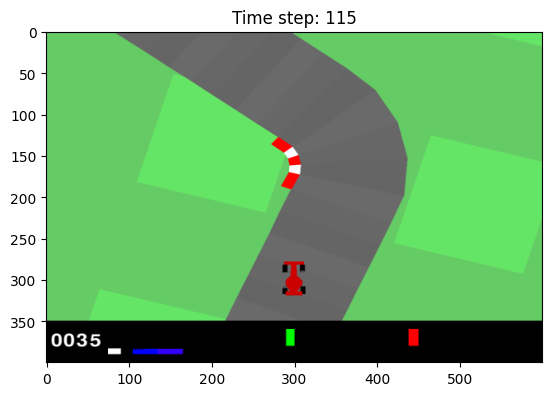

1


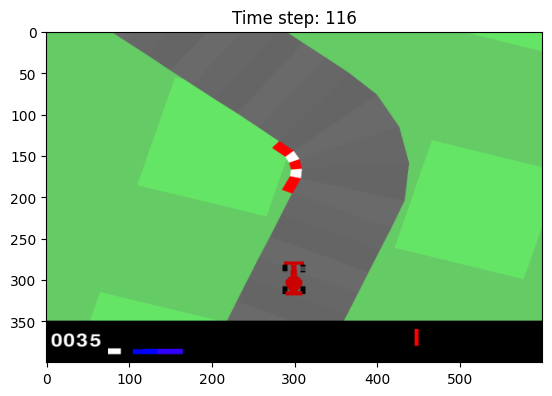

1


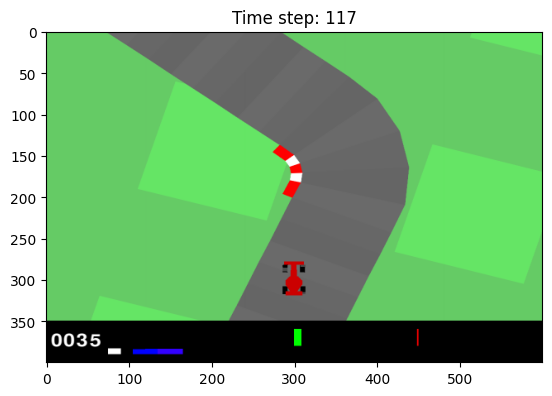

0


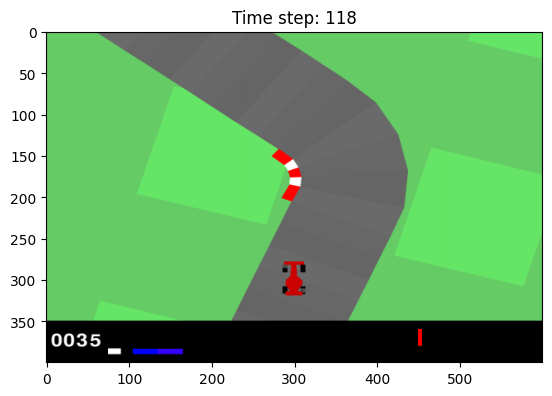

0


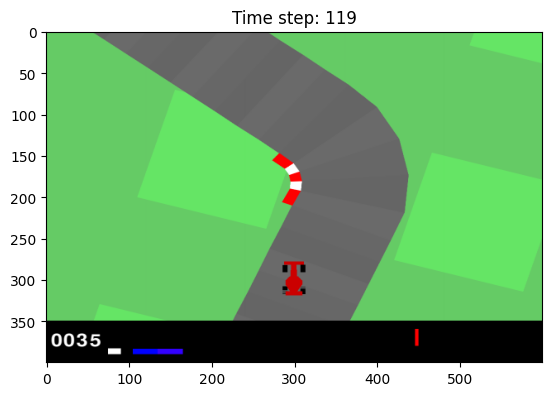

0


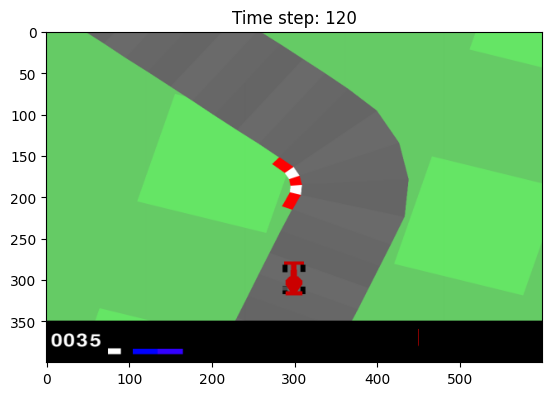

0


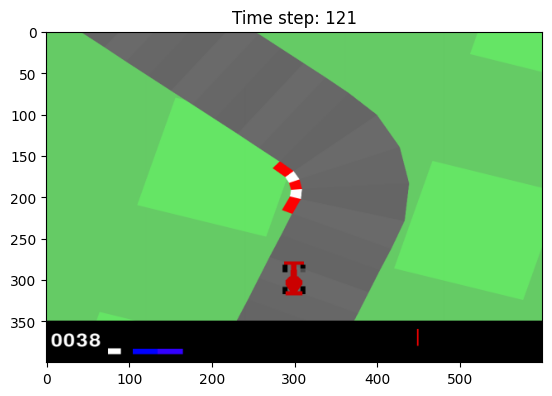

0


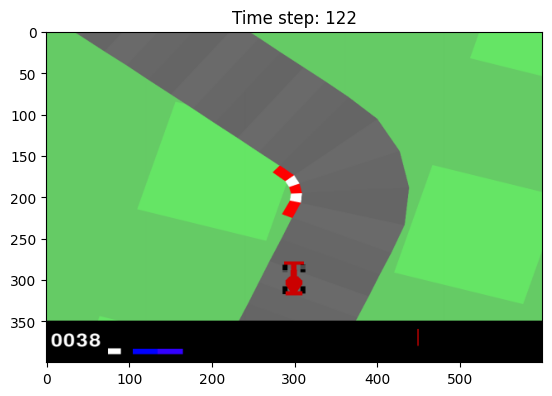

1


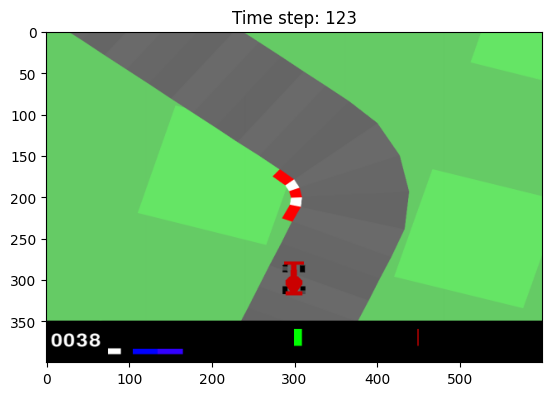

1


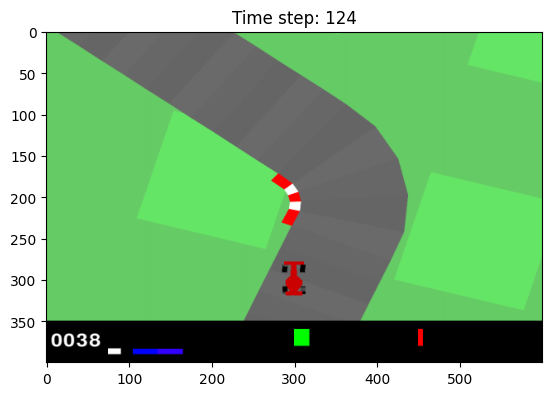

1


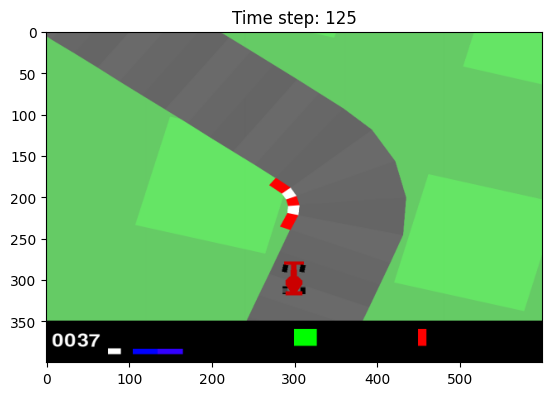

1


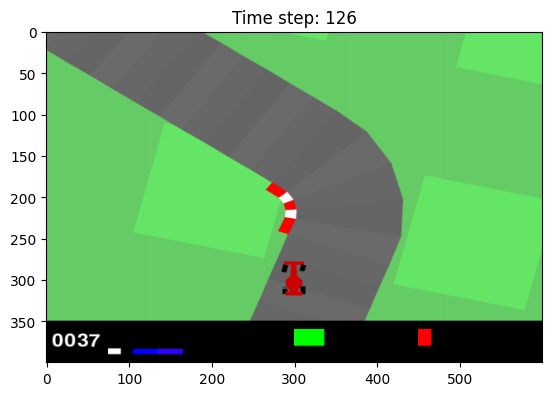

1


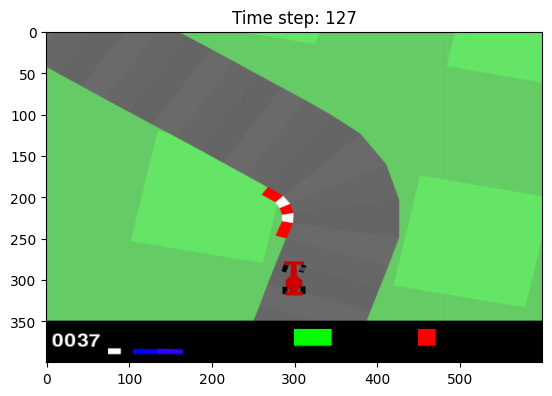

3


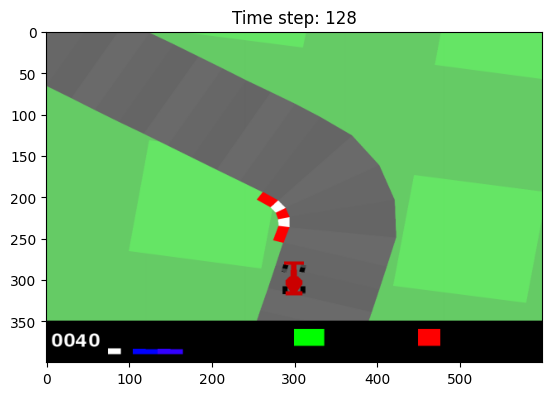

3


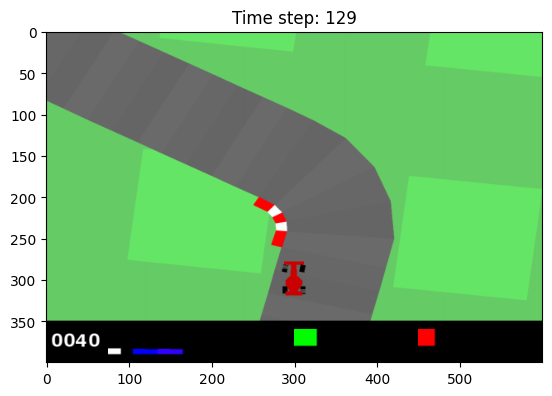

3


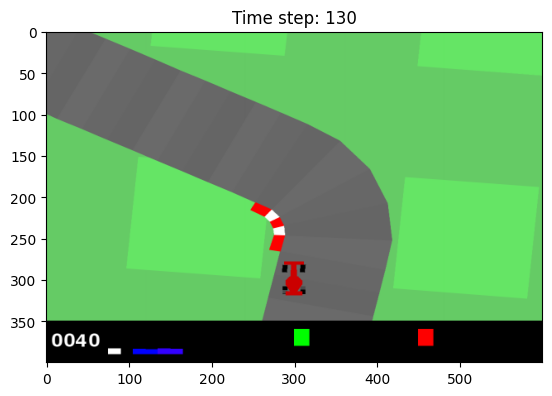

3


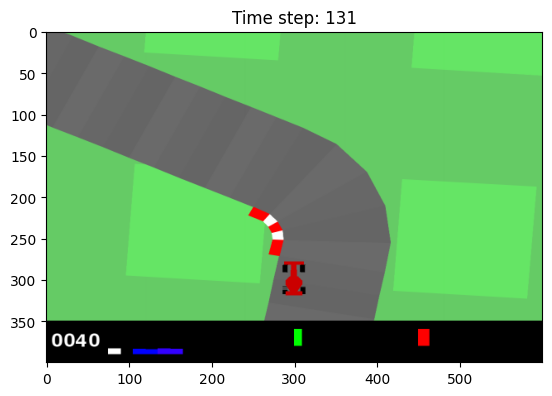

3


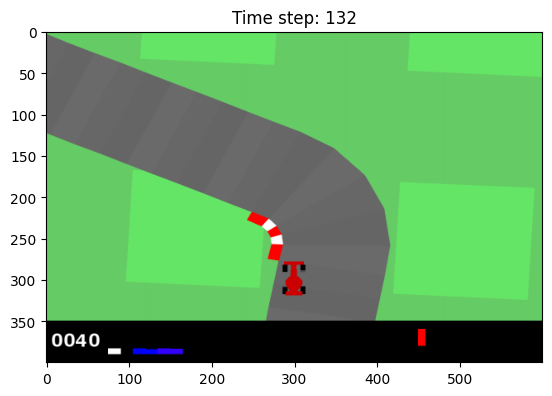

0


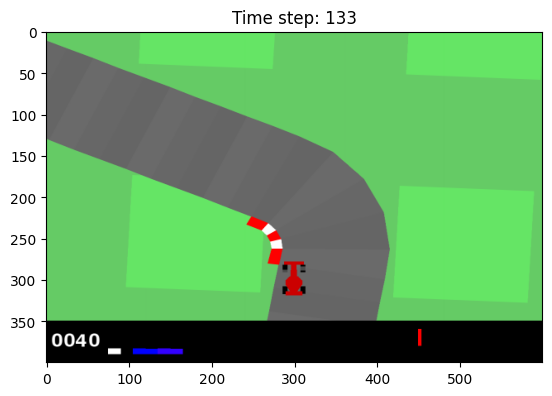

0


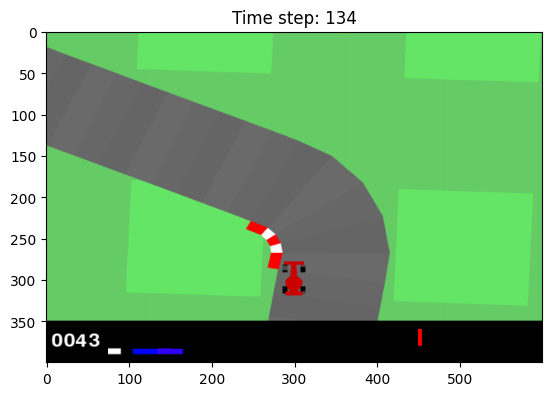

0


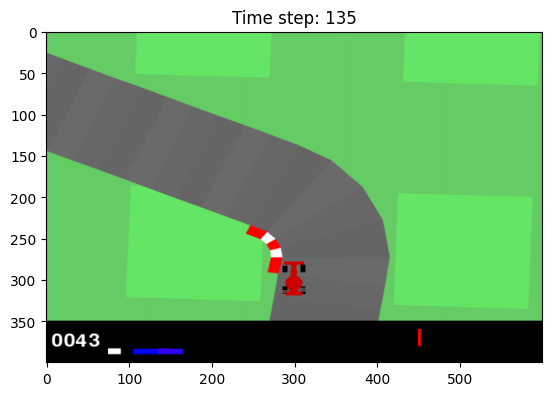

2


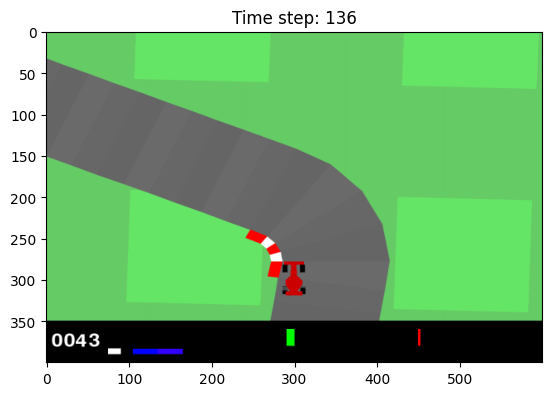

2


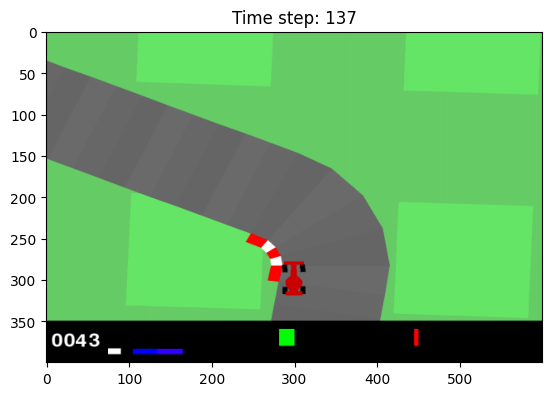

2


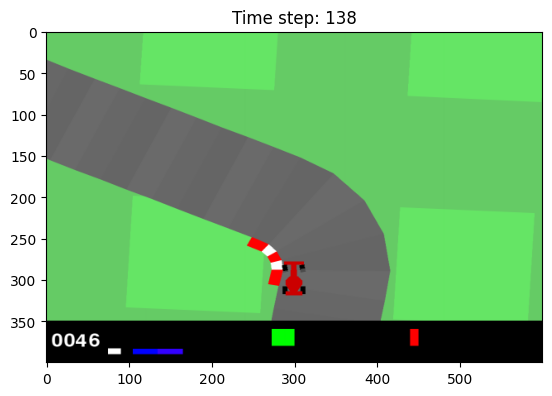

2


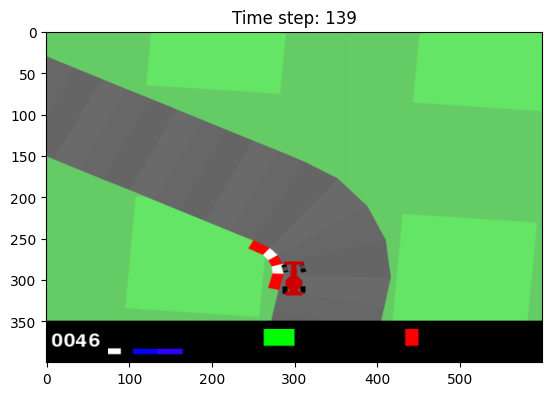

2


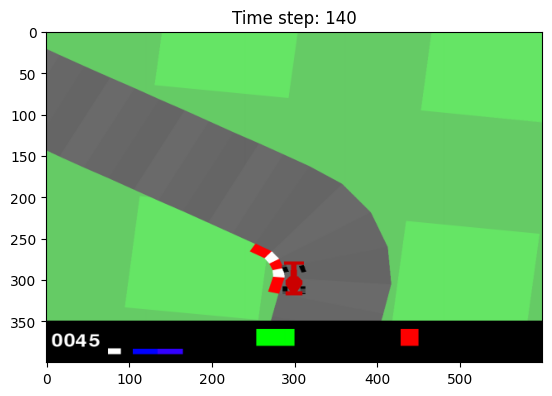

2


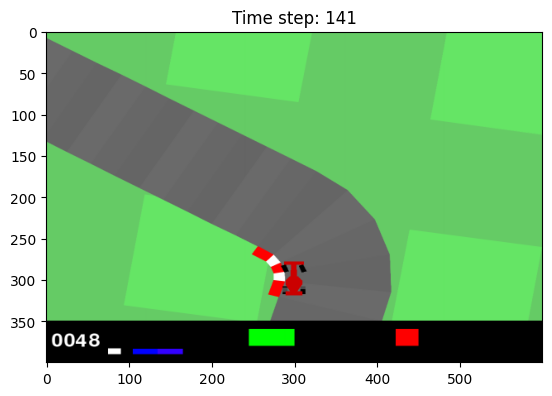

2


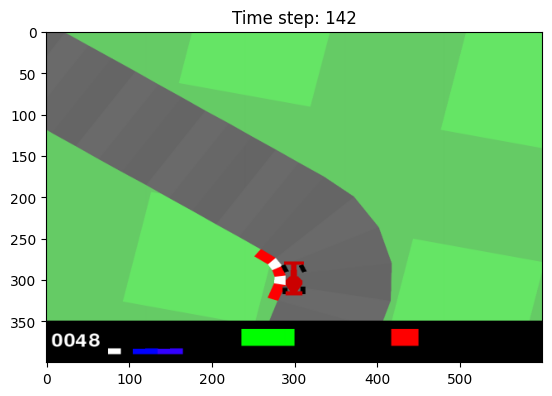

2


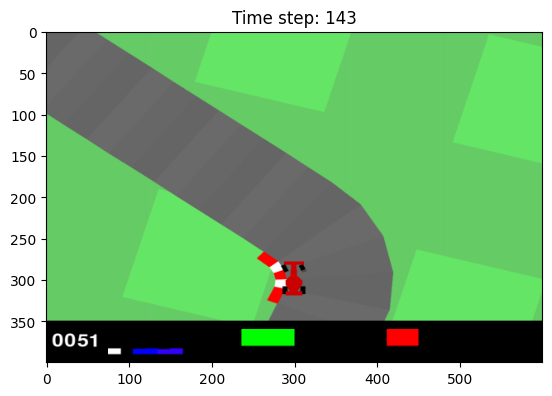

0


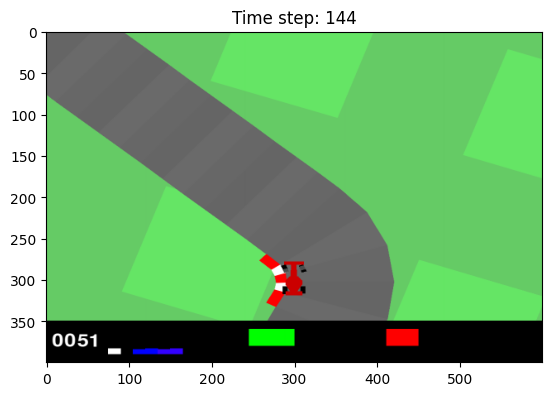

0


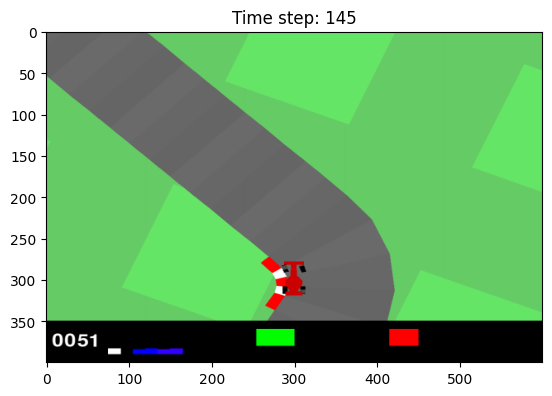

0


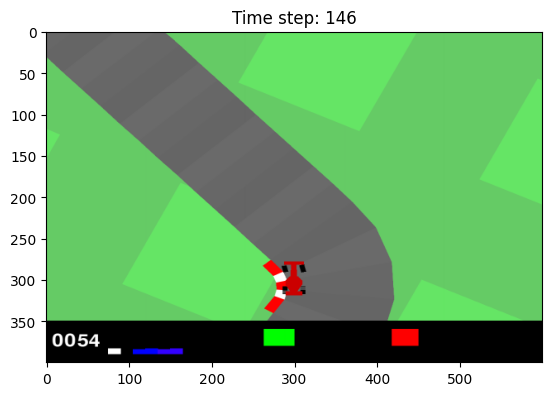

0


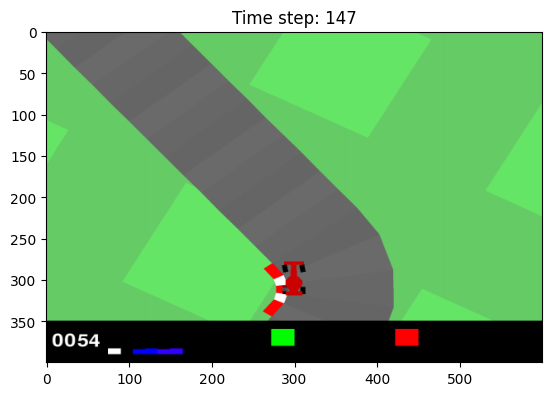

0


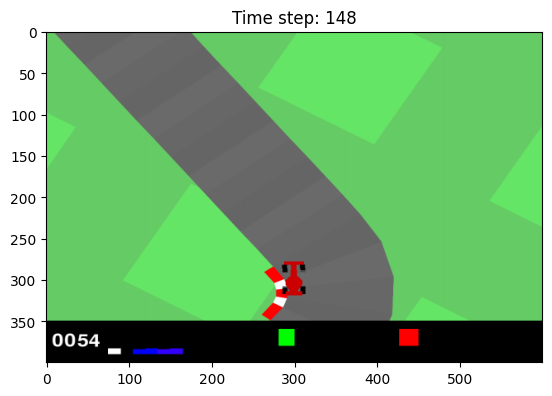

0


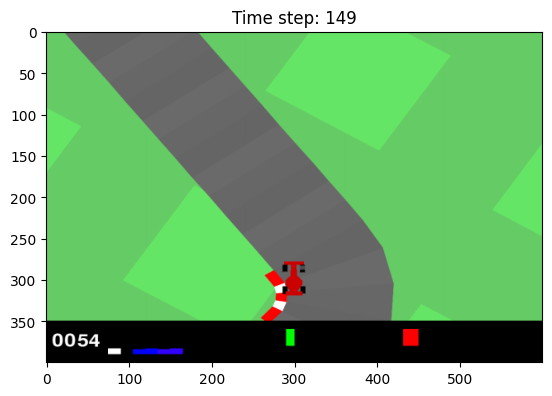

0


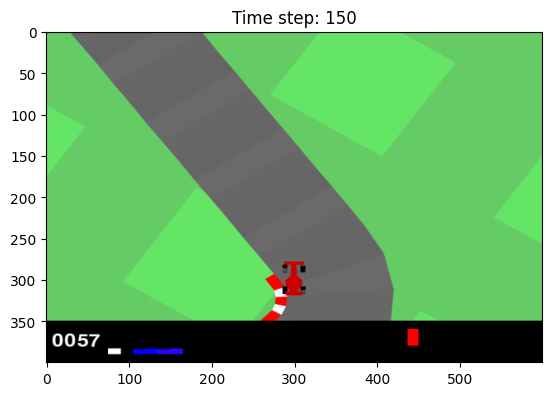

0


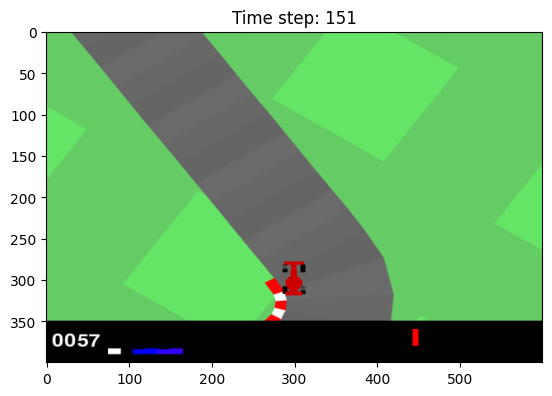

0


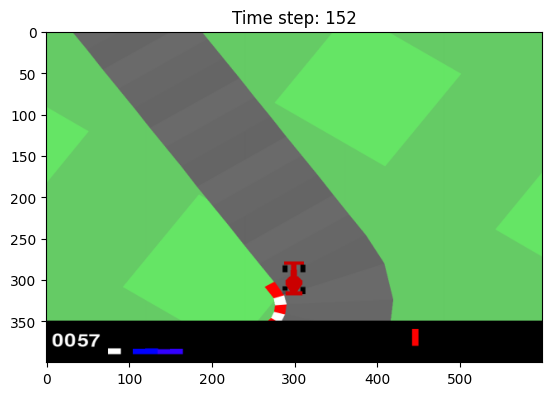

0


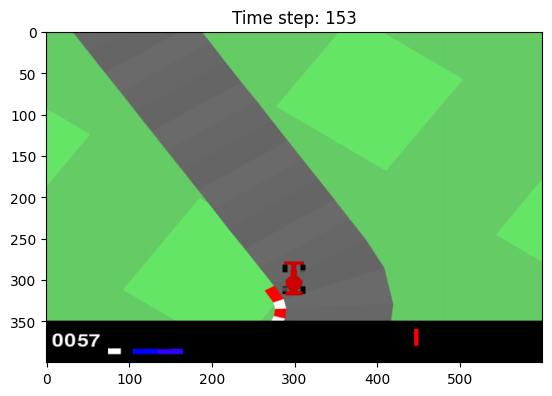

3


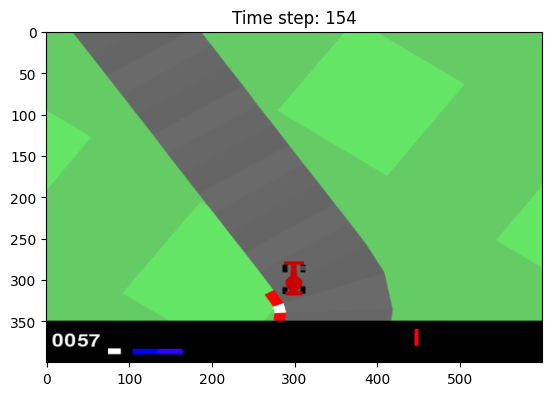

3


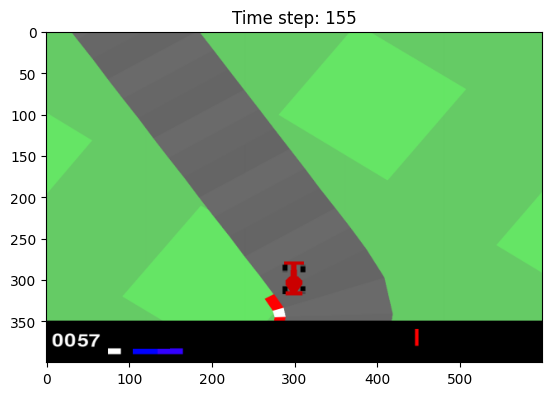

3


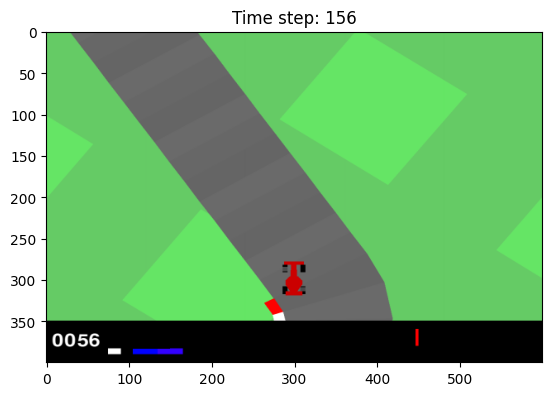

3


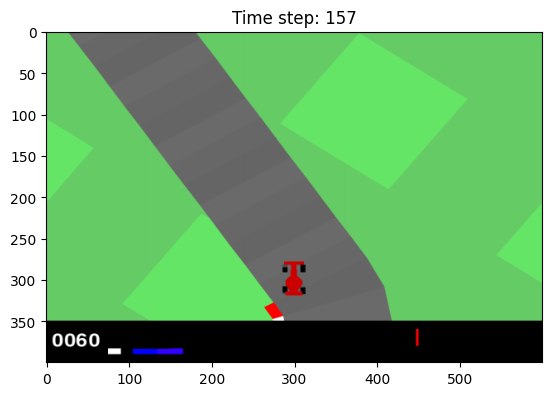

2


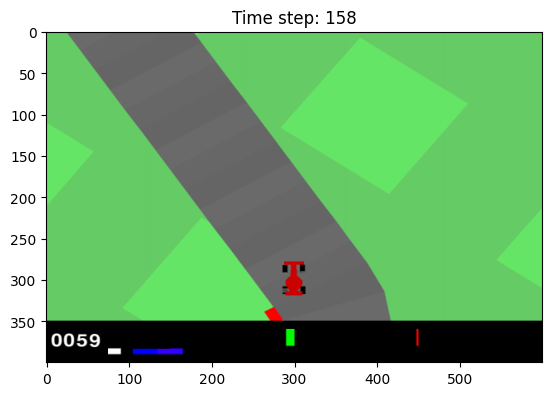

2


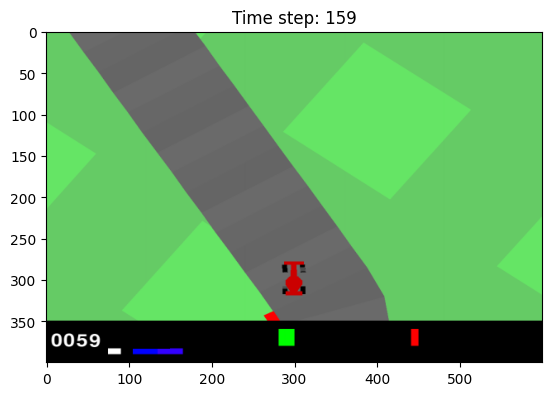

2


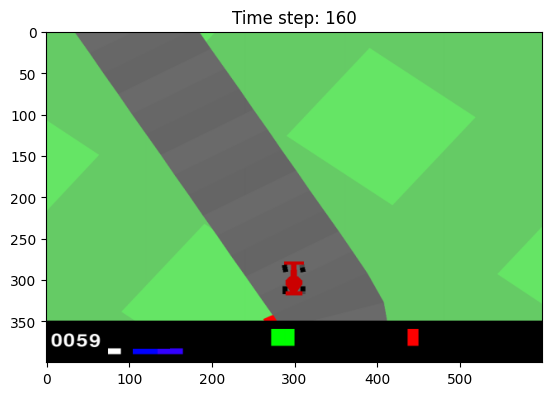

3


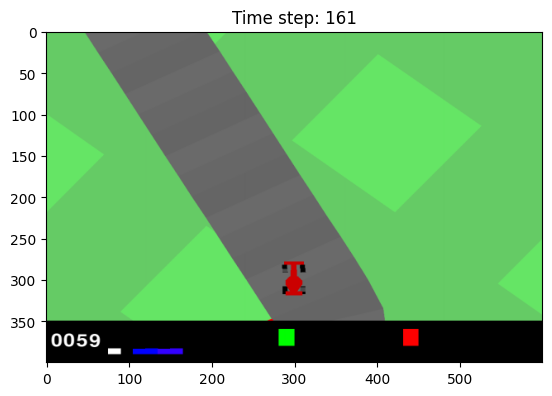

3


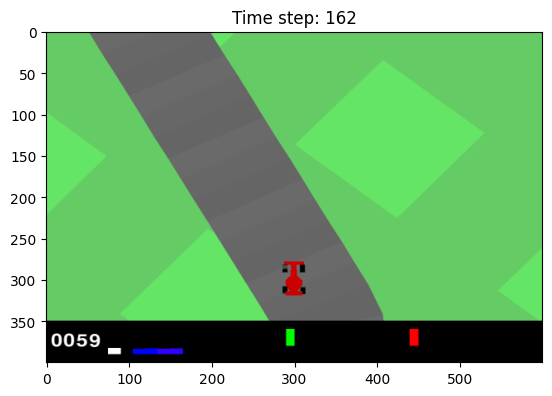

2


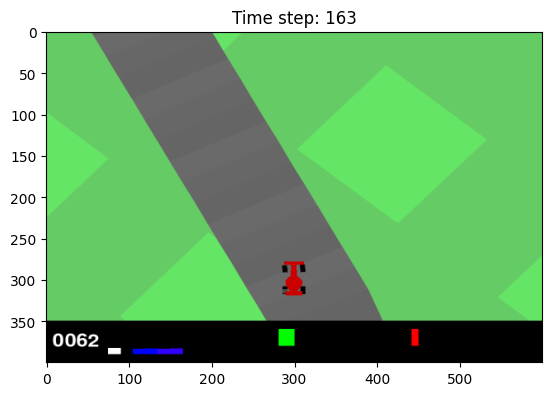

2


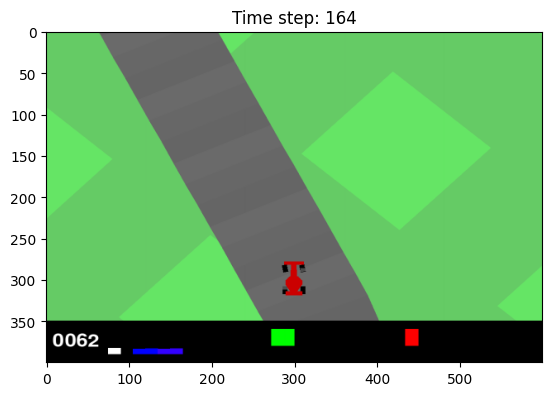

2


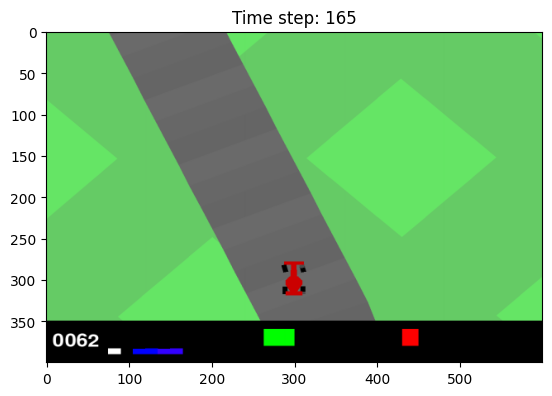

3


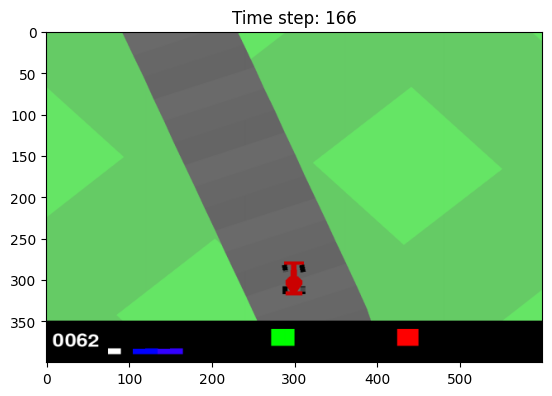

0


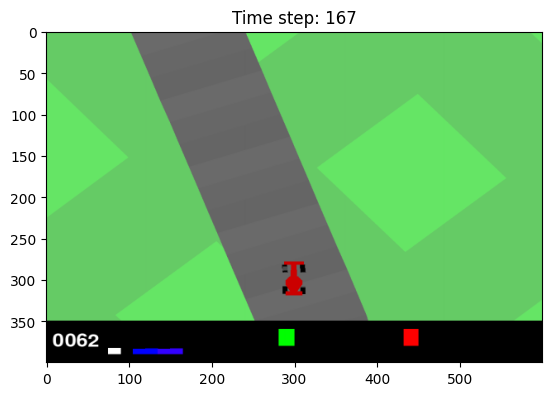

0


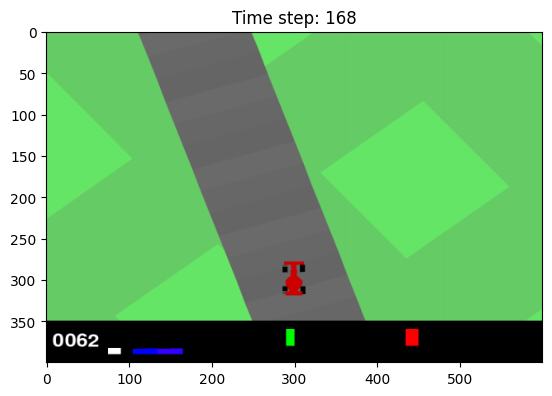

0


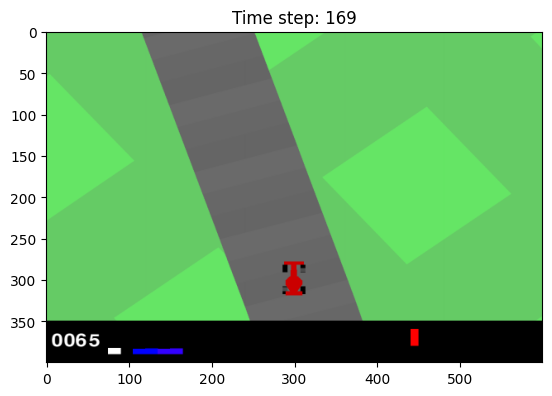

1


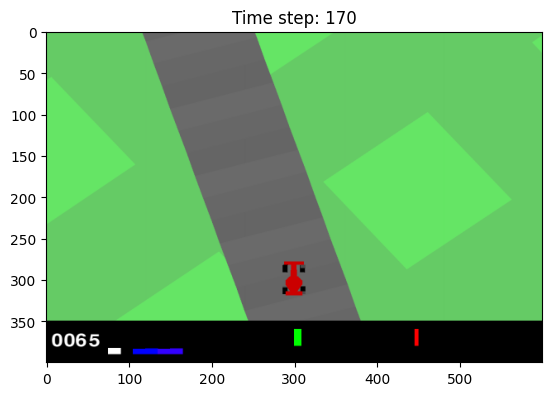

1


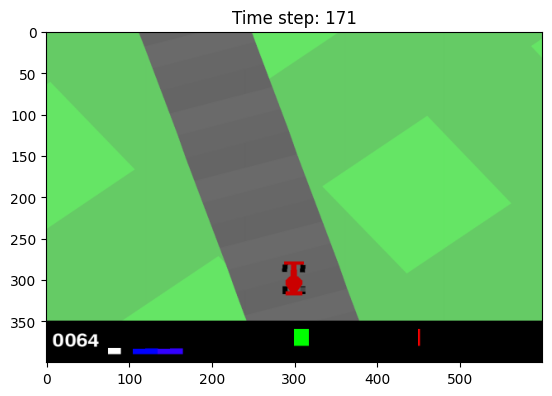

1


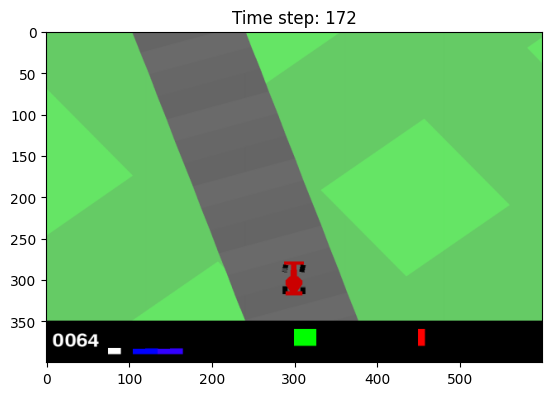

4


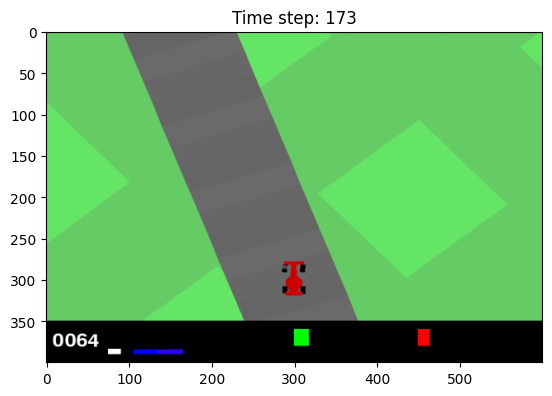

2


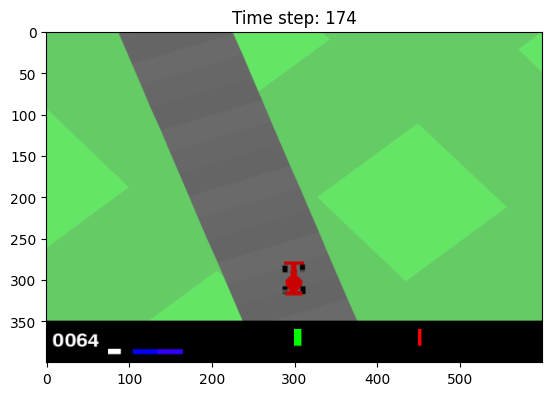

2


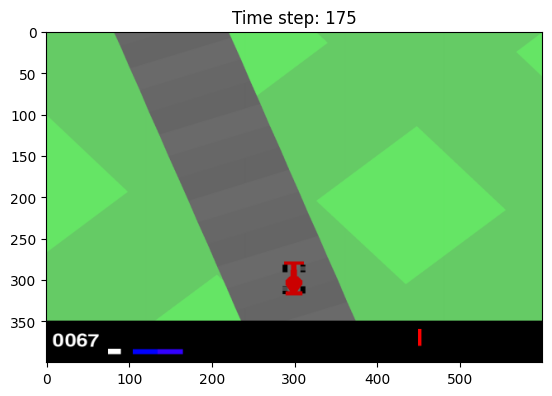

2


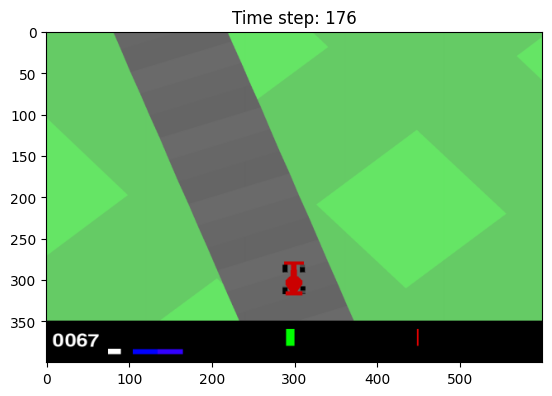

2


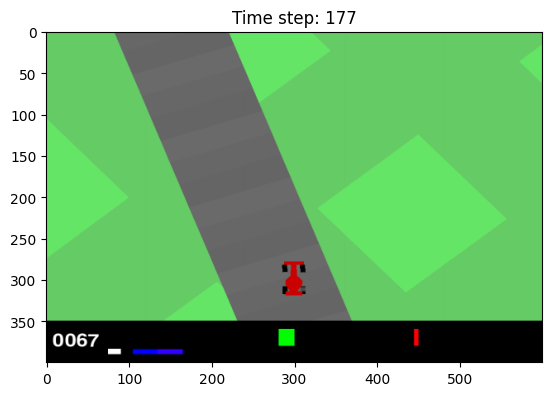

2


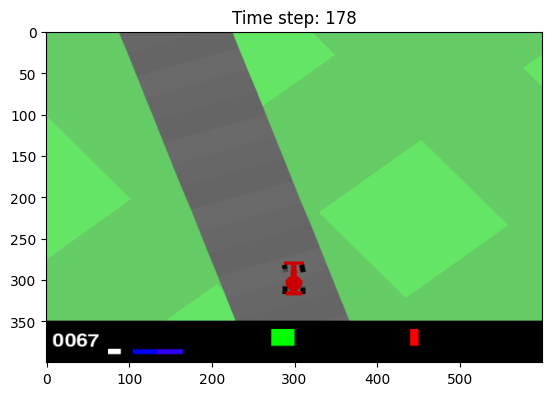

2


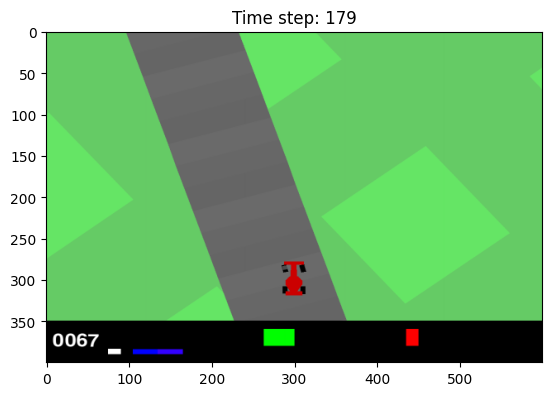

3


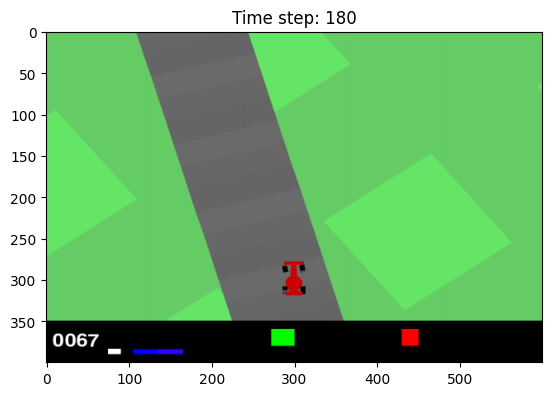

2


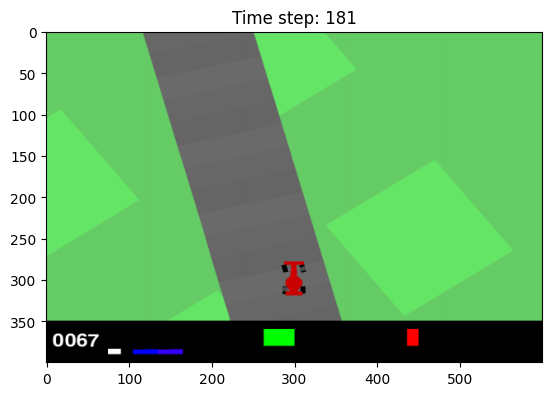

3


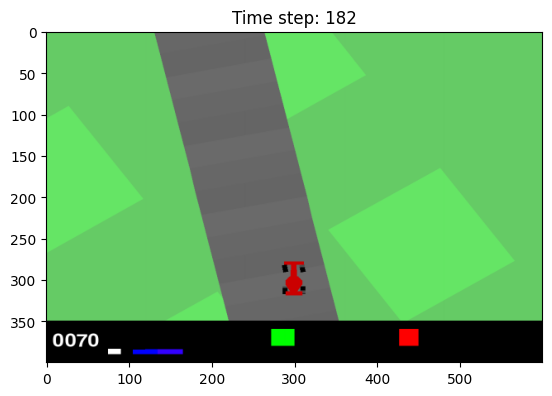

3


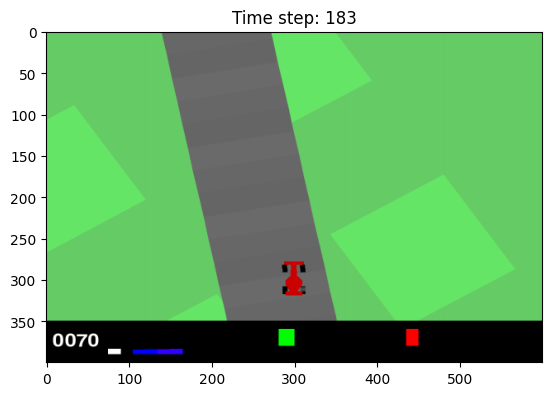

3


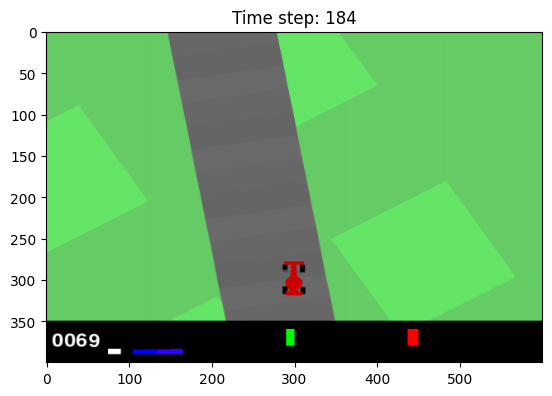

3


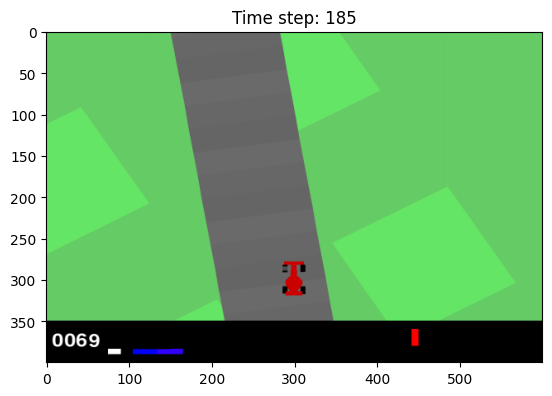

2


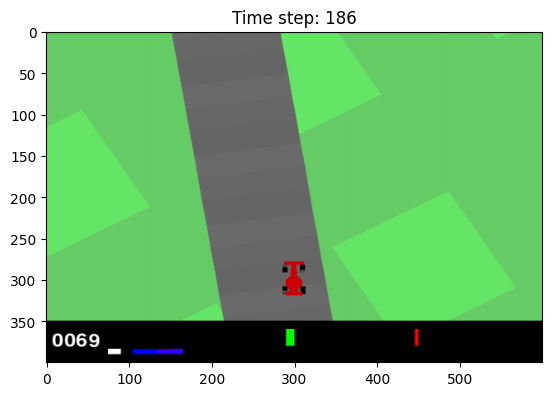

2


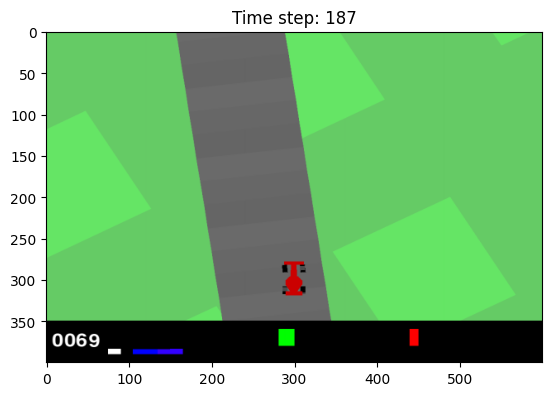

2


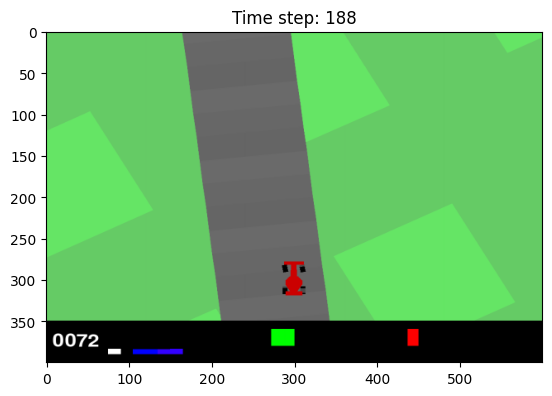

2


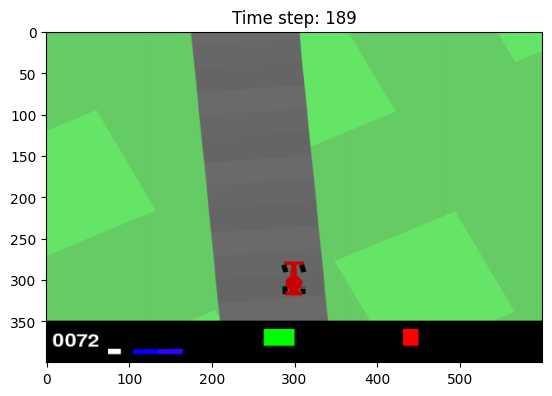

2


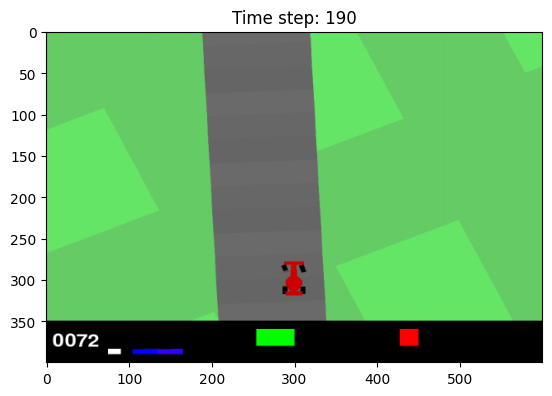

1


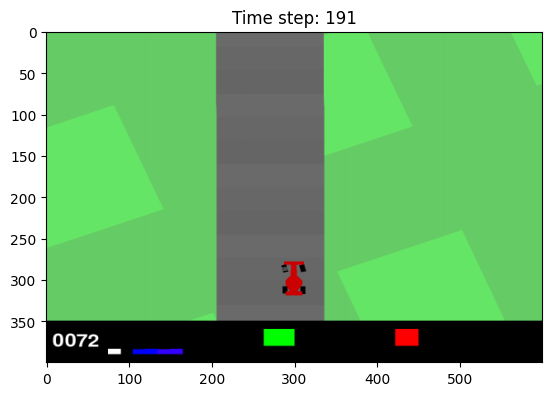

1


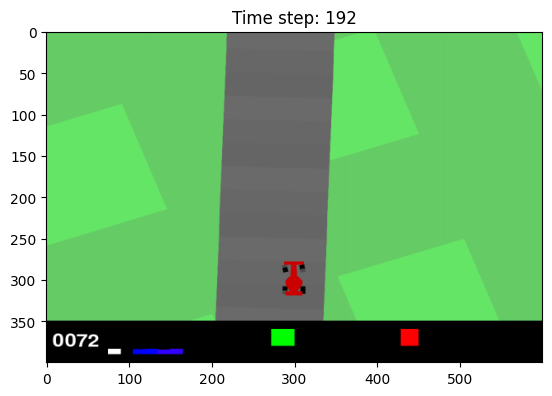

1


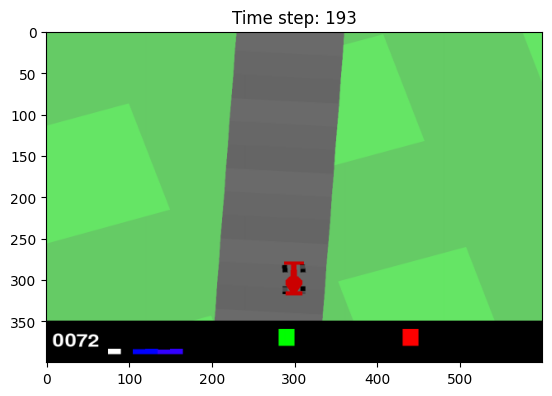

1


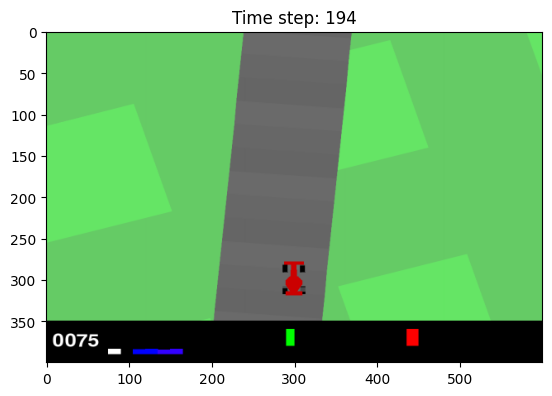

3


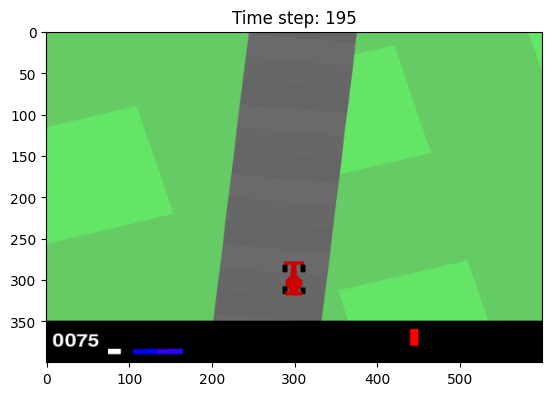

3


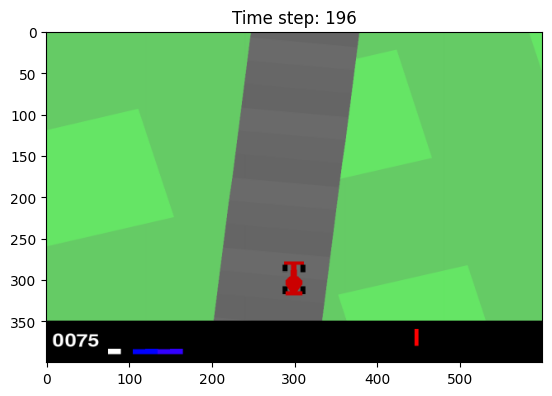

3


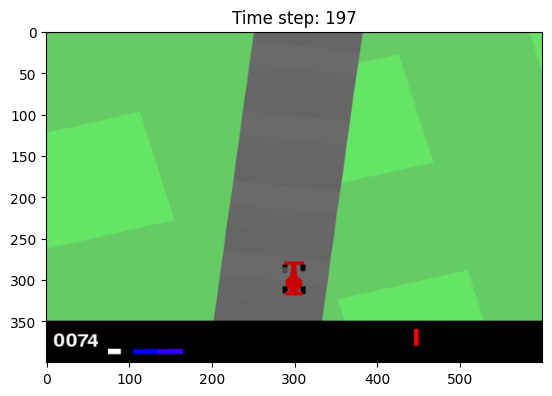

1


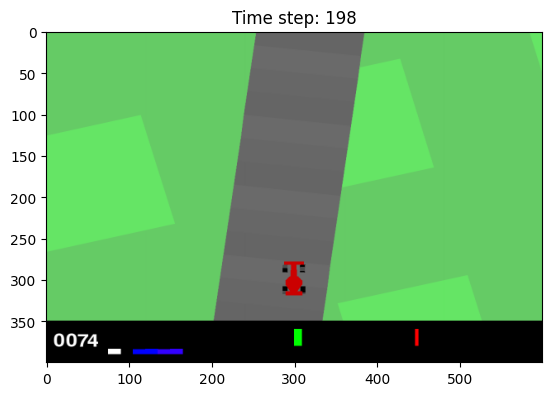

1


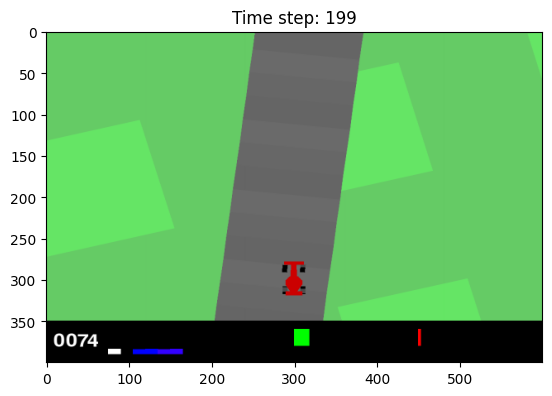

1


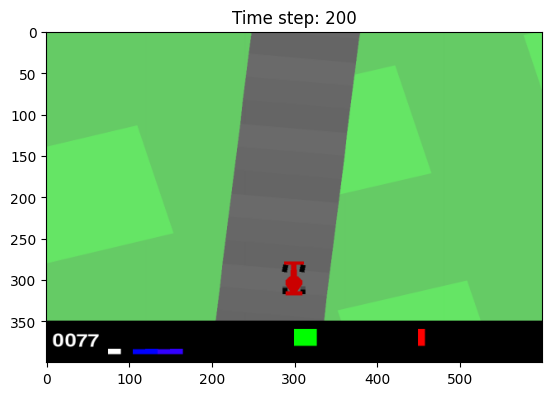

In [ ]:
# 모델의 성능 확인

env = gym.make(config["env_name"], continuous=False, render_mode="rgb_array")
obs = env.reset()
obs = toGray(obs)
frame_stack_deque = deque([obs]*3, maxlen=3)
state = toState(frame_stack_deque)

plt.imshow(env.render()[0])
plt.title("Time step: 0")
plt.show()
for t in range(1, 201):
    action = getAction(state, dAction, config["epsilon_min"], Q)
    print(action)
    nextObs, reward, done, _info = env.step(action)
    nextObs = toGray(nextObs)
    frame_stack_deque.append(nextObs)
    nextState = toState(frame_stack_deque)
    plt.imshow(env.render()[0])
    plt.title(f'Time step: {t}')
    plt.show()
    state = nextState
    if done:
        break